In [1]:
cd /home/disk2/wdd/PDZ/MSM/charm36m

/home/disk2/wdd/PDZ/MSM/charm36m


In [2]:
from msmbuilder.dataset import dataset
from msmbuilder.cluster import KCenters
from msmbuilder.cluster import MiniBatchKMeans
from msmbuilder.cluster import MiniBatchKMedoids
from msmbuilder.msm import MarkovStateModel
from msmbuilder.lumping import PCCAPlus
from msmbuilder.lumping import PCCA
from msmbuilder.msm import implied_timescales
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
import numpy as np
font_path = '/home/disk2/wdd/msm/calibribold.ttf'
font_prop = font_manager.FontProperties(fname=font_path, size=20)

/software/anaconda2/envs/msmb/lib/python2.7/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)
/software/anaconda2/envs/msmb/lib/python2.7/site-packages/sklearn/grid_search.py:43: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. This module will be removed in 0.20.
  DeprecationWarning)


In [3]:
xyz = dataset("./*.xtc",topology='crystal.pdb',stride=1)

In [4]:
from msmbuilder.featurizer import DihedralFeaturizer

In [5]:
featurizer = DihedralFeaturizer(types=['phi', 'psi'])

In [6]:
diheds = featurizer.fit_transform(xyz)

In [7]:
diheds[0][2]

array([-0.97682494, -0.87798351, -0.73464286, -0.78051388, -0.97749728,
       -0.21403971,  0.47869083, -0.67845404, -0.6251384 , -0.21094793,
        0.98434228,  0.82166755,  0.91542321,  0.83216888, -0.17626777,
       -0.56996703, -0.40249261, -0.55452222], dtype=float32)

In [8]:
from msmbuilder.preprocessing import RobustScaler
scaler = RobustScaler()

In [9]:
scaled_diheds = scaler.fit_transform(diheds)

In [10]:
from msmbuilder.decomposition import tICA
tica_model = tICA(lag_time=10, n_components=4)

In [11]:
tica_model = tica_model.fit(scaled_diheds)

In [12]:
tica_trajs = tica_model.transform(scaled_diheds)

In [13]:
tica_trajs[0][2]

array([ 0.20579211, -0.62422698,  0.18989587,  0.28395875])

In [14]:
clusterer = MiniBatchKMedoids(n_clusters=800, random_state=42)

In [15]:
clusterer = clusterer.fit(tica_trajs)

In [16]:
clustered_trajs = clusterer.transform(tica_trajs)

In [17]:
clustered_trajs[0]

array([419, 484, 741, ..., 443, 506, 273])

In [18]:
msm=MarkovStateModel(lag_time=50,reversible_type='mle', verbose=False)
msm.fit(clustered_trajs)
lab_fix=msm.transform(clustered_trajs,mode='fill')

In [19]:
nMacrostates = 15
lagT = 50
pcca = PCCAPlus.from_msm(msm, n_macrostates=nMacrostates)
macro_trajs = pcca.transform(lab_fix)

Optimization terminated successfully.
         Current function value: -11.745079
         Iterations: 8
         Function evaluations: 1387


In [22]:
len(macro_trajs[0])

50001

In [23]:
Macromsm = MarkovStateModel(lag_time=50,ergodic_cutoff='off',reversible_type=None)
Macromsm.fit(macro_trajs)

MarkovStateModel(ergodic_cutoff='off', lag_time=50, n_timescales=None,
         prior_counts=0, reversible_type=None, sliding_window=True,
         verbose=True)

In [24]:
Macromsm.populations_

array([ 0.00516492,  0.006649  ,  0.00751075,  0.00765803,  0.01657583,
        0.01593132,  0.02771494,  0.02431884,  0.04590945,  0.04539878,
        0.036004  ,  0.06751667,  0.10184906,  0.132695  ,  0.4591034 ])

In [35]:
fit1_chainE_xyz=dataset("./fit1_chainE.xtc",topology='crystal.pdb',stride=1)

In [36]:
fit1_chainE_diheds = featurizer.fit_transform(fit1_chainE_xyz)

In [37]:
fit1_chainE_diheds[0][2]

array([-0.97910911, -0.88761503, -0.96159744, -0.92466617, -0.94212222,
       -0.20333545,  0.46058613, -0.27446374,  0.38077882, -0.33526957,
        0.68089902,  0.57336277,  0.81480128,  0.83423227, -0.73237729,
       -0.81930161, -0.57974041, -0.55141318], dtype=float32)

In [38]:
fit1_chainE_scaled_diheds = scaler.fit_transform(fit1_chainE_diheds)

In [39]:
fit1_chainE_tica_trajs = tica_model.transform(fit1_chainE_scaled_diheds)

In [40]:
fit1_chainE_tica_trajs

[array([[ 0.39943058, -1.04832399, -0.02457541,  0.06368623],
        [ 0.46758617, -1.04812208,  0.16416289,  0.08165438],
        [ 0.34465809, -0.804272  , -0.41550037,  0.09040221],
        ..., 
        [ 0.30097136, -0.76594615,  0.00236361,  0.05956182],
        [ 0.35112107, -0.79577338,  0.10189516, -0.06835497],
        [ 0.32368763, -0.86352715,  0.19770047, -0.03647453]])]

In [41]:
fit1_chainE_clustered_trajs = clusterer.transform(fit1_chainE_tica_trajs)

In [43]:
fit1_chainE_clustered_trajs

[array([421, 653, 684, ...,  77, 289,  70])]

In [44]:
fit1_chainE_macro_trajs = pcca.transform(fit1_chainE_clustered_trajs)

In [47]:
wf=open('fit1_chainE_macro_trajs.dat','w')
for i in fit1_chainE_macro_trajs[0]:
    wf.write(str(i)+'\n')
wf.close()

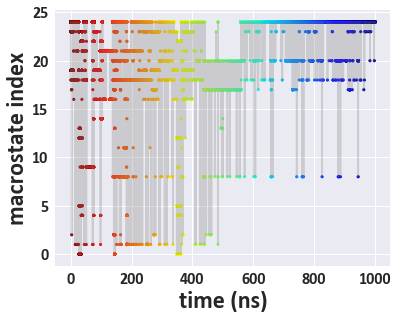

In [51]:
time_step=0.01       #ns
import pandas as pd
import seaborn as sns
sns.set(color_codes=True)
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
font_path = '/home/disk2/wdd/msm/calibribold.ttf'
font_prop = font_manager.FontProperties(fname=font_path, size=24)
leg_prop = font_manager.FontProperties(fname=font_path, size=17)
cmap = plt.cm.get_cmap("jet_r")
for nt in [1]:
#for nt in [1]:
    fig, ax = plt.subplots(figsize=(6,4.7))
    i=8
    data = np.loadtxt('fit'+str(nt)+'_chainE_macro_trajs.dat')
    #dist = data[:,0]
    time = np.arange(len(data))*time_step
    ax.scatter(time,data, c=np.arange(len(data)),cmap=cmap,lw = 0,s=10)
    ax.plot(time,data,'gray',alpha=0.3)
        #ax.set_ylabel('rmsd ($^\circ$)',fontproperties=font_prop)
    ax.set_ylabel('macrostate index',fontproperties=font_prop)
    ax.set_xlabel('time (ns)',fontproperties=font_prop)
    #plt.ylim(-0.01,0.41)
    #plt.xlim(0,1000)
    #ax.set_xticks(np.linspace(0,1200,7))
    #ax.set_xticklabels([0,200,400,600,800,1000])
    #leg=plt.legend(loc=1, labelspacing=0.1, prop=leg_prop, scatterpoints=1, markerscale=1, numpoints=1,handlelength=1.5)
    #leg.get_frame().set_linewidth(0.0)
    #leg.get_frame().set_alpha(0.1)
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontproperties(font_prop)
        label.set_fontsize(16)
    plt.savefig("fit"+str(nt)+"_chainE_macro_trajs"+".png",dpi=600,bbox_inches='tight')
    plt.show()

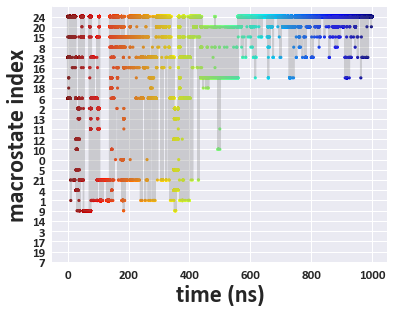

In [63]:
map_mfpt=[7,19,17,3,14,9,1,4,21,5,0,10,12,11,13,2,6,18,22,16,23,8,15,20,24]
time_step=0.01       #ns
import pandas as pd
import seaborn as sns
sns.set(color_codes=True)
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
font_path = '/home/disk2/wdd/msm/calibribold.ttf'
font_prop = font_manager.FontProperties(fname=font_path, size=24)
leg_prop = font_manager.FontProperties(fname=font_path, size=17)
cmap = plt.cm.get_cmap("jet_r")
for nt in [1]:
#for nt in [1]:
    fig, ax = plt.subplots(figsize=(6,4.7))
    i=8
    data = np.loadtxt('fit'+str(nt)+'_chainE_macro_trajs.dat')
    data_sort=[]
    for m in data:
        data_sort.append(map_mfpt[int(m)])
    time = np.arange(len(data))*time_step
    ax.scatter(time,data_sort, c=np.arange(len(data)),cmap=cmap,lw = 0,s=10)
    ax.plot(time,data_sort,'gray',alpha=0.3)
        #ax.set_ylabel('rmsd ($^\circ$)',fontproperties=font_prop)
    ax.set_ylabel('macrostate index',fontproperties=font_prop)
    ax.set_xlabel('time (ns)',fontproperties=font_prop)
    plt.ylim(0,25)
    #plt.xlim(0,1000)
    ax.set_yticks(np.linspace(0,25,26))
    ax.set_yticklabels(map_mfpt)
    #leg=plt.legend(loc=1, labelspacing=0.1, prop=leg_prop, scatterpoints=1, markerscale=1, numpoints=1,handlelength=1.5)
    #leg.get_frame().set_linewidth(0.0)
    #leg.get_frame().set_alpha(0.1)
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontproperties(font_prop)
        label.set_fontsize(13)
    plt.savefig("fit"+str(nt)+"_chainE_macro_trajs_mfpt_sort"+".png",dpi=600,bbox_inches='tight')
    plt.show()

In [29]:
pwd

u'/home/disk2/wdd/PDZ/MSM/charm36m'

fit2_skip10_chain1


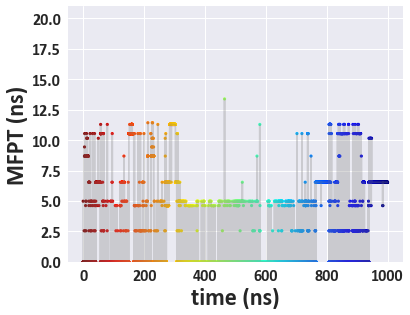

fit2_skip10_chain2


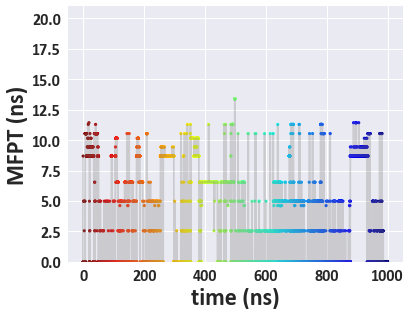

fit2_skip10_chain3


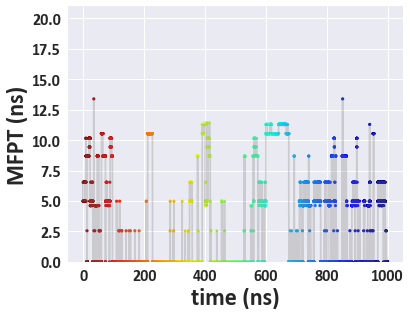

fit2_skip10_chain4


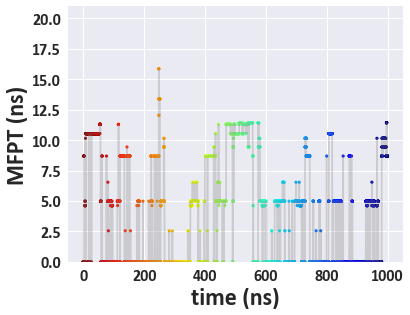

fit2_skip10_chain5


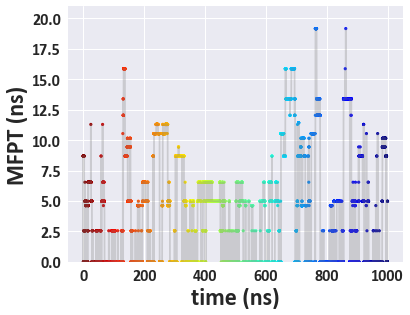

fit2_skip10_chain6


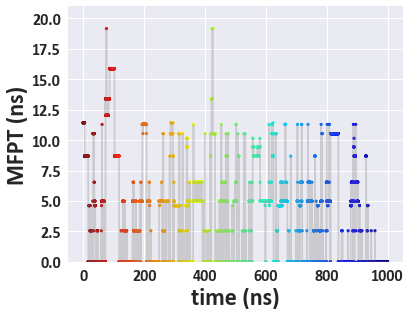

fit2_skip10_chain7


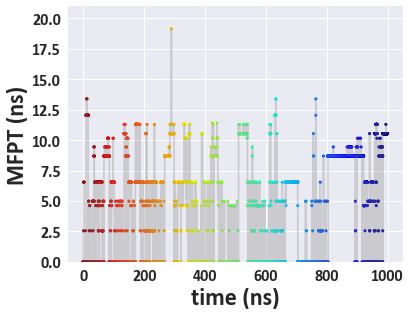

fit2_skip10_chain8


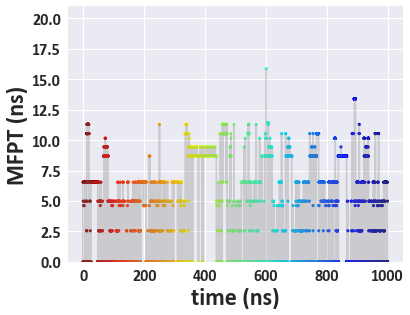

fit2_skip10_chain9


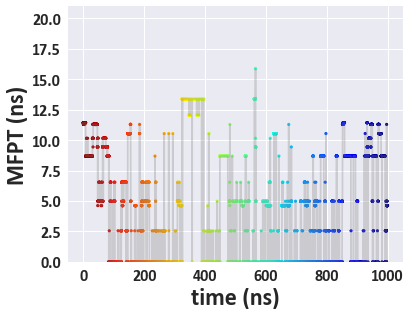

fit2_skip10_chain10


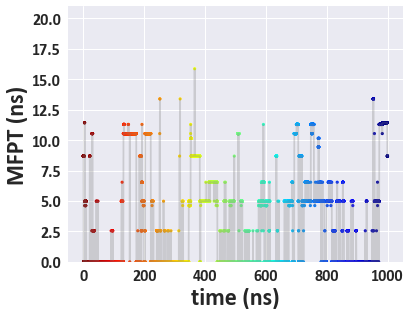

fit2_skip10_chain11


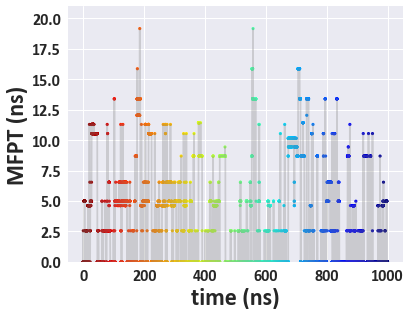

fit2_skip10_chain12


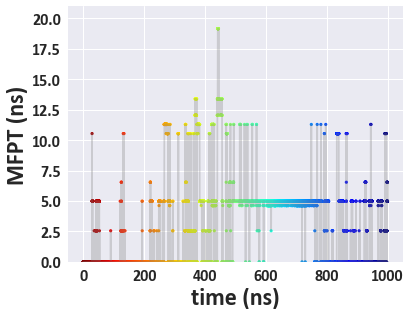

fit3_skip10_chain1


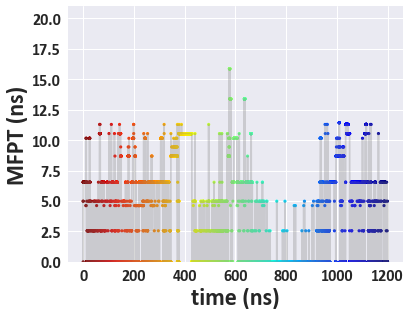

fit3_skip10_chain2


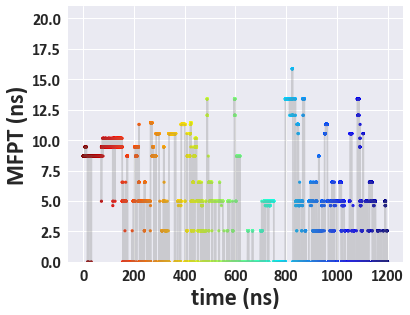

fit3_skip10_chain3


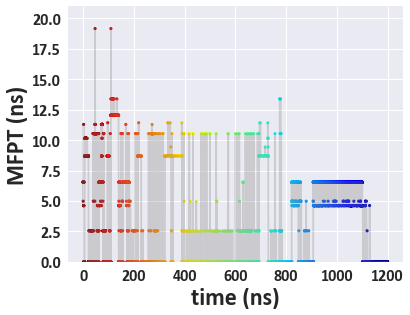

fit3_skip10_chain4


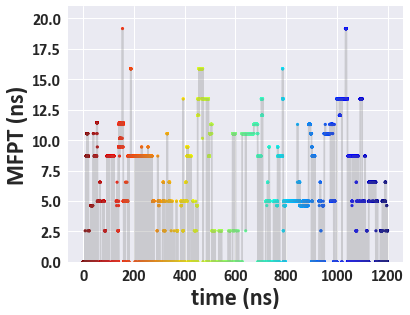

fit3_skip10_chain5


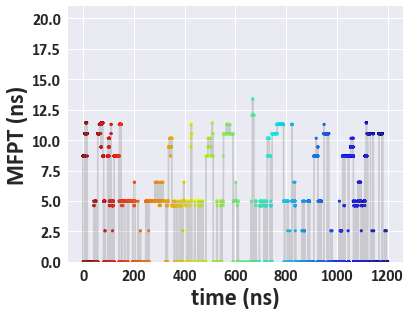

fit3_skip10_chain6


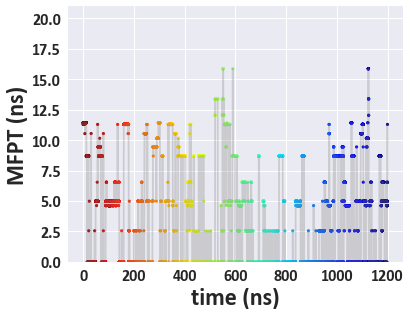

fit3_skip10_chain7


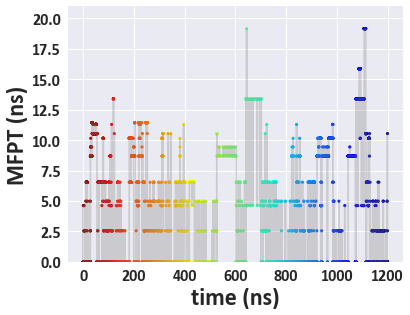

fit3_skip10_chain8


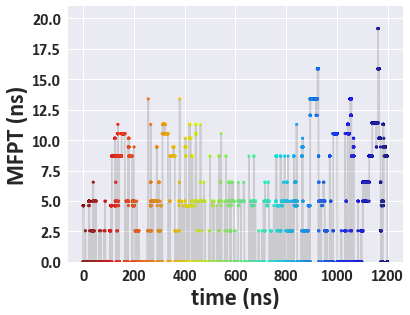

fit3_skip10_chain9


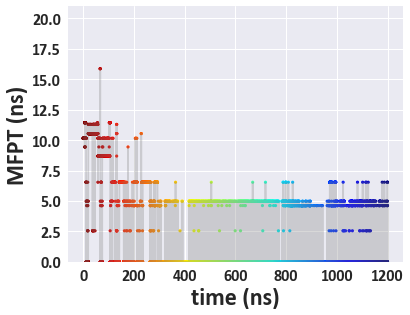

fit3_skip10_chain10


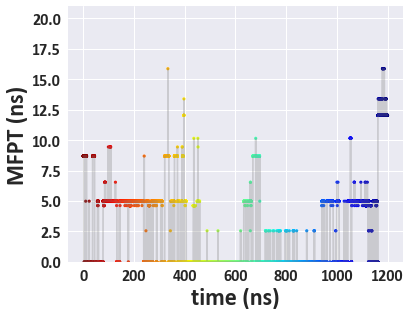

fit3_skip10_chain11


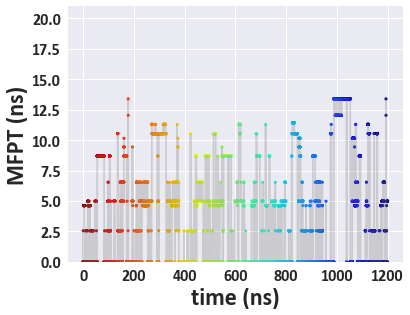

fit3_skip10_chain12


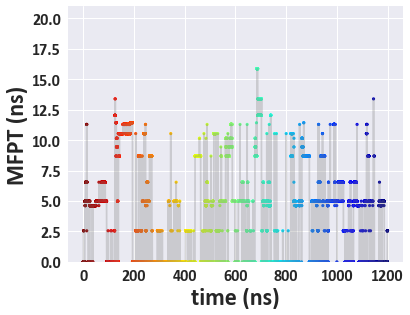

fit4_skip10_chain1


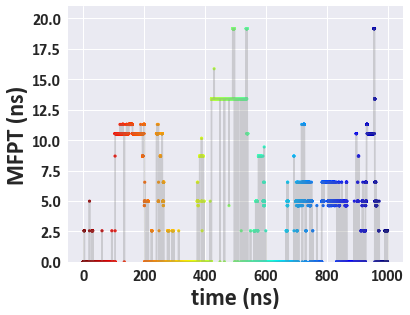

fit4_skip10_chain2


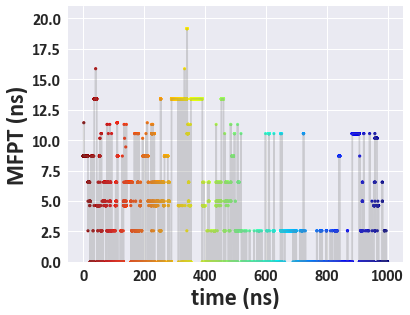

fit4_skip10_chain3


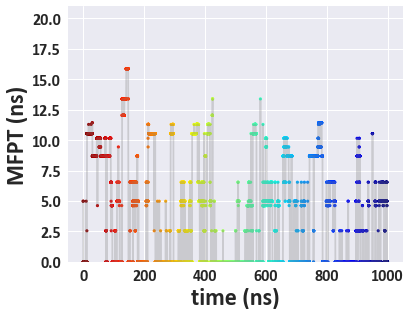

fit4_skip10_chain4


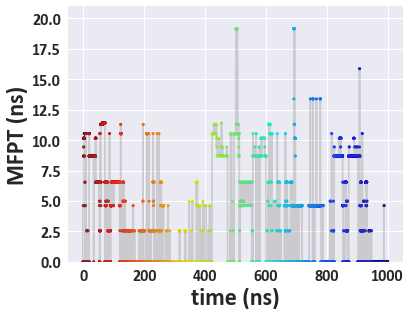

fit4_skip10_chain5


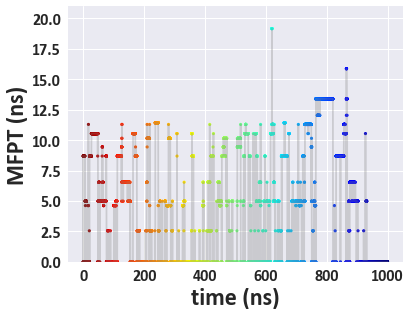

fit4_skip10_chain6


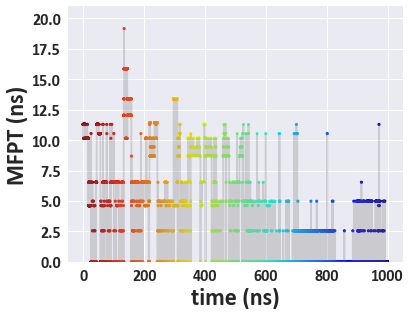

fit4_skip10_chain7


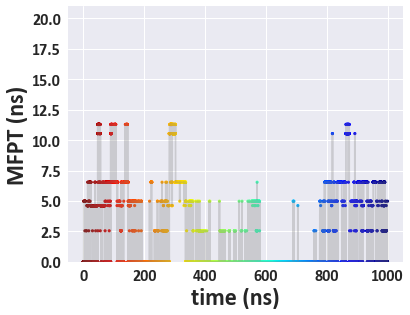

fit4_skip10_chain8


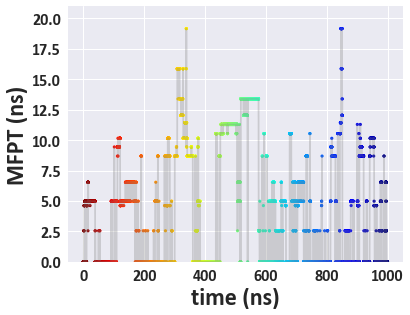

fit4_skip10_chain9


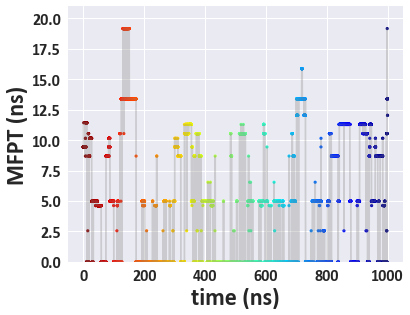

fit4_skip10_chain10


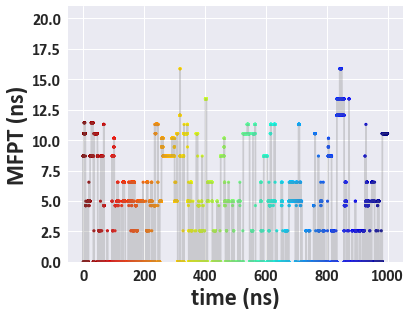

fit4_skip10_chain11


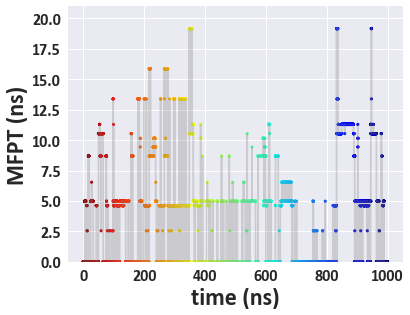

fit4_skip10_chain12


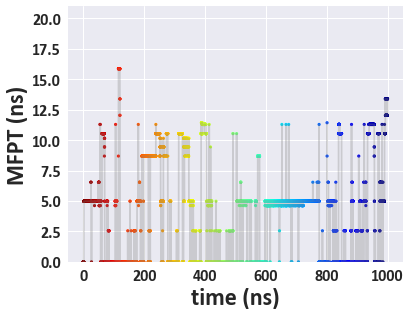

fit5_skip10_chain1


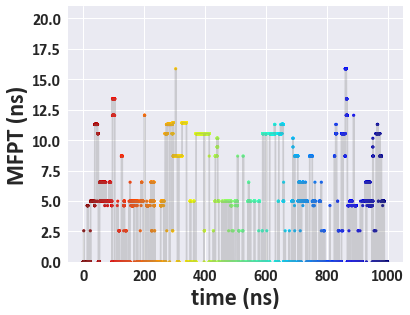

fit5_skip10_chain2


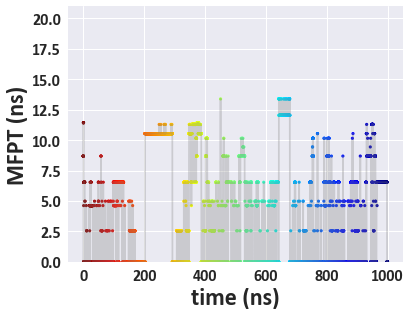

fit5_skip10_chain3


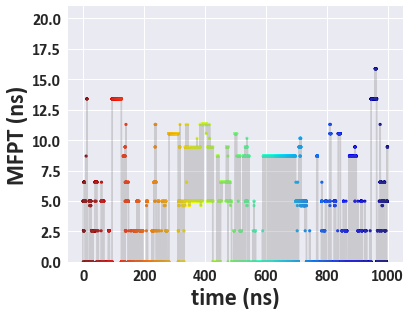

fit5_skip10_chain4


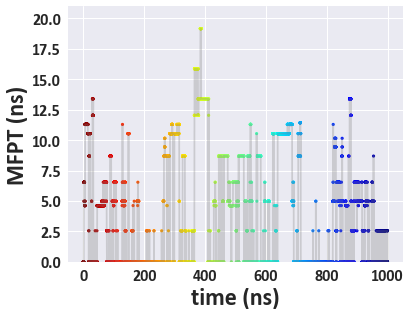

fit5_skip10_chain5


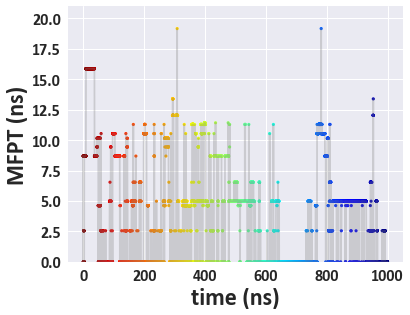

fit5_skip10_chain6


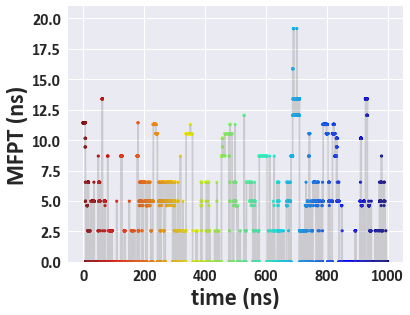

fit5_skip10_chain7


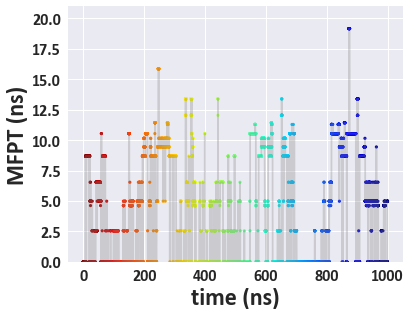

fit5_skip10_chain8


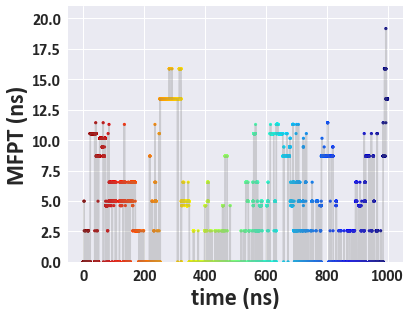

fit5_skip10_chain9


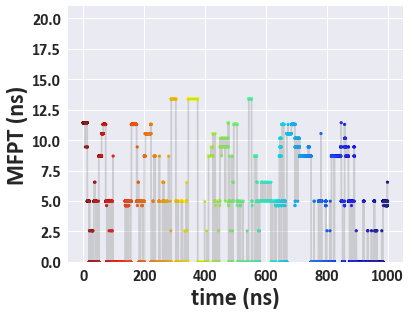

fit5_skip10_chain10


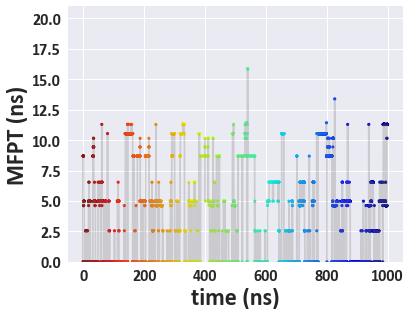

fit5_skip10_chain11


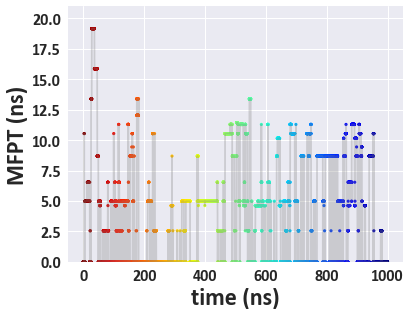

fit5_skip10_chain12


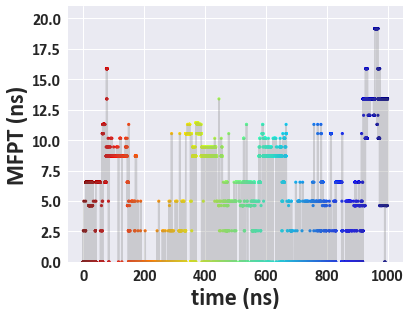

fit6_skip10_chain1


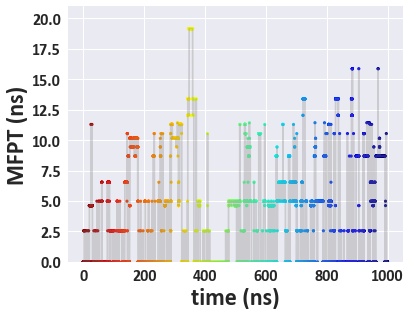

fit6_skip10_chain2


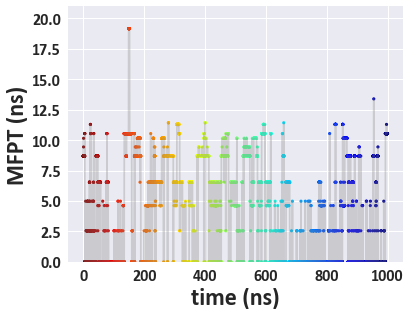

fit6_skip10_chain3


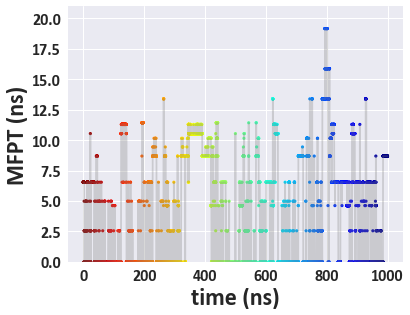

fit6_skip10_chain4


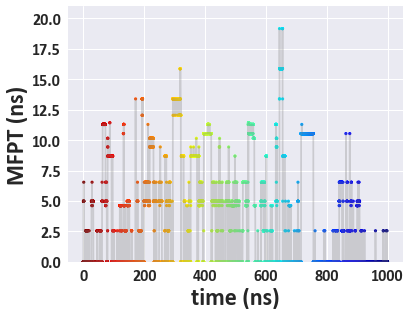

fit6_skip10_chain5


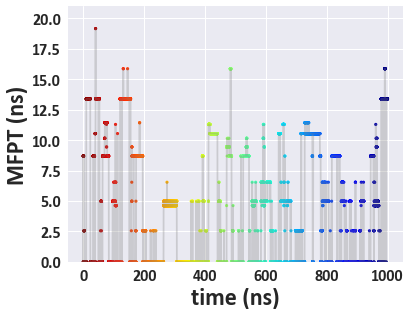

fit6_skip10_chain6


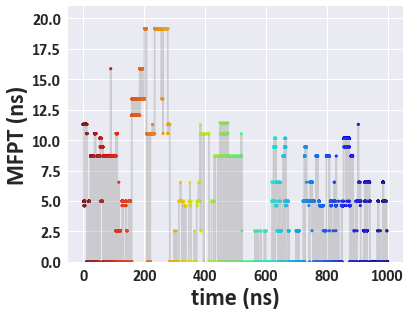

fit6_skip10_chain7


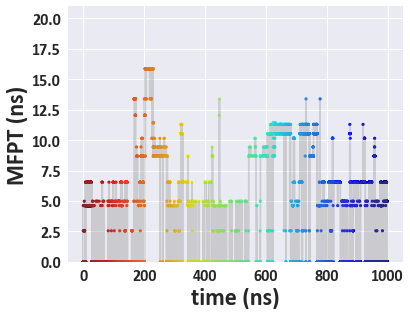

fit6_skip10_chain8


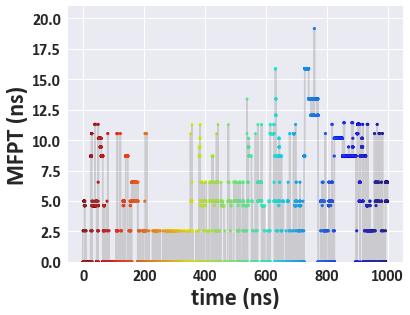

fit6_skip10_chain9


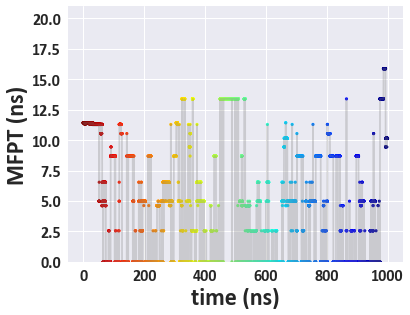

fit6_skip10_chain10


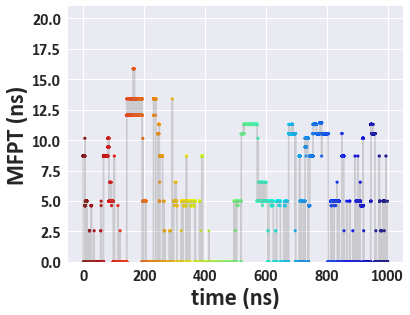

fit6_skip10_chain11


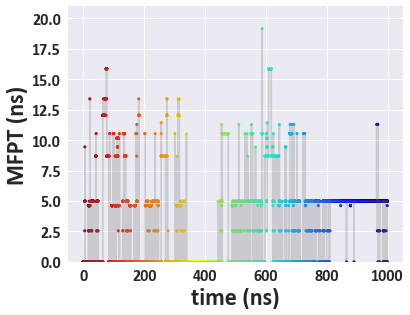

fit6_skip10_chain12


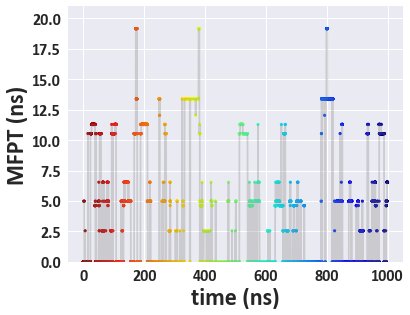

fit7_skip10_chain1


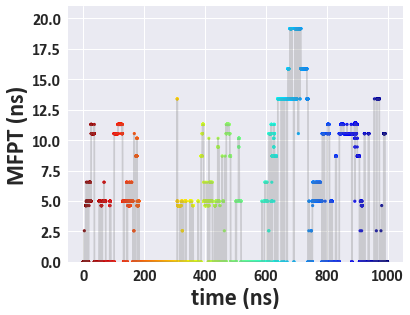

fit7_skip10_chain2


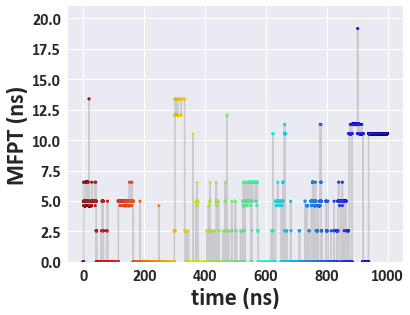

fit7_skip10_chain3


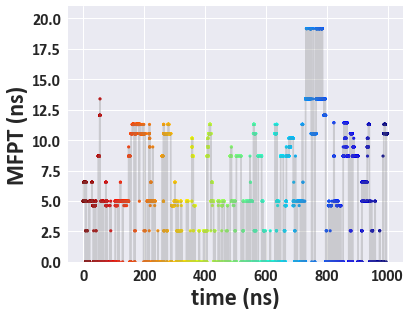

fit7_skip10_chain4


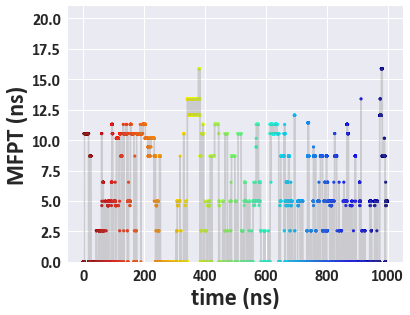

fit7_skip10_chain5


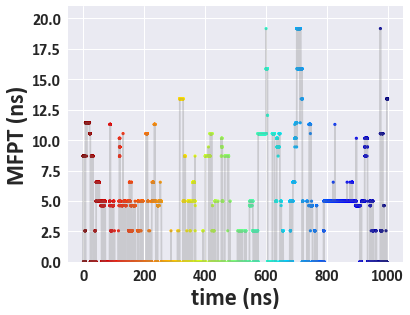

fit7_skip10_chain6


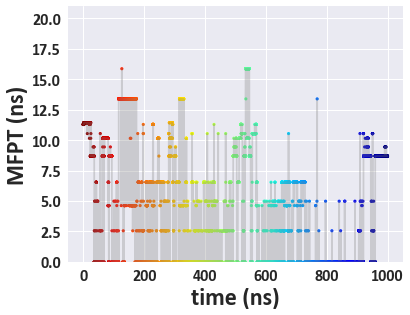

fit7_skip10_chain7


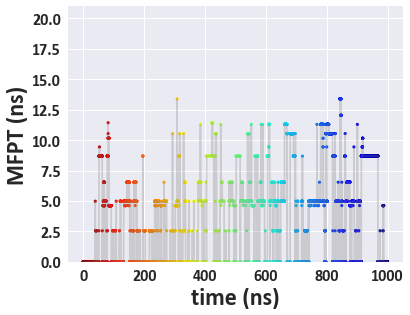

fit7_skip10_chain8


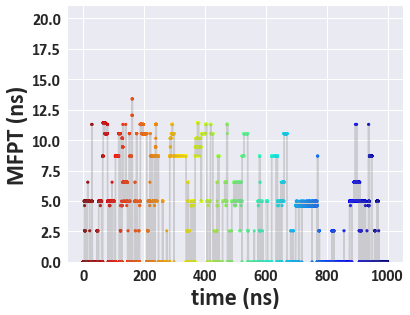

fit7_skip10_chain9


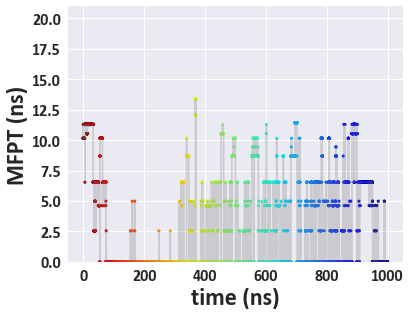

fit7_skip10_chain10


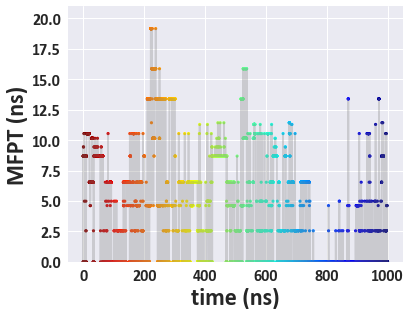

fit7_skip10_chain11


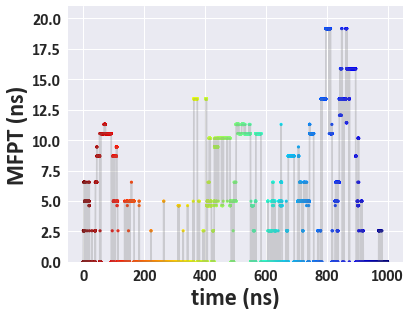

fit7_skip10_chain12


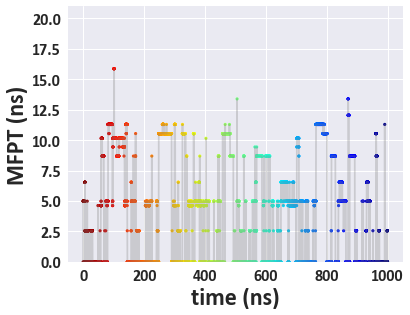

fit8_skip10_chain1


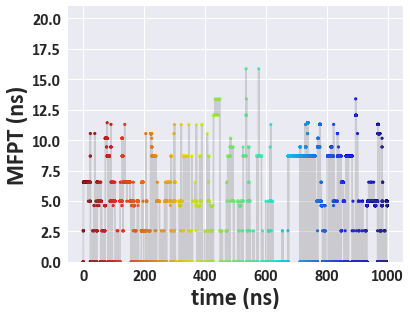

fit8_skip10_chain2


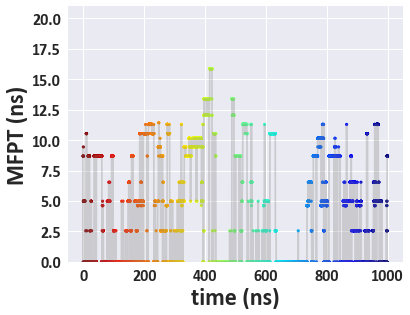

fit8_skip10_chain3


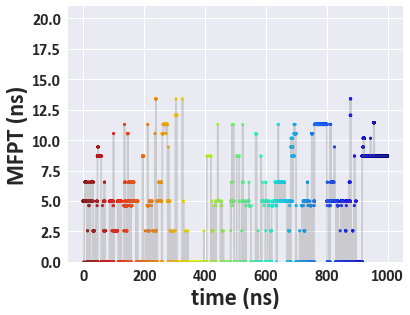

fit8_skip10_chain4


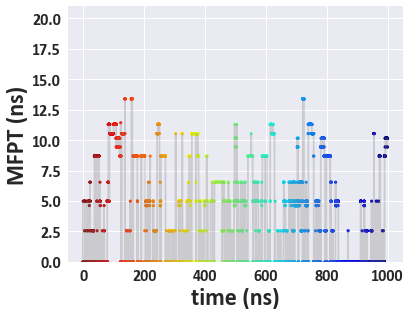

fit8_skip10_chain5


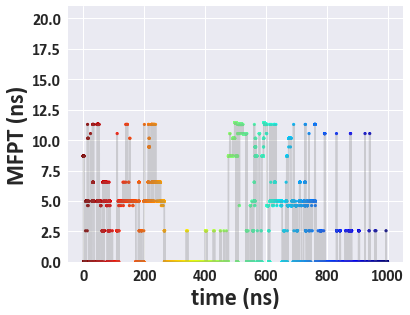

fit8_skip10_chain6


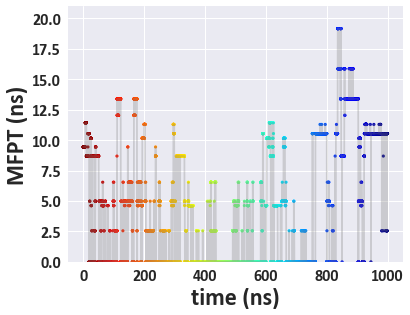

fit8_skip10_chain7


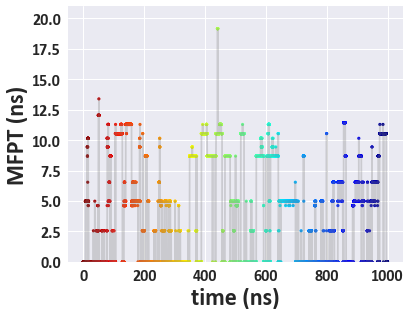

fit8_skip10_chain8


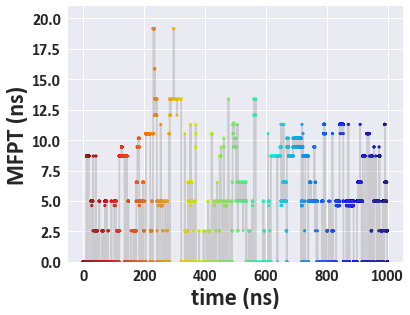

fit8_skip10_chain9


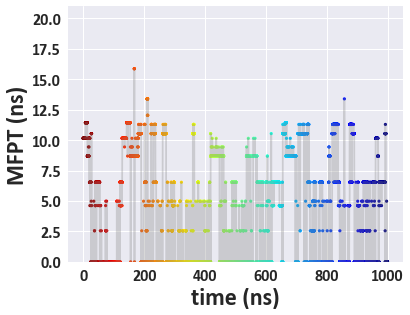

fit8_skip10_chain10


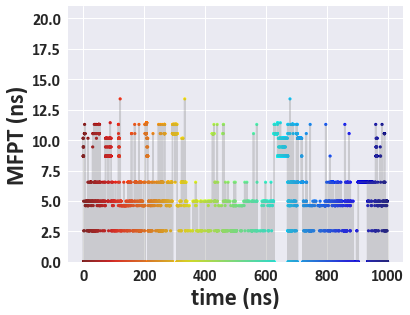

fit8_skip10_chain11


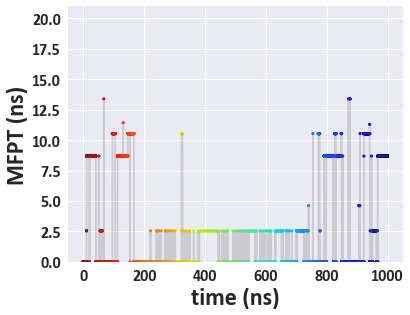

fit8_skip10_chain12


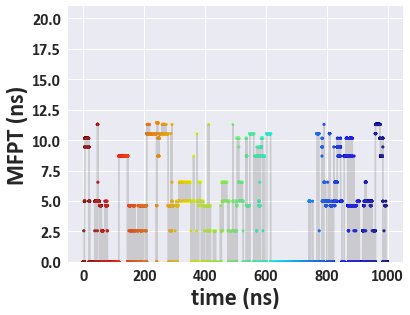

fit9_skip10_chain1


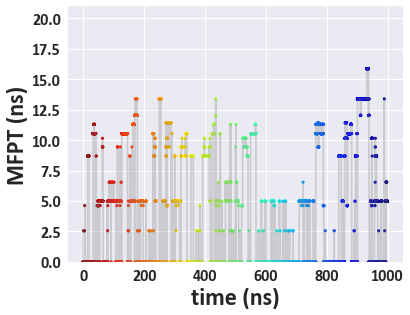

fit9_skip10_chain2


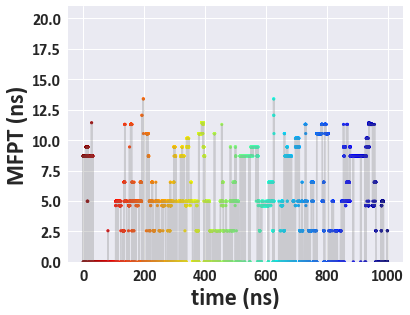

fit9_skip10_chain3


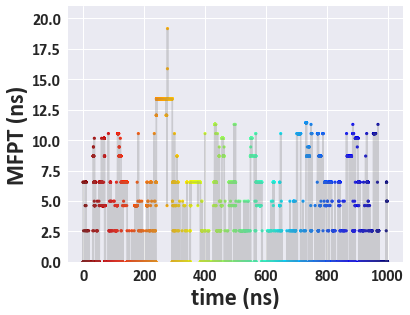

fit9_skip10_chain4


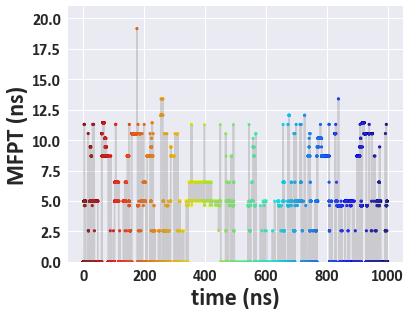

fit9_skip10_chain5


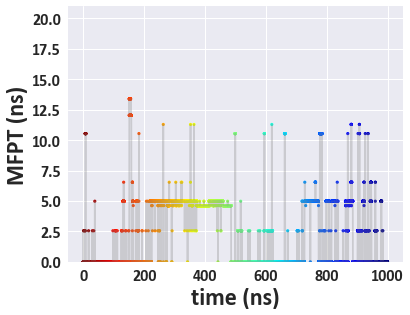

fit9_skip10_chain6


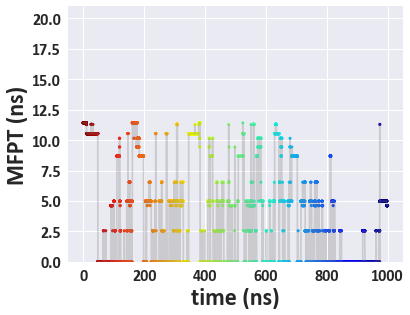

fit9_skip10_chain7


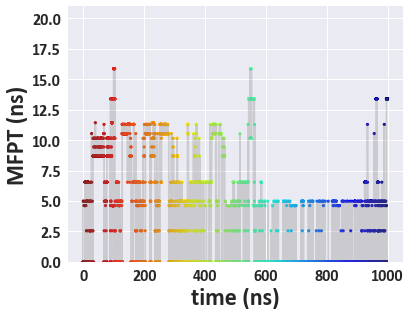

fit9_skip10_chain8


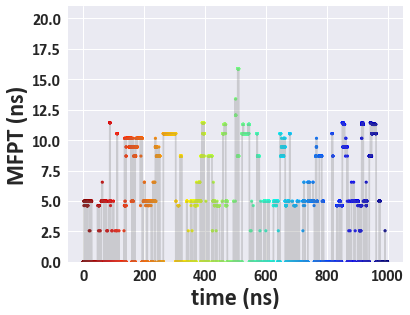

fit9_skip10_chain9


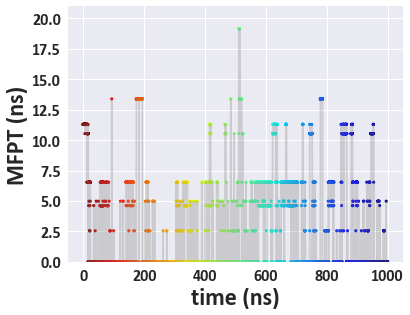

fit9_skip10_chain10


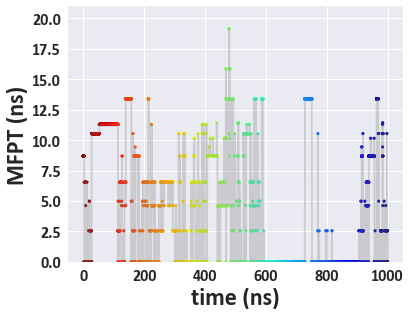

fit9_skip10_chain11


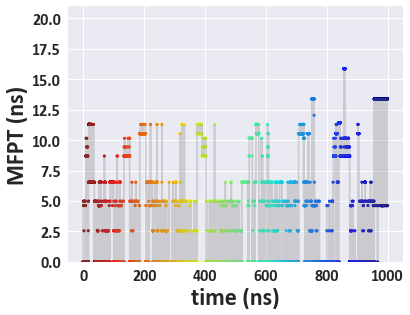

fit9_skip10_chain12


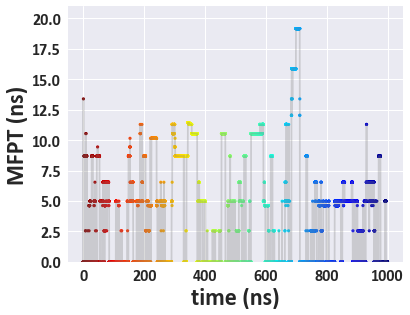

fit10_skip10_chain1


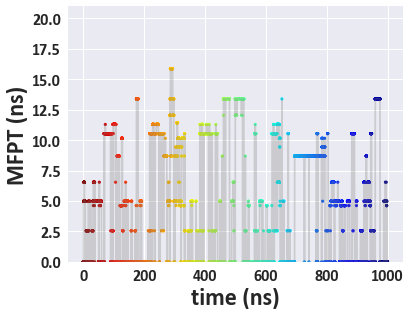

fit10_skip10_chain2


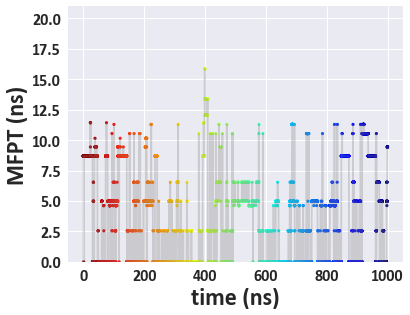

fit10_skip10_chain3


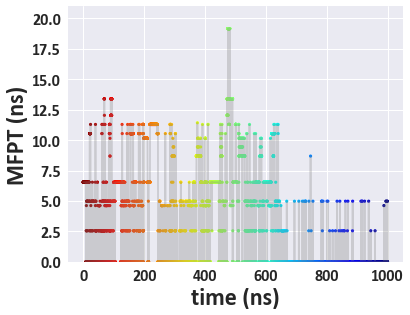

fit10_skip10_chain4


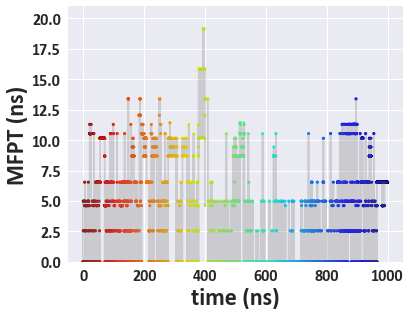

fit10_skip10_chain5


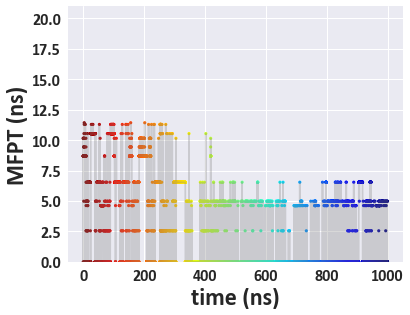

fit10_skip10_chain6


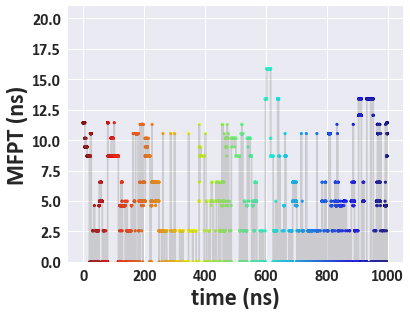

fit10_skip10_chain7


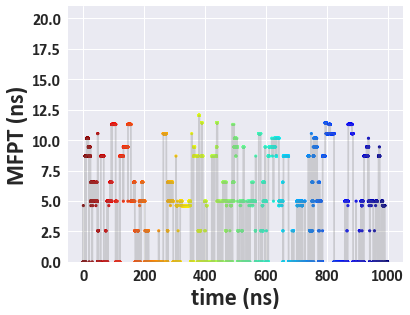

fit10_skip10_chain8


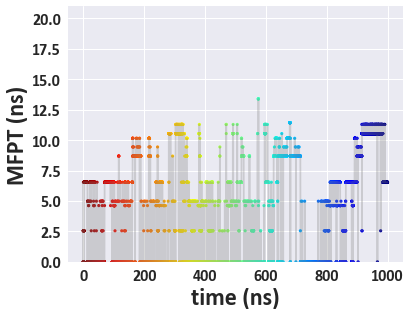

fit10_skip10_chain9


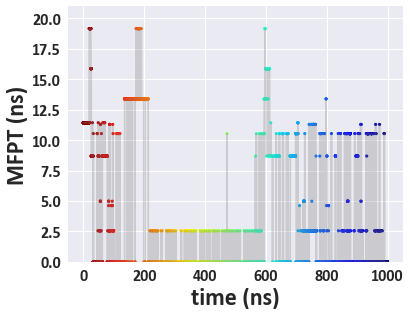

fit10_skip10_chain10


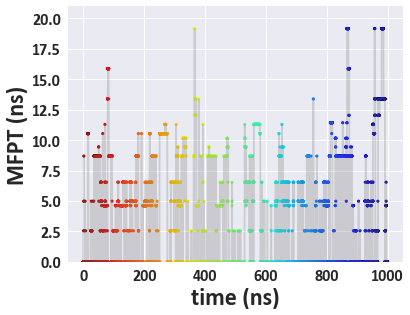

fit10_skip10_chain11


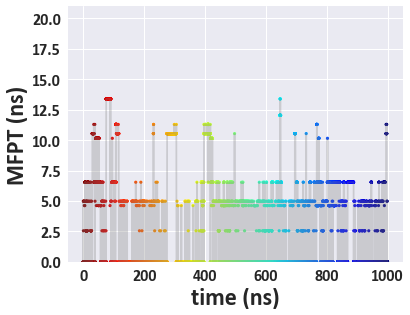

fit10_skip10_chain12


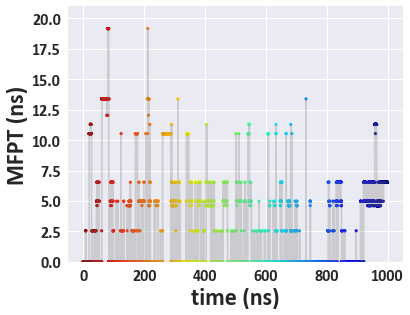

fit11_skip10_chain1


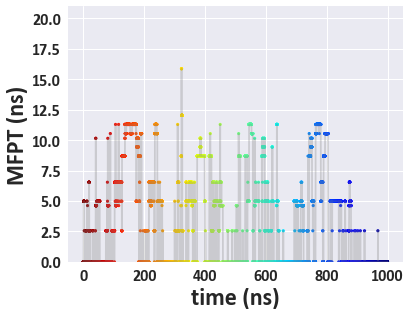

fit11_skip10_chain2


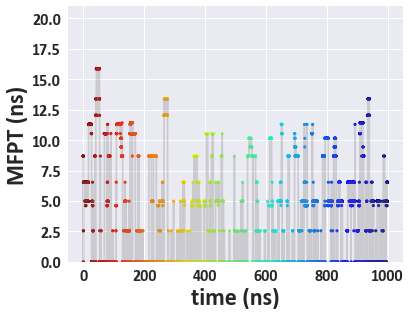

fit11_skip10_chain3


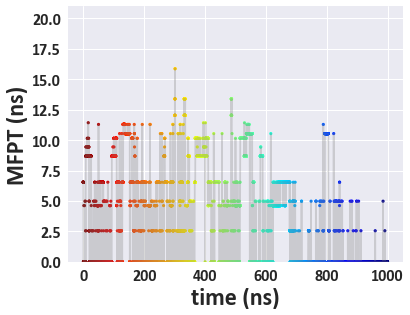

fit11_skip10_chain4


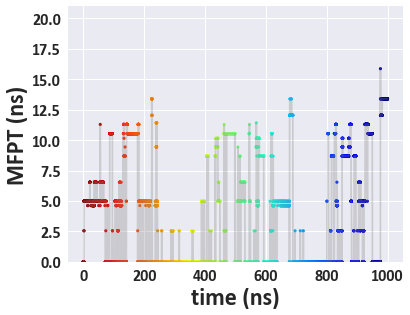

fit11_skip10_chain5


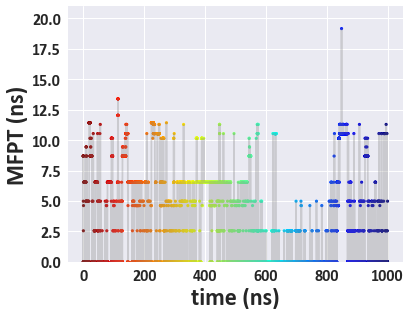

fit11_skip10_chain6


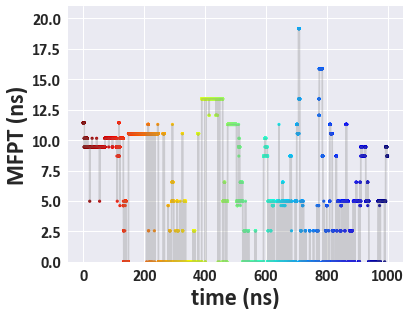

fit11_skip10_chain7


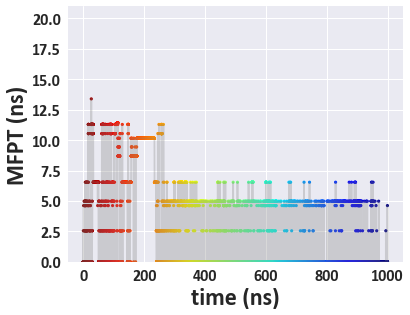

fit11_skip10_chain8


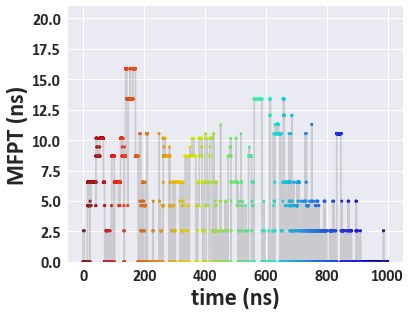

fit11_skip10_chain9


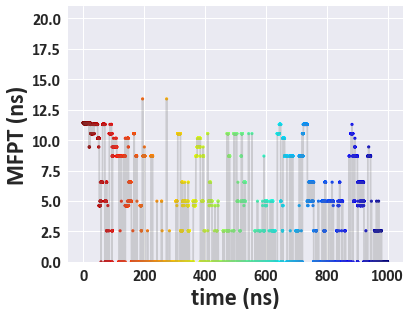

fit11_skip10_chain10


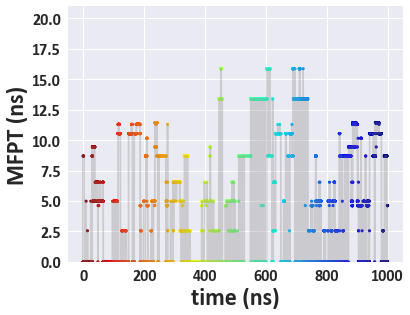

fit11_skip10_chain11


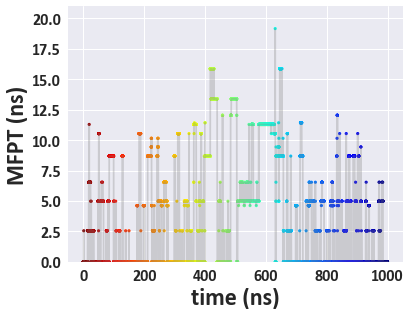

fit11_skip10_chain12


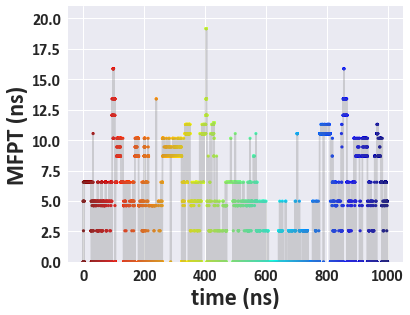

fit12_skip10_chain1


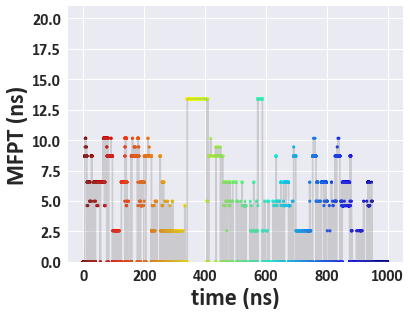

fit12_skip10_chain2


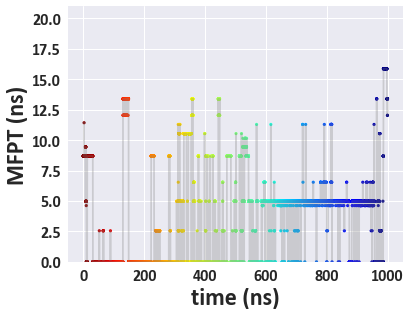

fit12_skip10_chain3


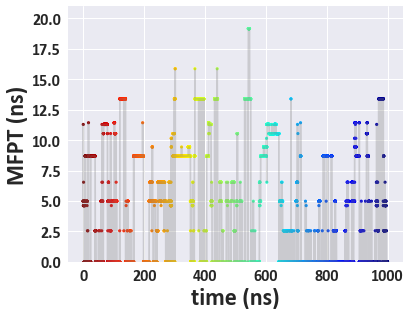

fit12_skip10_chain4


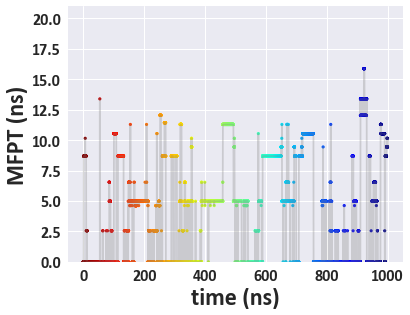

fit12_skip10_chain5


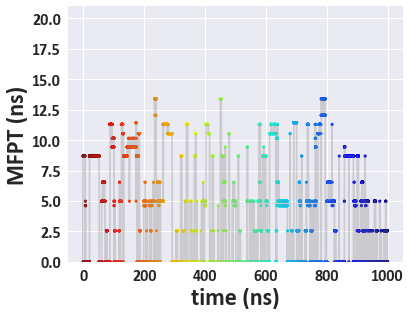

fit12_skip10_chain6


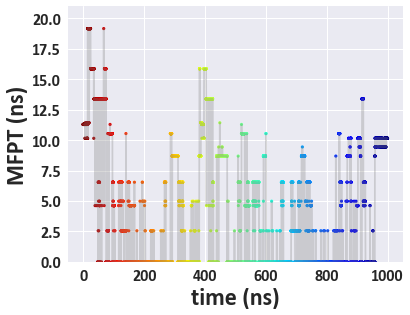

fit12_skip10_chain7


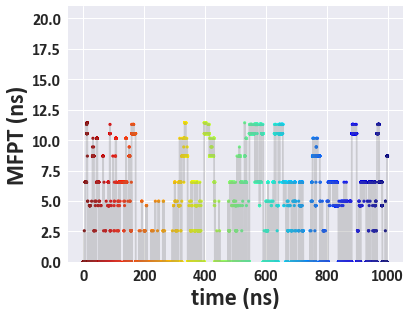

fit12_skip10_chain8


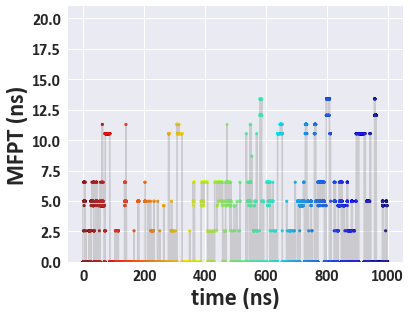

fit12_skip10_chain9


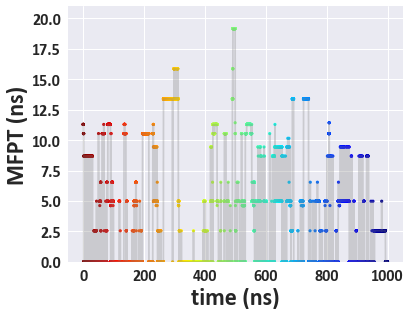

fit12_skip10_chain10


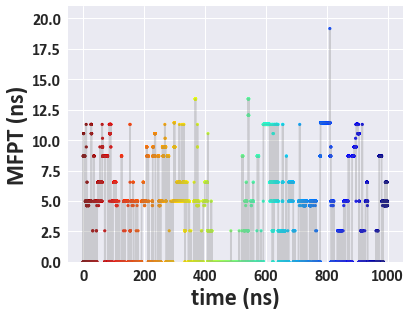

fit12_skip10_chain11


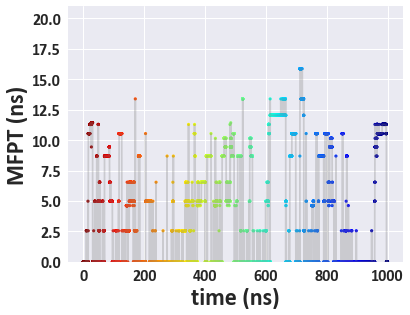

fit12_skip10_chain12


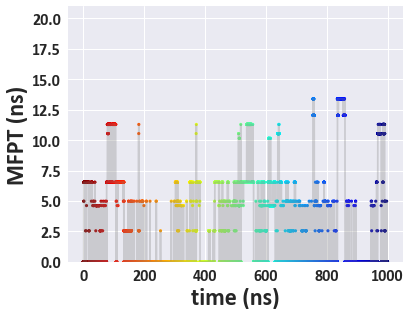

fit13_skip10_chain1


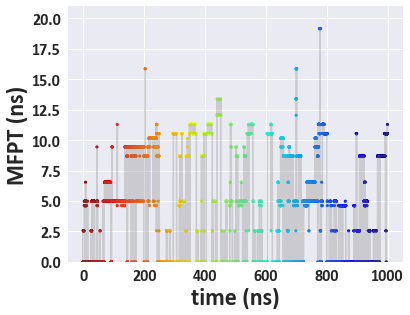

fit13_skip10_chain2


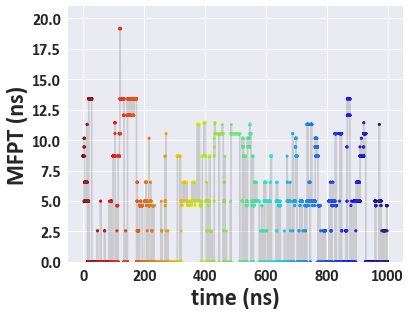

fit13_skip10_chain3


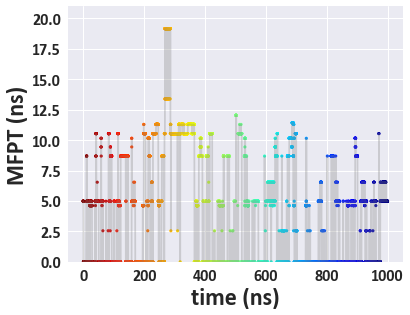

fit13_skip10_chain4


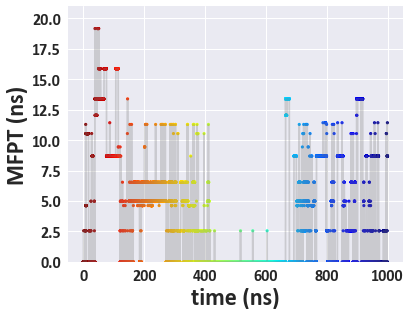

fit13_skip10_chain5


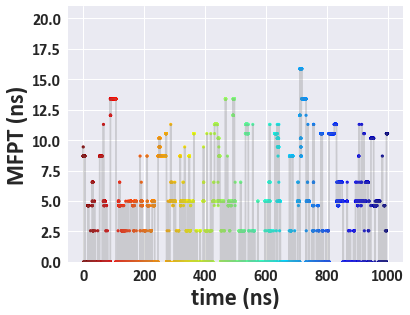

fit13_skip10_chain6


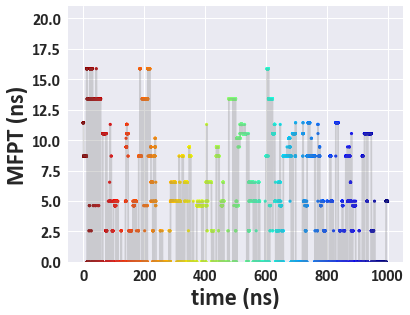

fit13_skip10_chain7


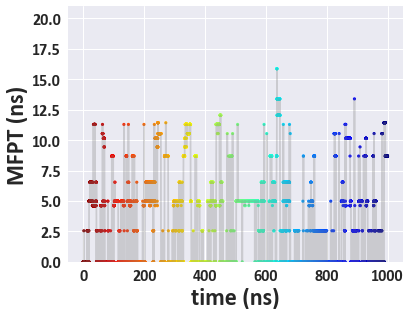

fit13_skip10_chain8


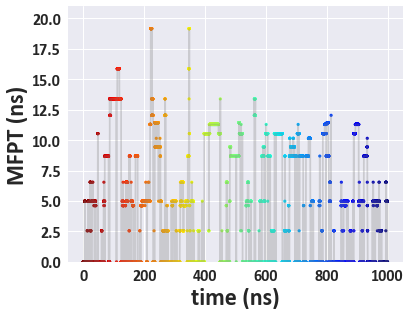

fit13_skip10_chain9


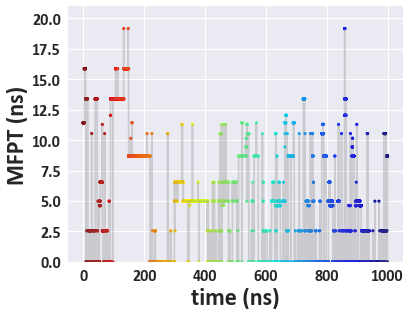

fit13_skip10_chain10


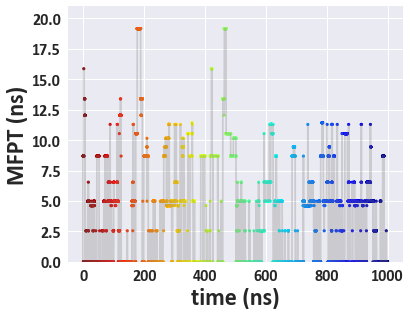

fit13_skip10_chain11


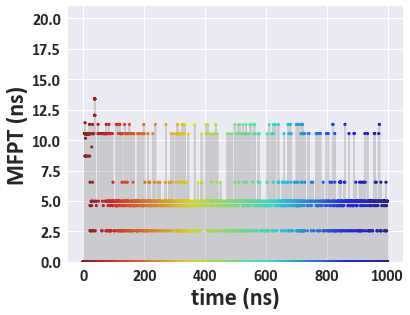

fit13_skip10_chain12


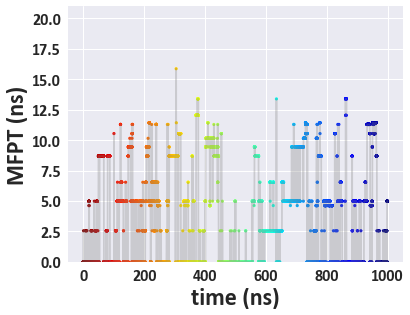

fit14_skip10_chain1


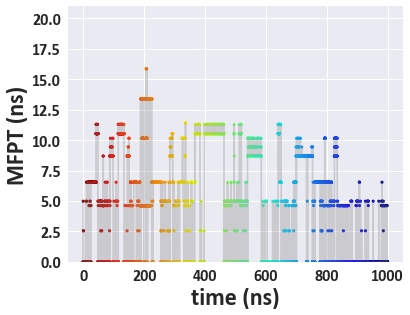

fit14_skip10_chain2


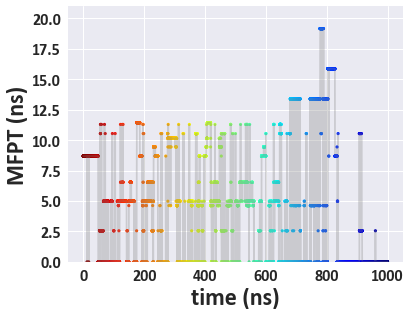

fit14_skip10_chain3


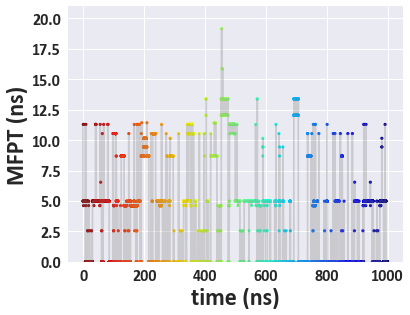

fit14_skip10_chain4


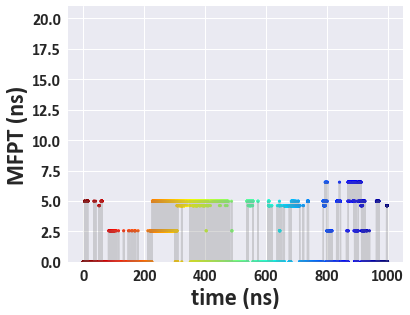

fit14_skip10_chain5


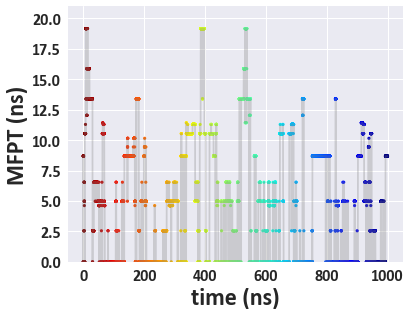

fit14_skip10_chain6


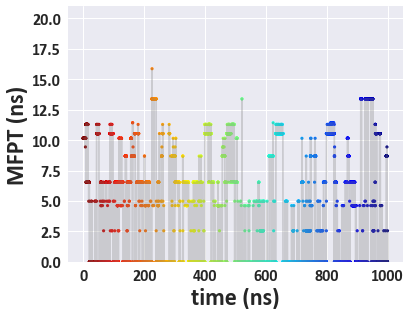

fit14_skip10_chain7


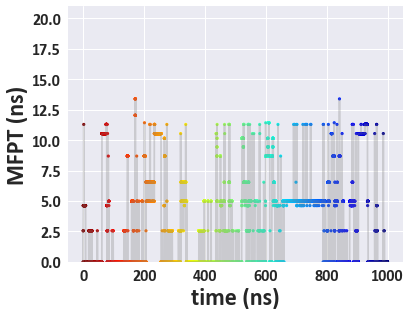

fit14_skip10_chain8


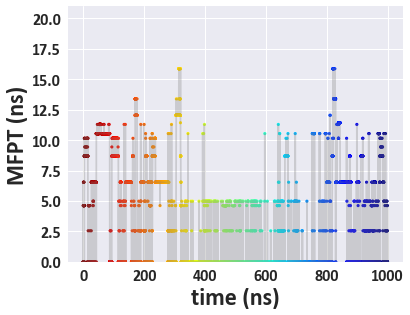

fit14_skip10_chain9


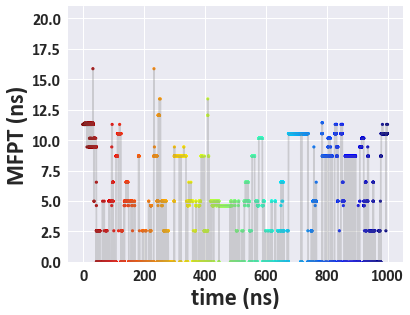

fit14_skip10_chain10


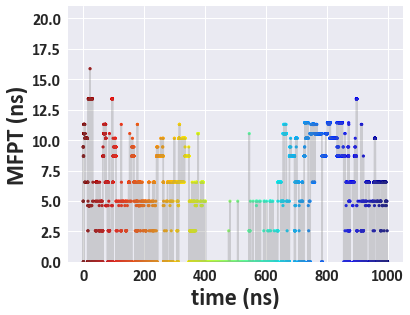

fit14_skip10_chain11


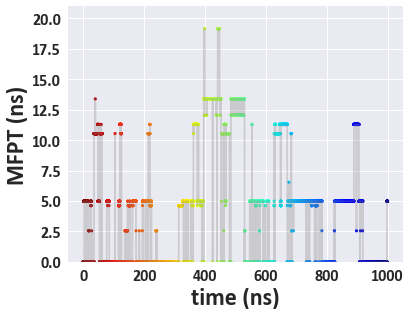

fit14_skip10_chain12


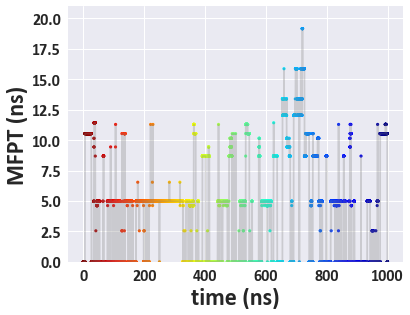

fit15_skip10_chain1


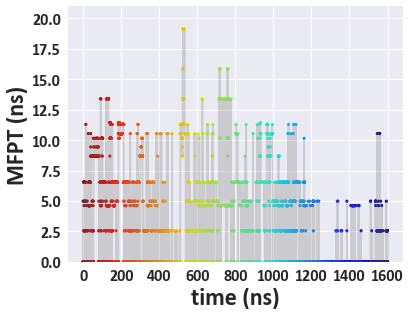

fit15_skip10_chain2


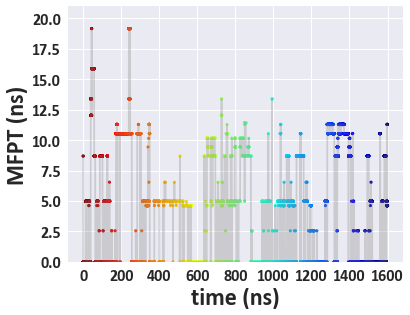

fit15_skip10_chain3


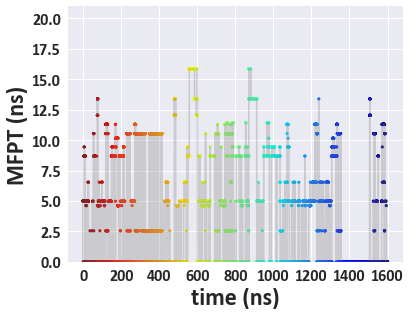

fit15_skip10_chain4


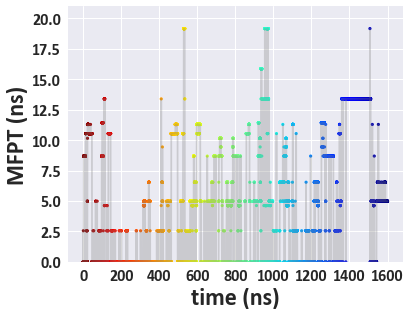

fit15_skip10_chain5


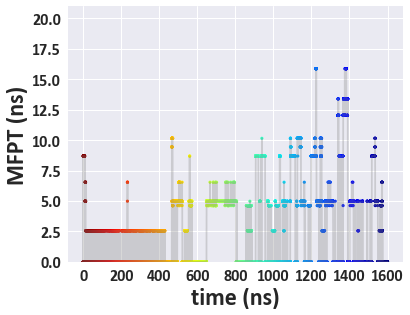

fit15_skip10_chain6


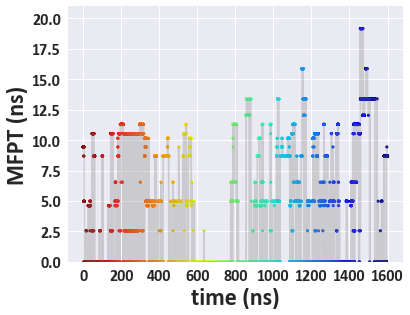

fit15_skip10_chain7


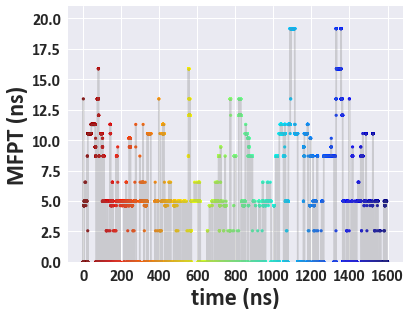

fit15_skip10_chain8


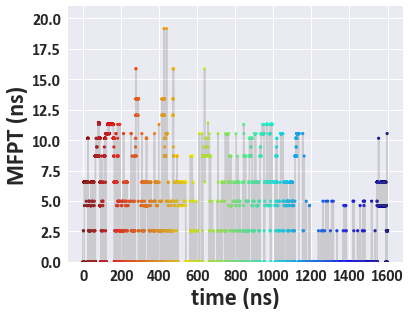

fit15_skip10_chain9


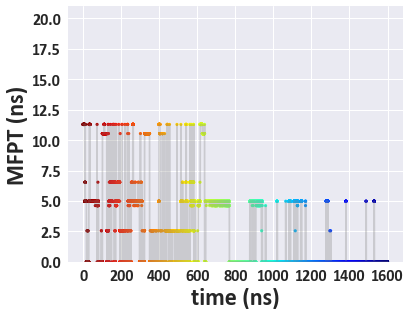

fit15_skip10_chain10


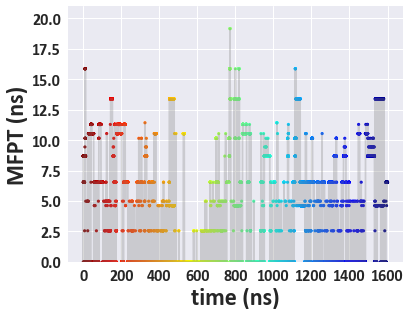

fit15_skip10_chain11


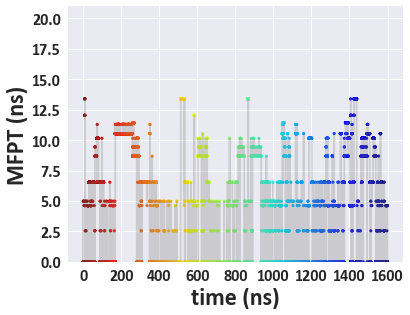

fit15_skip10_chain12


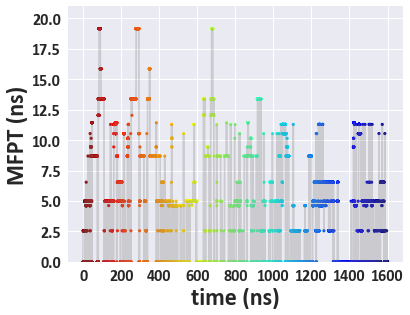

fit16_skip10_chain1


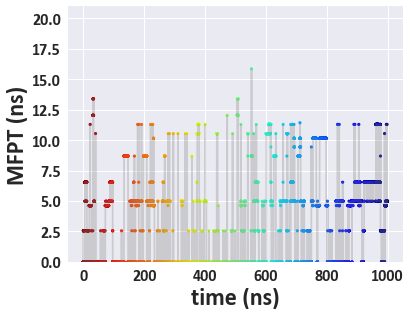

fit16_skip10_chain2


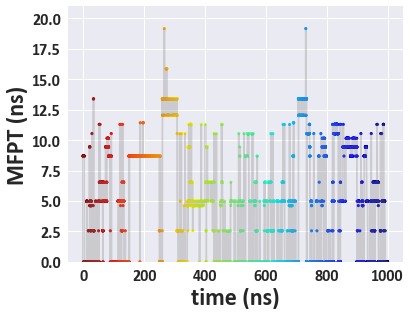

fit16_skip10_chain3


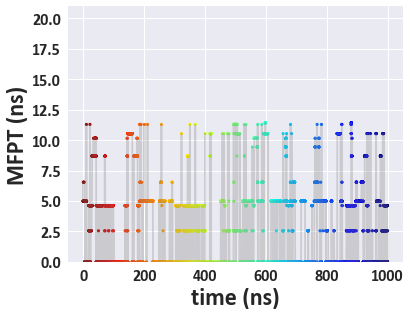

fit16_skip10_chain4


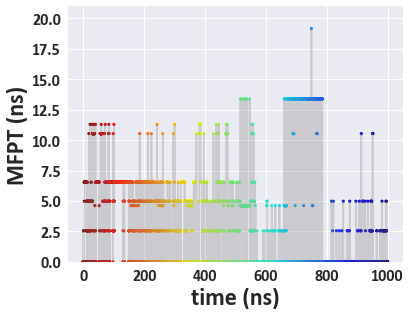

fit16_skip10_chain5


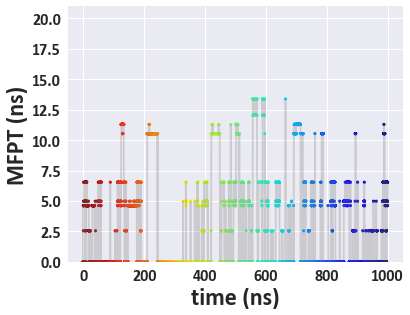

fit16_skip10_chain6


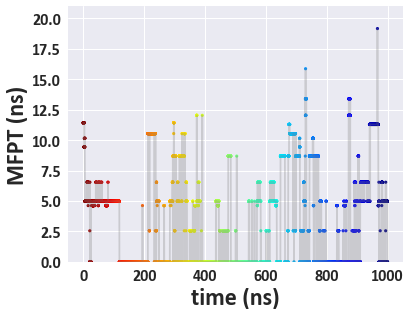

fit16_skip10_chain7


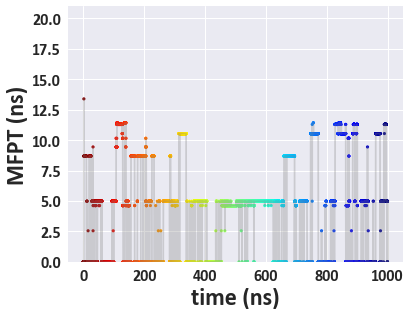

fit16_skip10_chain8


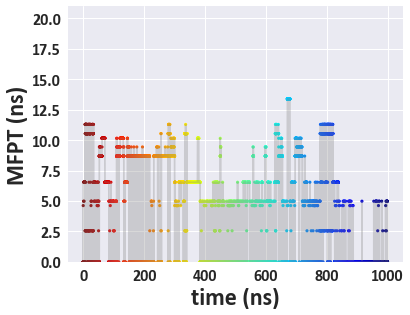

fit16_skip10_chain9


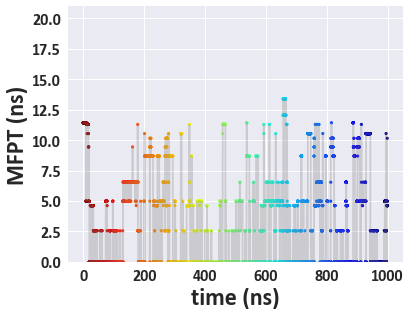

fit16_skip10_chain10


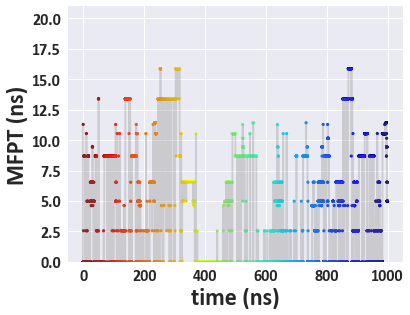

fit16_skip10_chain11


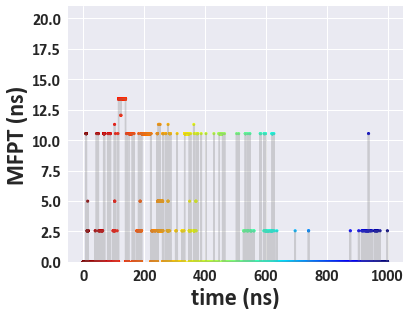

fit16_skip10_chain12


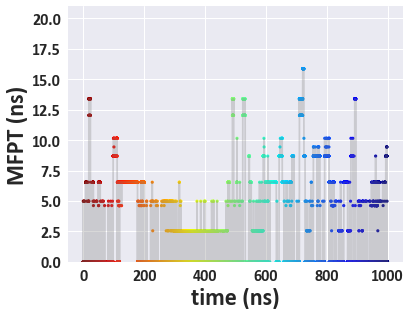

fit17_skip10_chain1


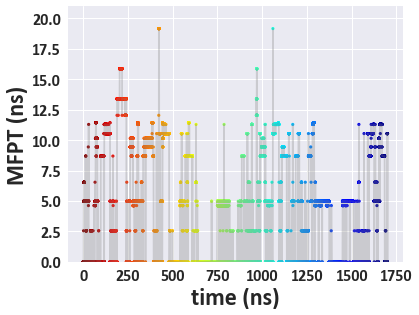

fit17_skip10_chain2


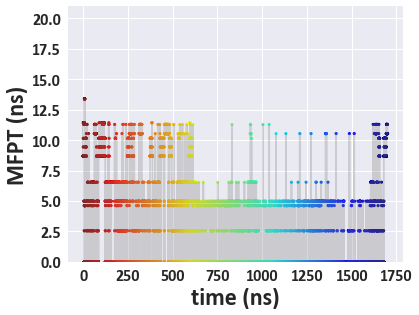

fit17_skip10_chain3


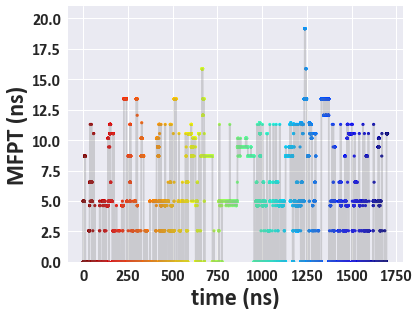

fit17_skip10_chain4


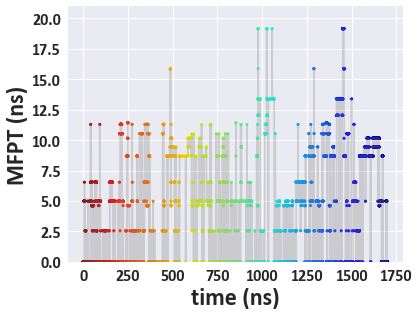

fit17_skip10_chain5


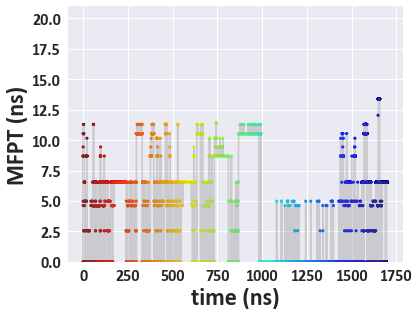

fit17_skip10_chain6


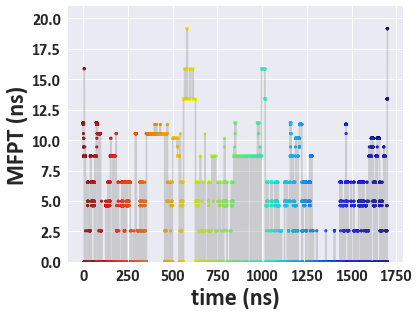

fit17_skip10_chain7


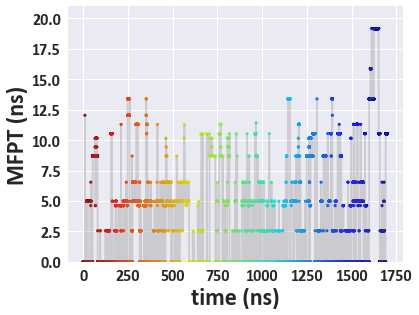

fit17_skip10_chain8


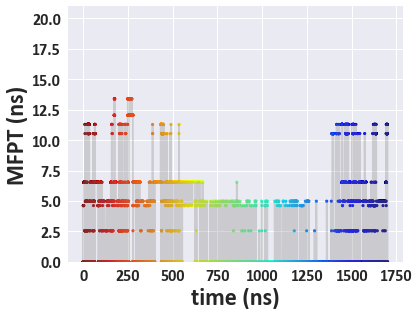

fit17_skip10_chain9


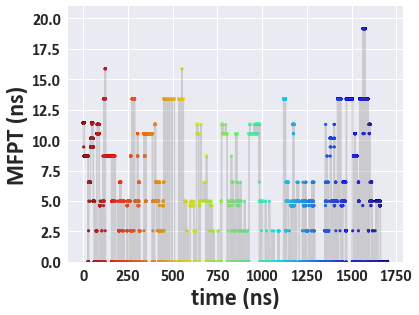

fit17_skip10_chain10


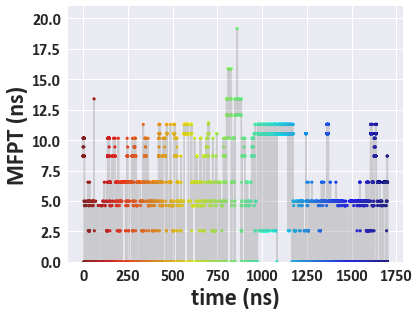

fit17_skip10_chain11


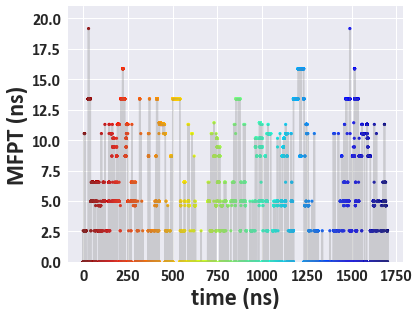

fit17_skip10_chain12


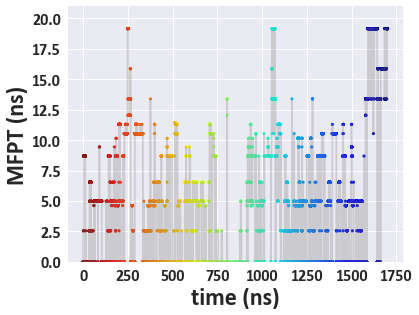

fit18_skip10_chain1


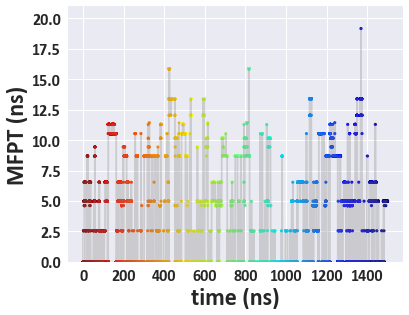

fit18_skip10_chain2


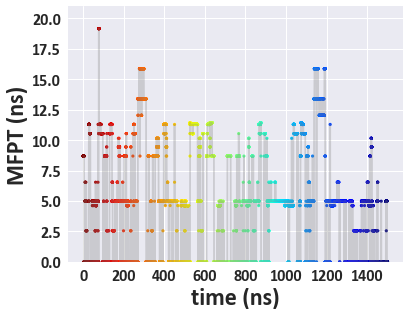

fit18_skip10_chain3


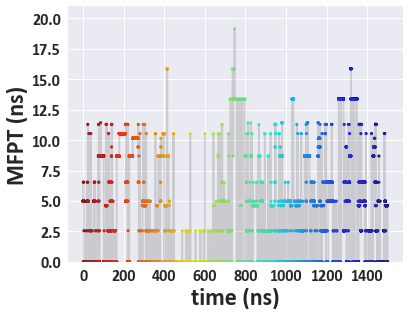

fit18_skip10_chain4


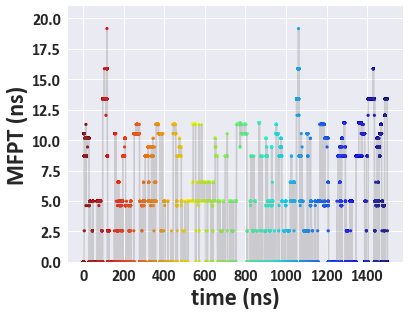

fit18_skip10_chain5


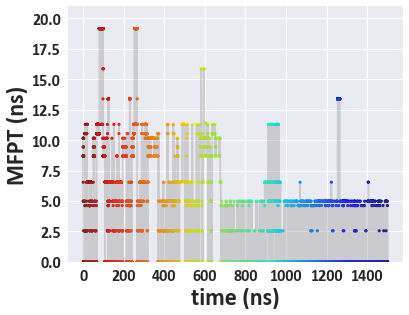

fit18_skip10_chain6


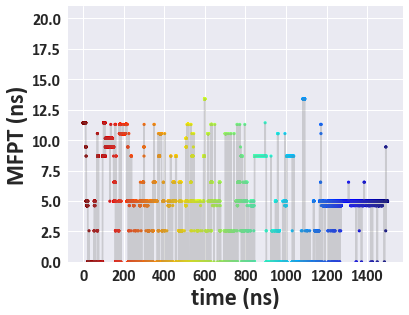

fit18_skip10_chain7


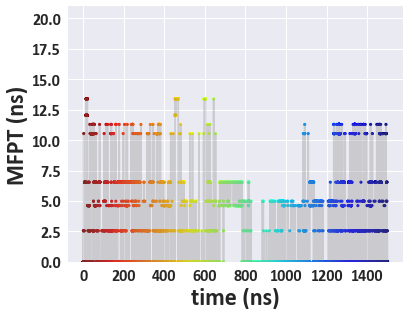

fit18_skip10_chain8


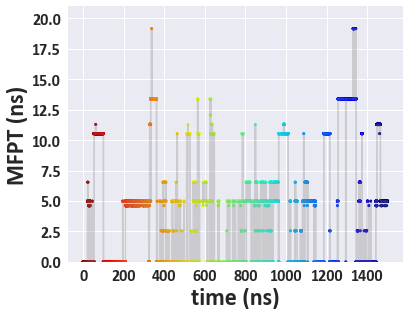

fit18_skip10_chain9


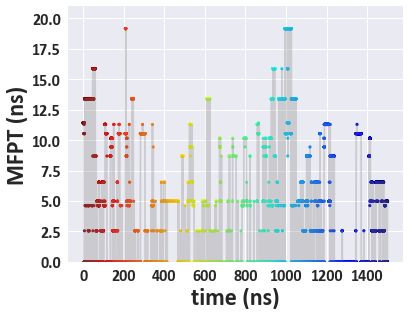

fit18_skip10_chain10


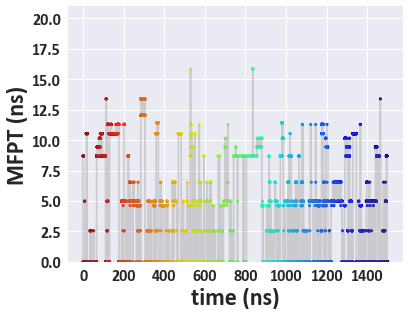

fit18_skip10_chain11


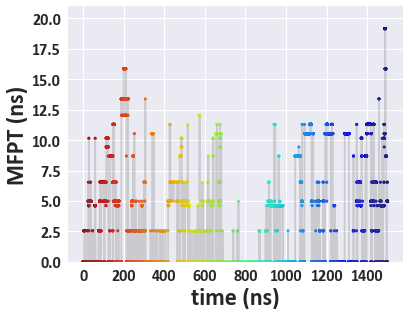

fit18_skip10_chain12


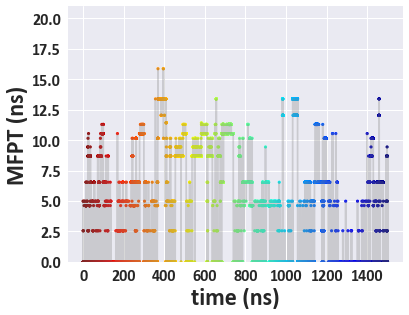

fit19_skip10_chain1


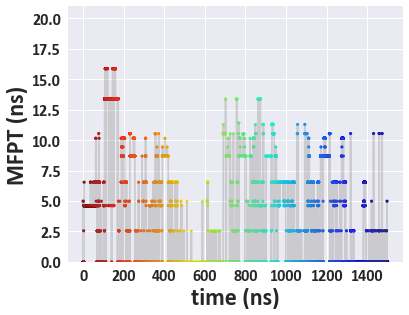

fit19_skip10_chain2


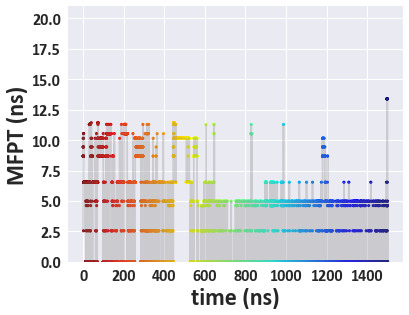

fit19_skip10_chain3


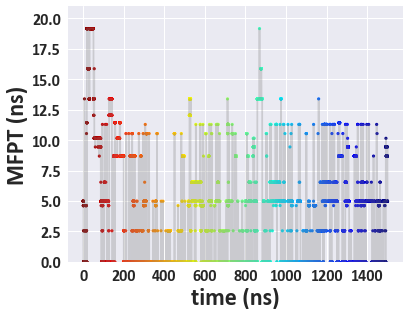

fit19_skip10_chain4


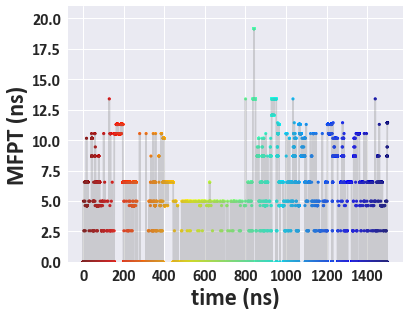

fit19_skip10_chain5


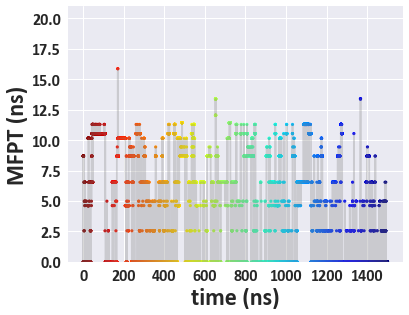

fit19_skip10_chain6


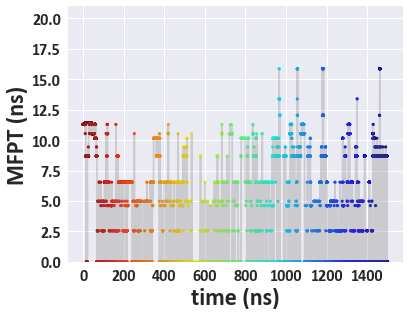

fit19_skip10_chain7


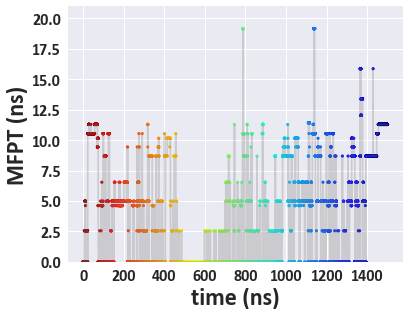

fit19_skip10_chain8


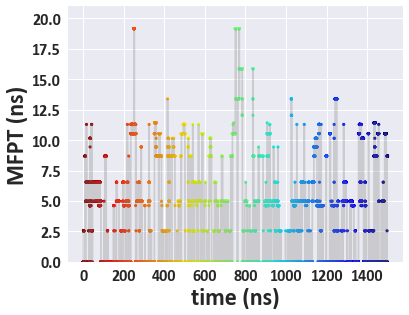

fit19_skip10_chain9


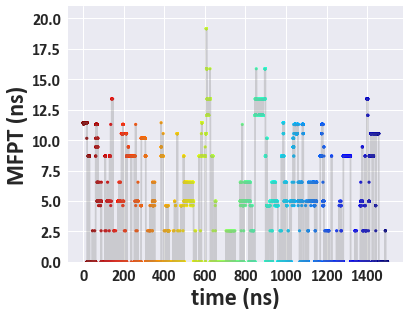

fit19_skip10_chain10


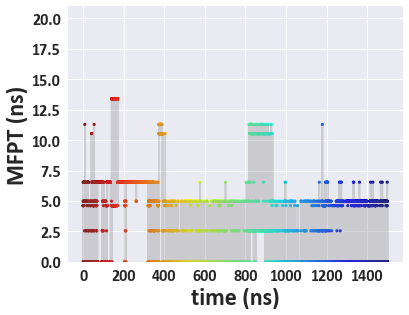

fit19_skip10_chain11


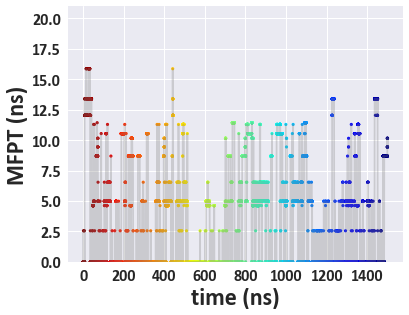

fit19_skip10_chain12


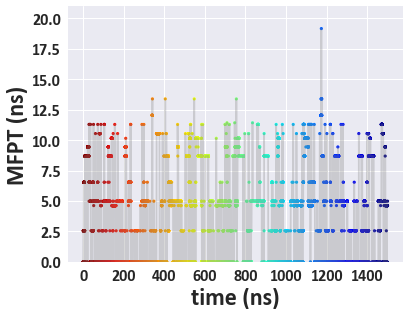

fit20_skip10_chain1


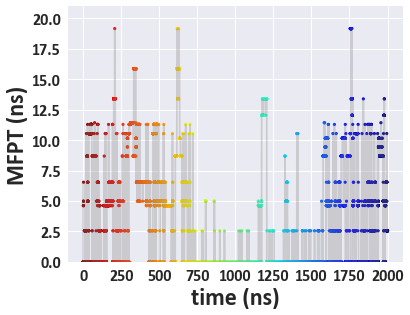

fit20_skip10_chain2


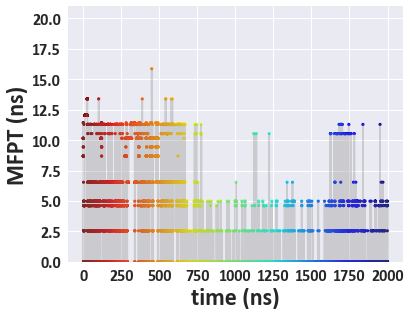

fit20_skip10_chain3


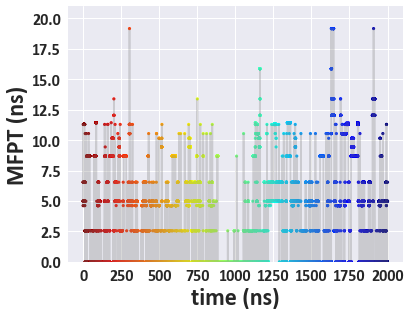

fit20_skip10_chain4


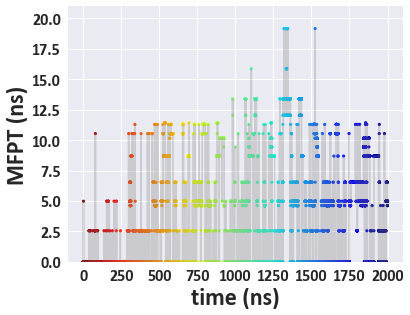

fit20_skip10_chain5


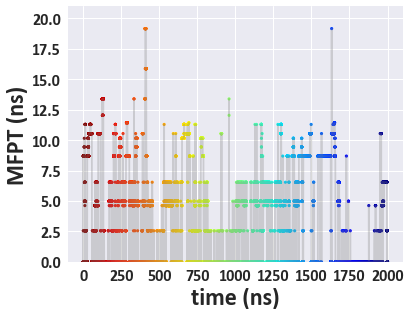

fit20_skip10_chain6


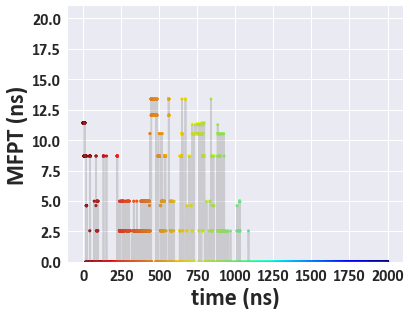

fit20_skip10_chain7


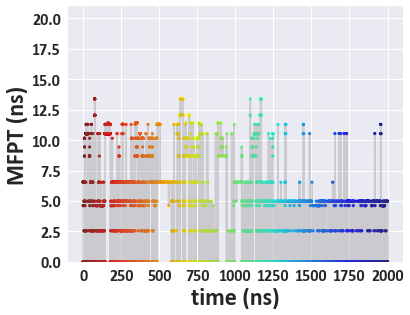

fit20_skip10_chain8


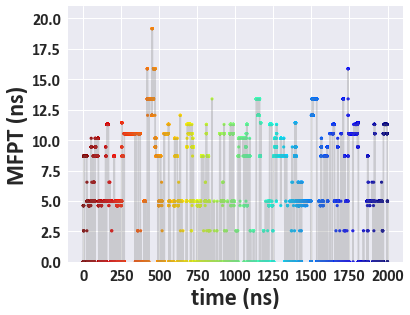

fit20_skip10_chain9


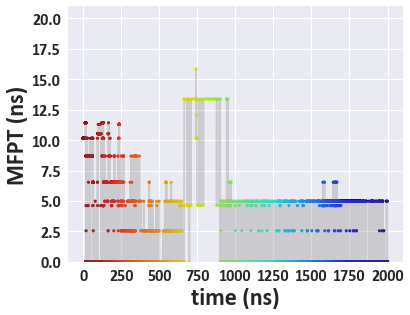

fit20_skip10_chain10


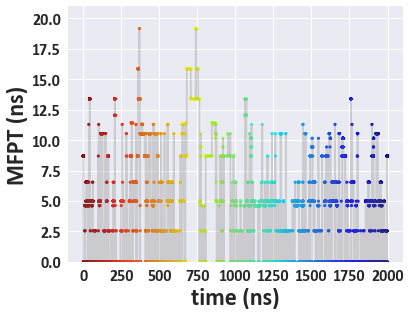

fit20_skip10_chain11


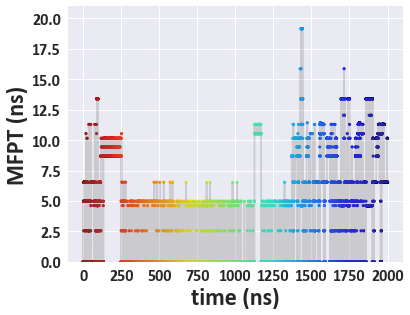

fit20_skip10_chain12


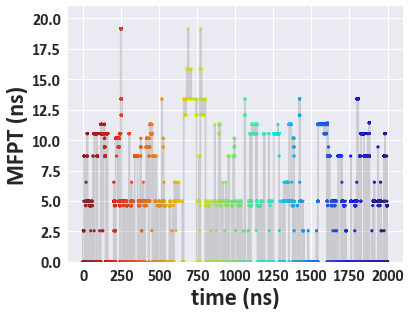

fit21_skip10_chain1


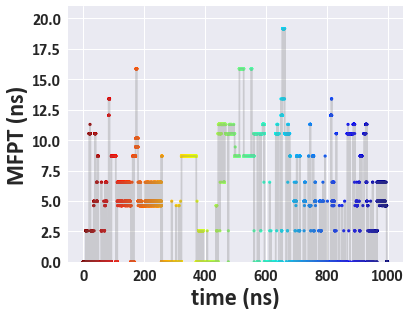

fit21_skip10_chain2


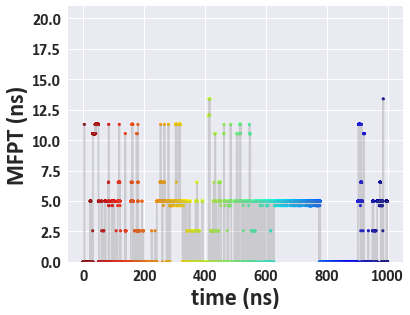

fit21_skip10_chain3


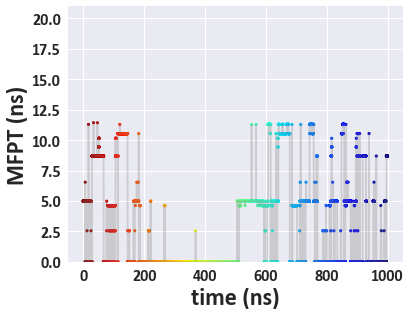

fit21_skip10_chain4


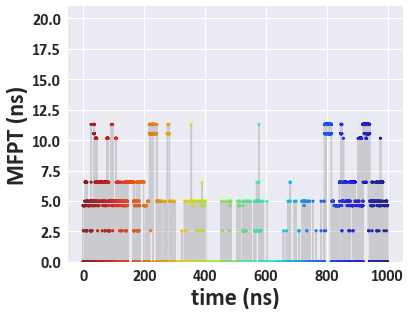

fit21_skip10_chain5


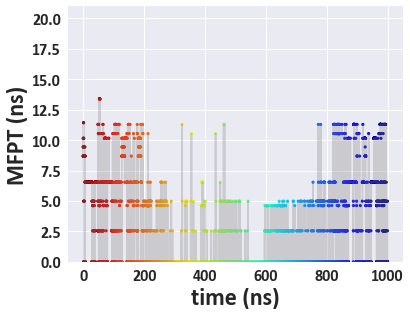

fit21_skip10_chain6


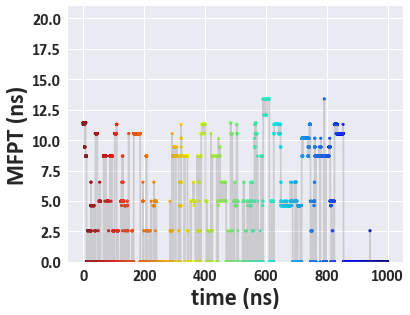

fit21_skip10_chain7


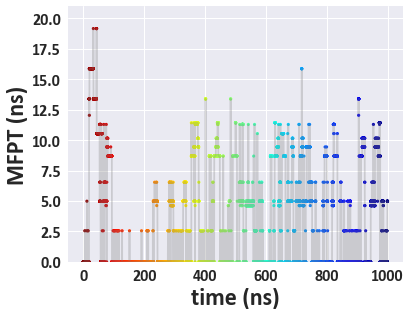

fit21_skip10_chain8


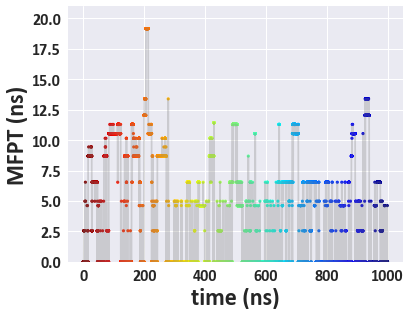

fit21_skip10_chain9


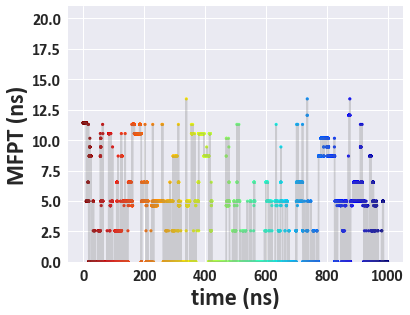

fit21_skip10_chain10


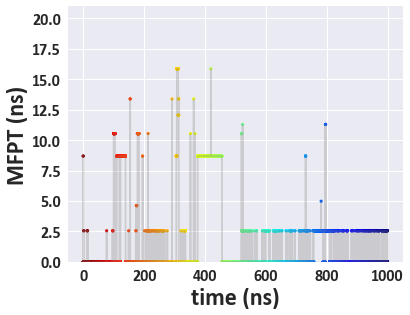

fit21_skip10_chain11


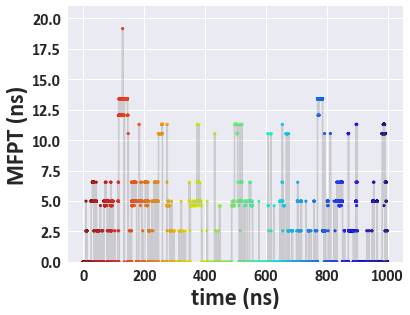

fit21_skip10_chain12


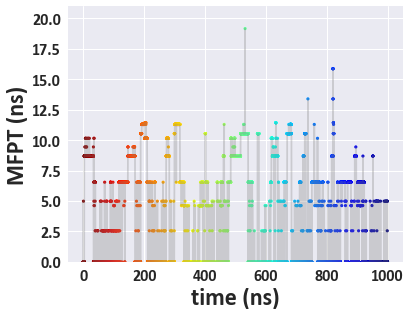

fit22_skip10_chain1


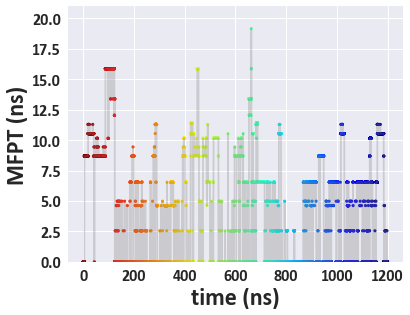

fit22_skip10_chain2


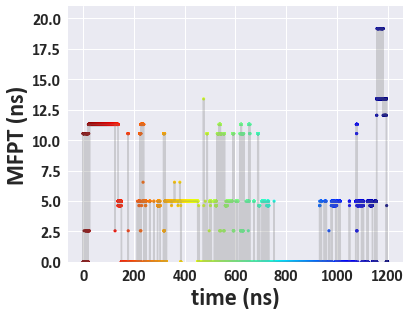

fit22_skip10_chain3


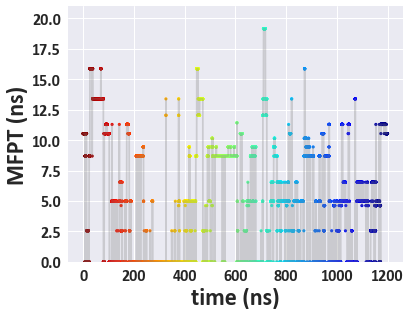

fit22_skip10_chain4


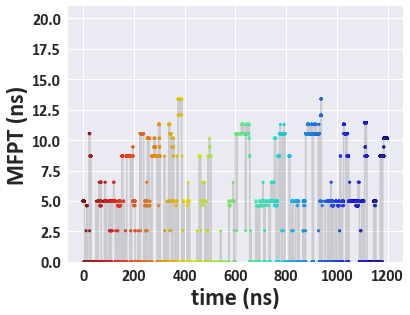

fit22_skip10_chain5


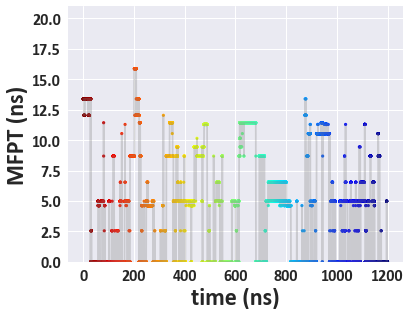

fit22_skip10_chain6


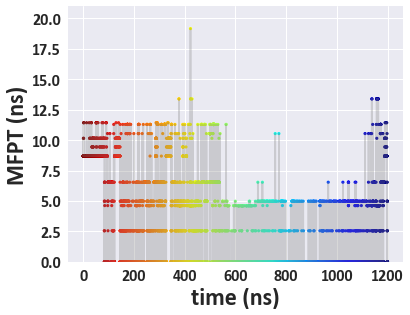

fit22_skip10_chain7


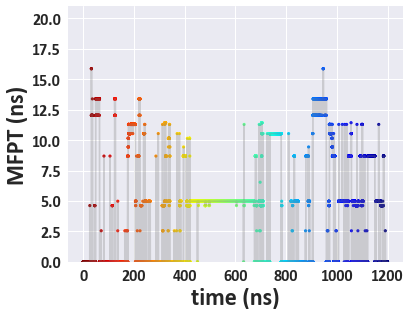

fit22_skip10_chain8


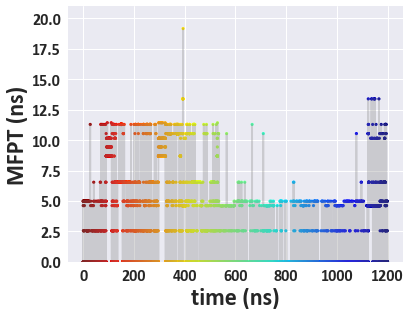

fit22_skip10_chain9


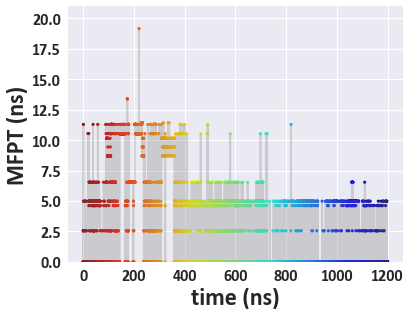

fit22_skip10_chain10


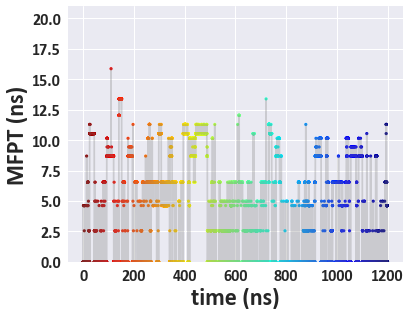

fit22_skip10_chain11


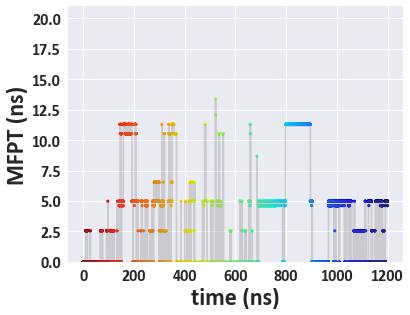

fit22_skip10_chain12


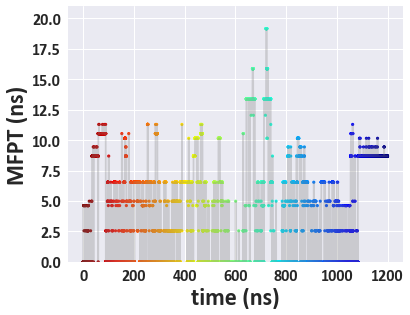

fit23_skip10_chain1


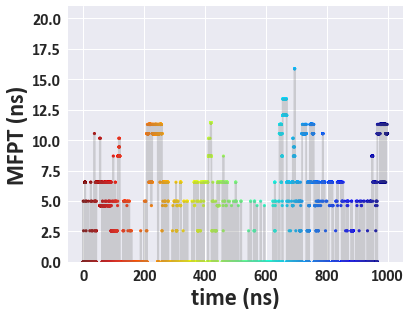

fit23_skip10_chain2


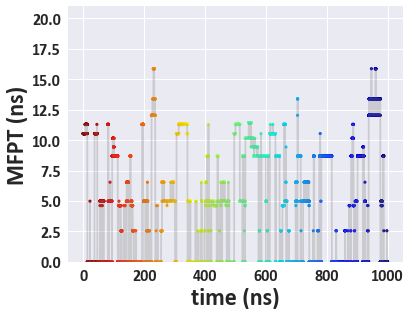

fit23_skip10_chain3


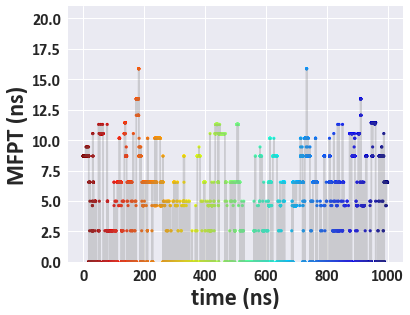

fit23_skip10_chain4


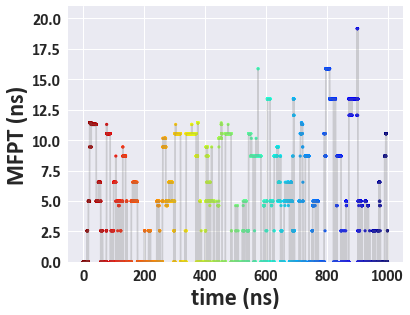

fit23_skip10_chain5


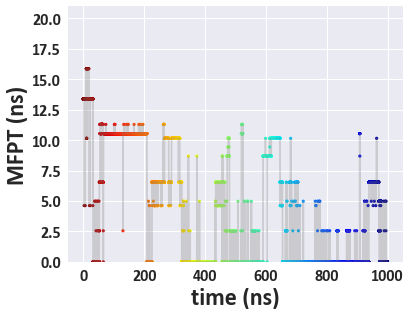

fit23_skip10_chain6


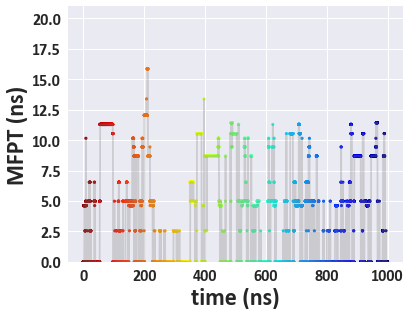

fit23_skip10_chain7


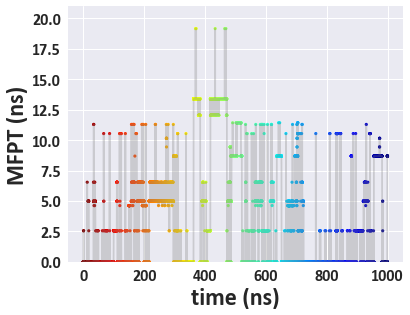

fit23_skip10_chain8


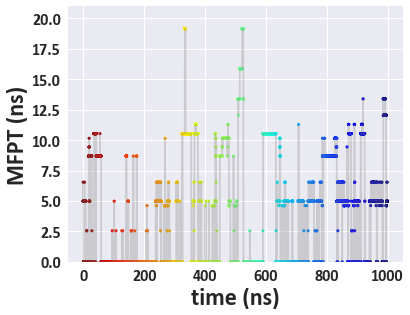

fit23_skip10_chain9


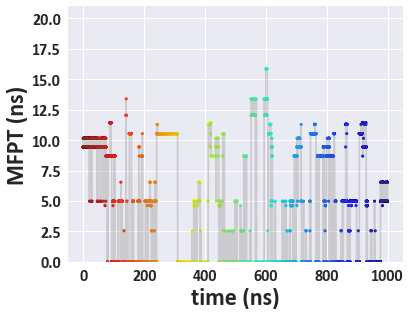

fit23_skip10_chain10


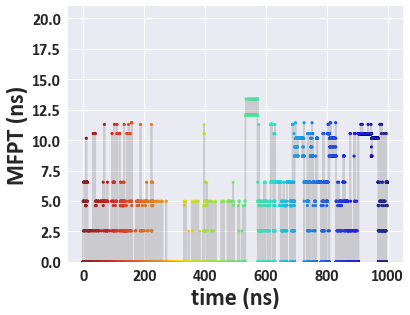

fit23_skip10_chain11


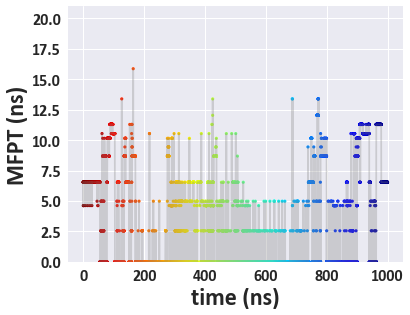

fit23_skip10_chain12


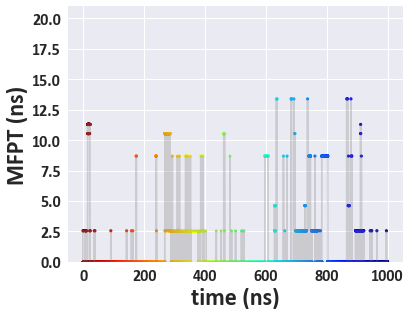

fit24_skip10_chain1


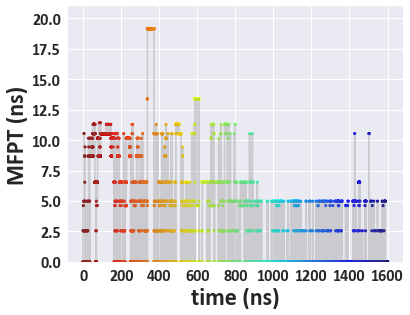

fit24_skip10_chain2


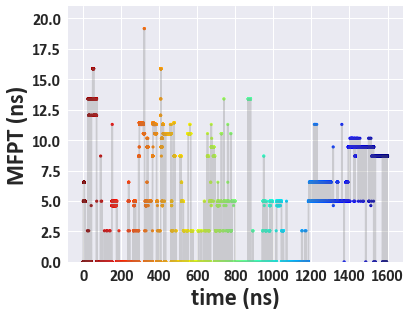

fit24_skip10_chain3


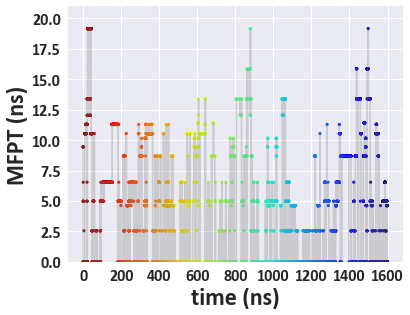

fit24_skip10_chain4


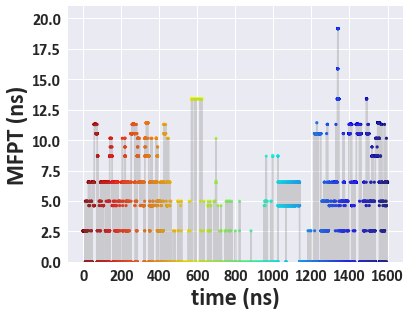

fit24_skip10_chain5


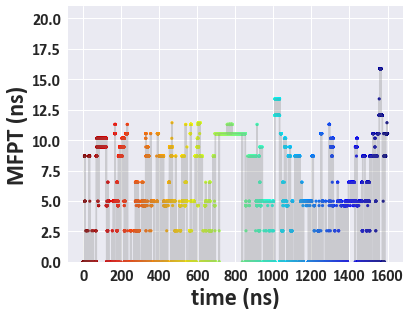

fit24_skip10_chain6


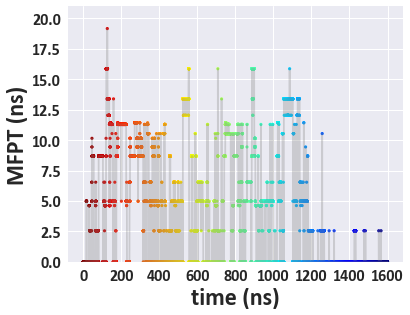

fit24_skip10_chain7


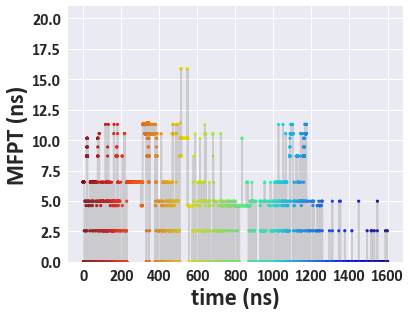

fit24_skip10_chain8


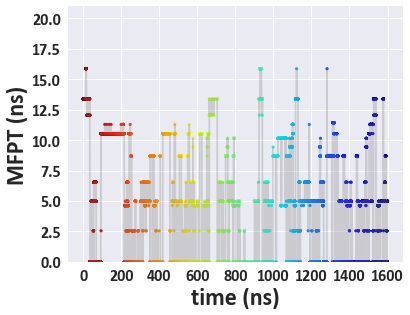

fit24_skip10_chain9


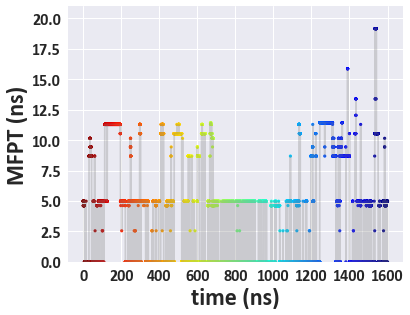

fit24_skip10_chain10


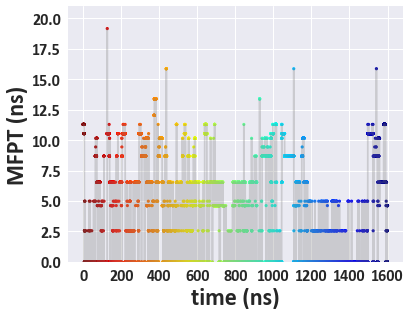

fit24_skip10_chain11


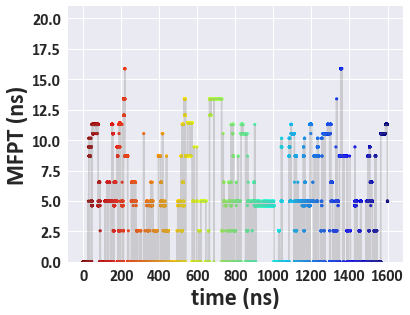

fit24_skip10_chain12


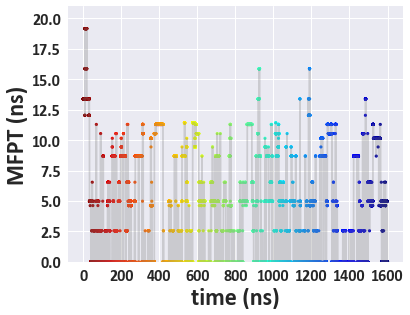

fit25_skip10_chain1


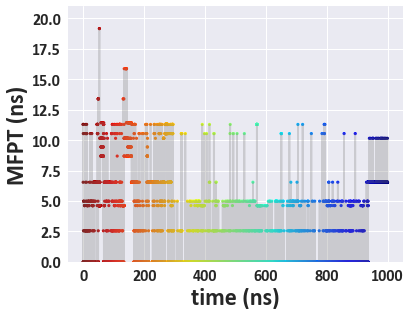

fit25_skip10_chain2


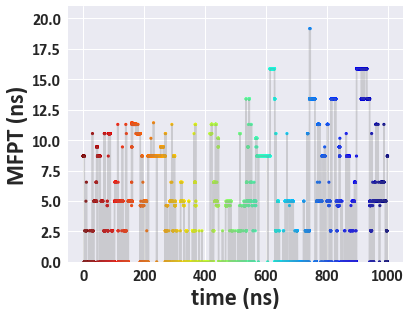

fit25_skip10_chain3


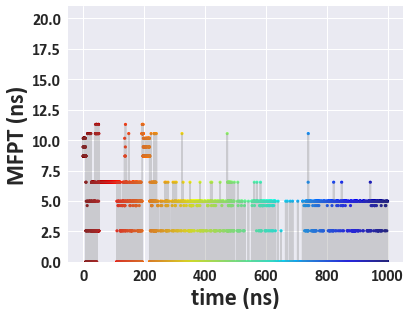

fit25_skip10_chain4


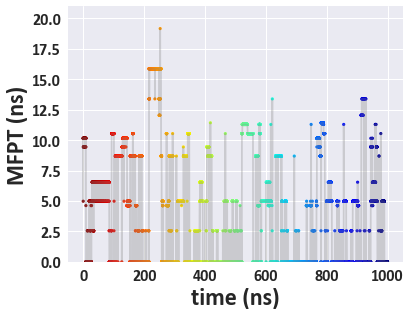

fit25_skip10_chain5


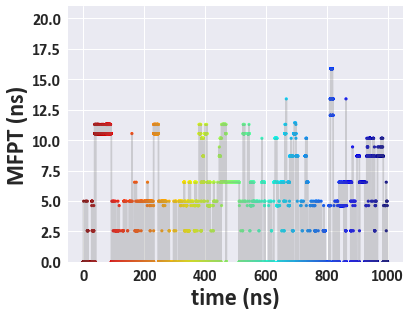

fit25_skip10_chain6


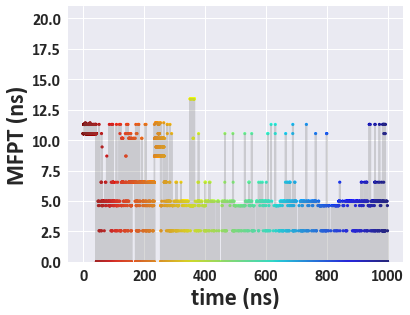

fit25_skip10_chain7


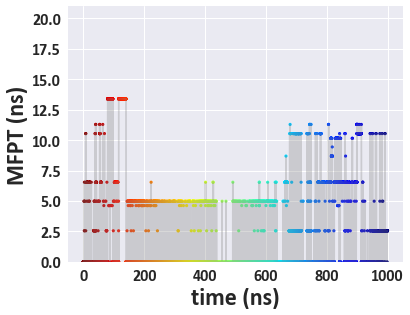

fit25_skip10_chain8


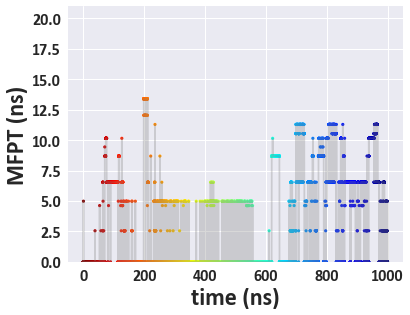

fit25_skip10_chain9


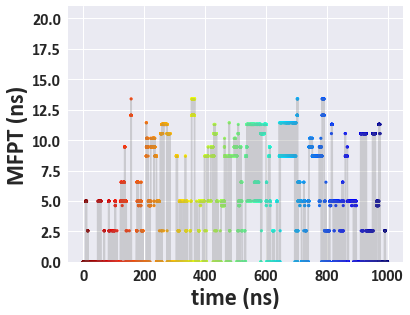

fit25_skip10_chain10


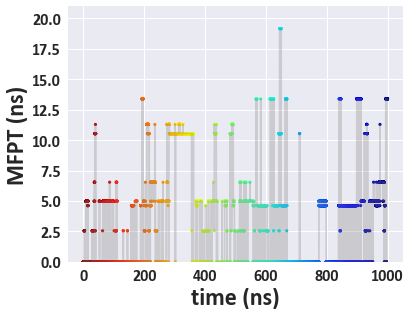

fit25_skip10_chain11


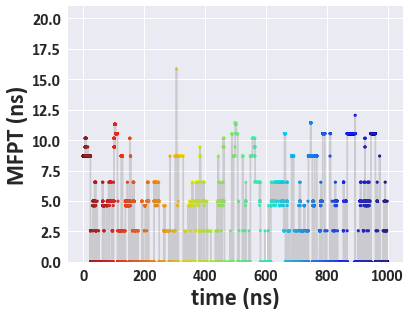

fit25_skip10_chain12


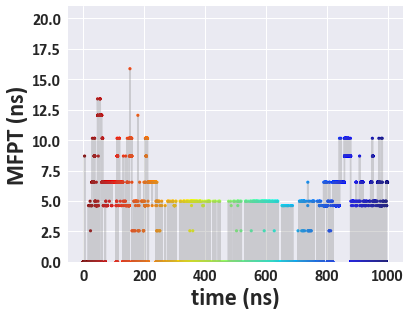

fit26_skip10_chain1


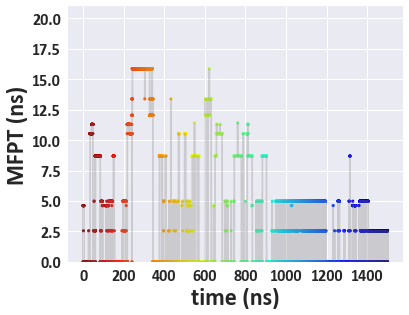

fit26_skip10_chain2


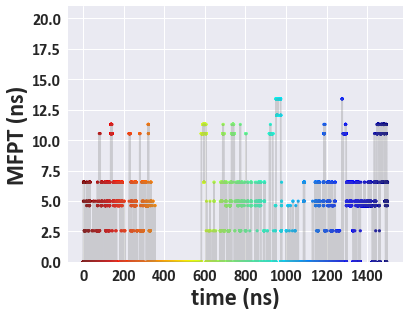

fit26_skip10_chain3


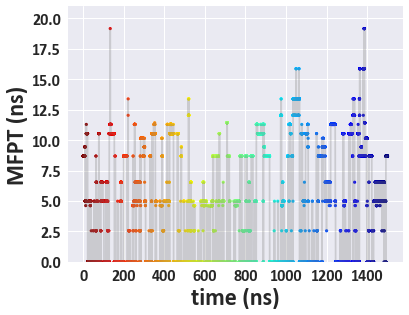

fit26_skip10_chain4


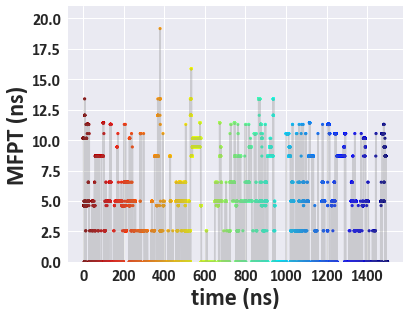

fit26_skip10_chain5


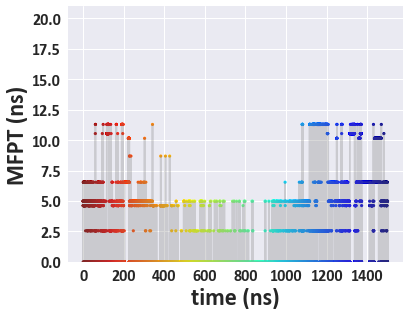

fit26_skip10_chain6


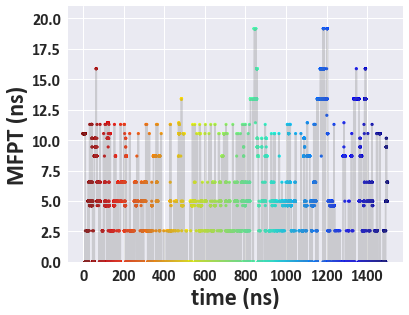

fit26_skip10_chain7


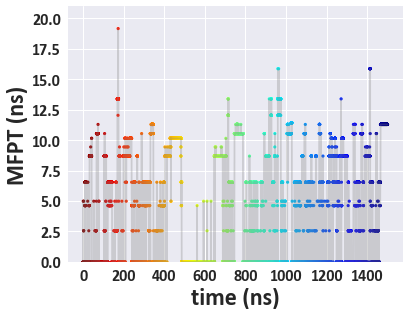

fit26_skip10_chain8


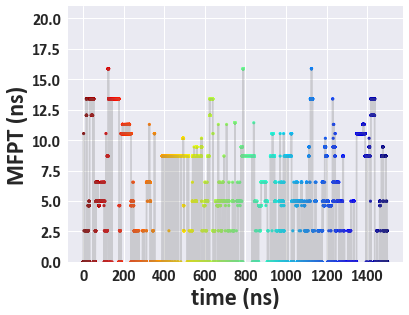

fit26_skip10_chain9


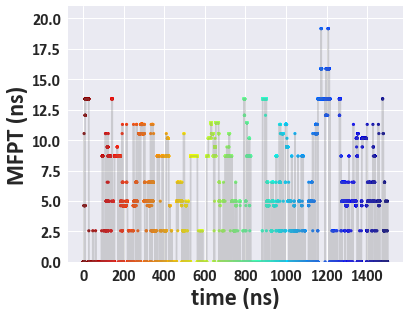

fit26_skip10_chain10


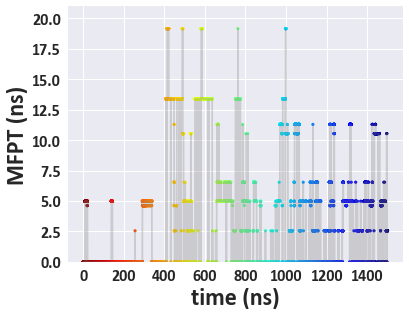

fit26_skip10_chain11


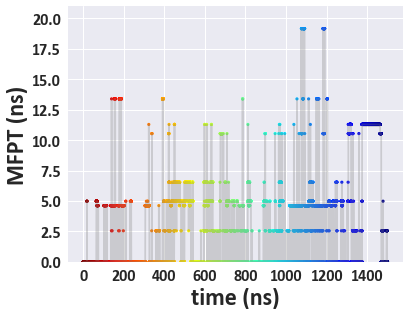

fit26_skip10_chain12


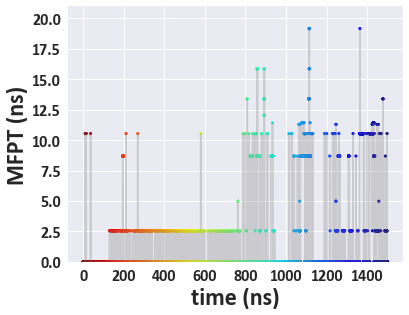

fit27_skip10_chain1


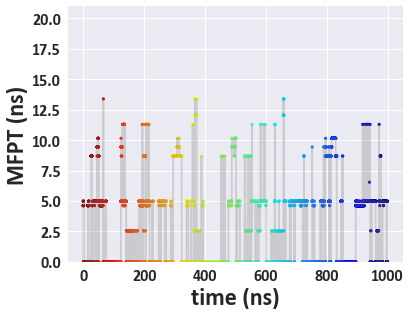

fit27_skip10_chain2


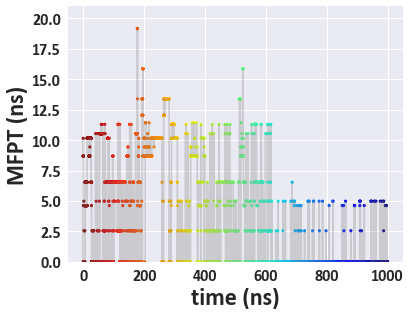

fit27_skip10_chain3


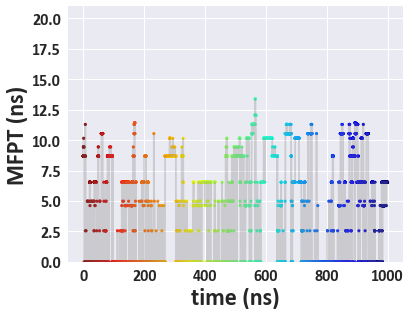

fit27_skip10_chain4


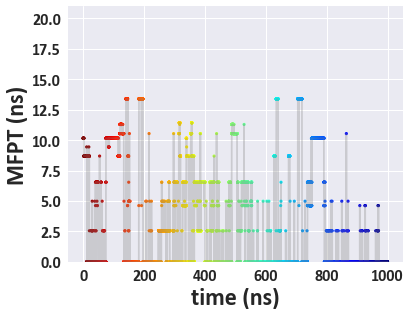

fit27_skip10_chain5


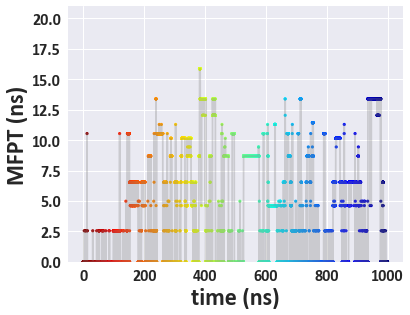

fit27_skip10_chain6


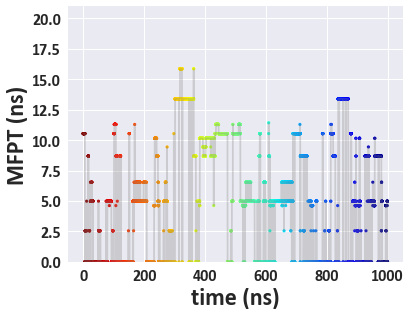

fit27_skip10_chain7


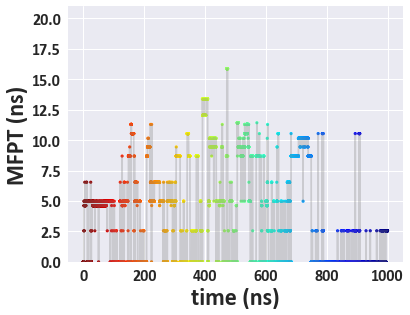

fit27_skip10_chain8


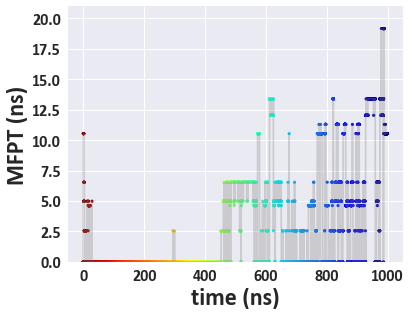

fit27_skip10_chain9


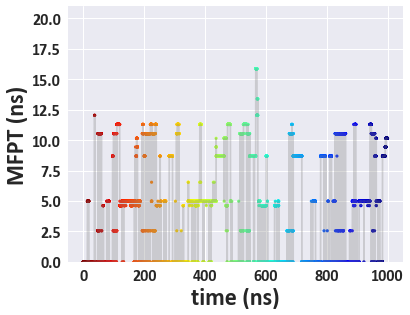

fit27_skip10_chain10


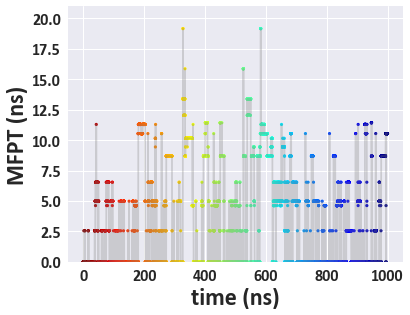

fit27_skip10_chain11


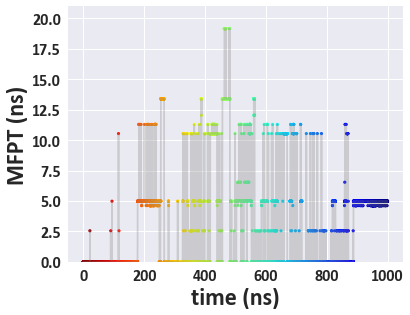

fit27_skip10_chain12


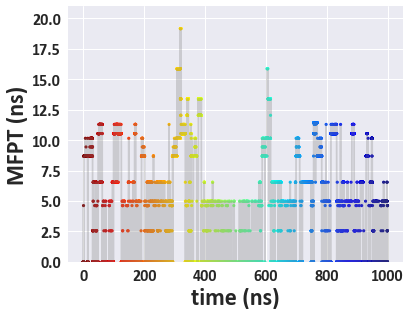

fit28_skip10_chain1


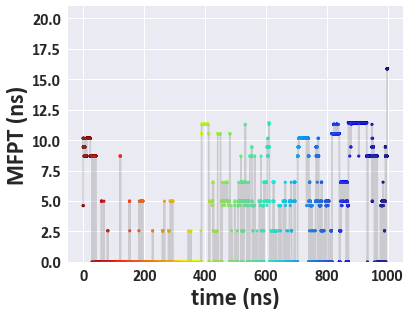

fit28_skip10_chain2


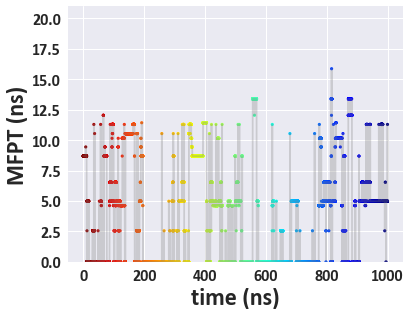

fit28_skip10_chain3


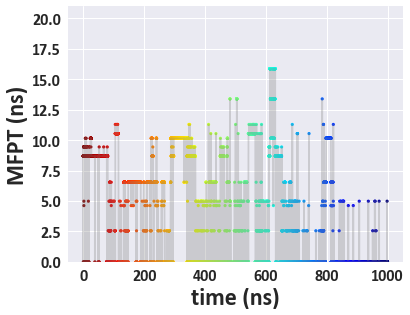

fit28_skip10_chain4


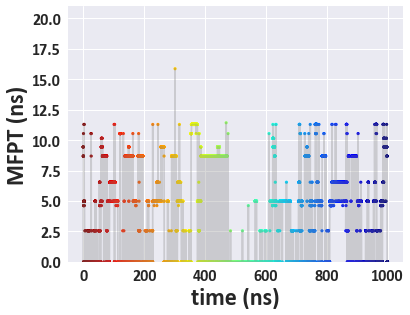

fit28_skip10_chain5


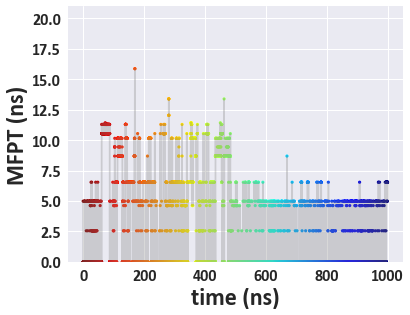

fit28_skip10_chain6


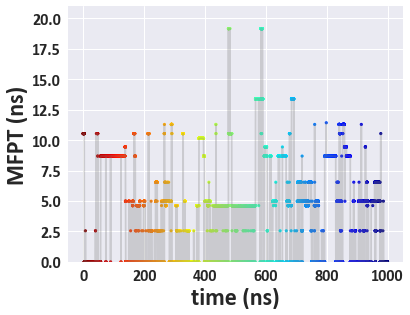

fit28_skip10_chain7


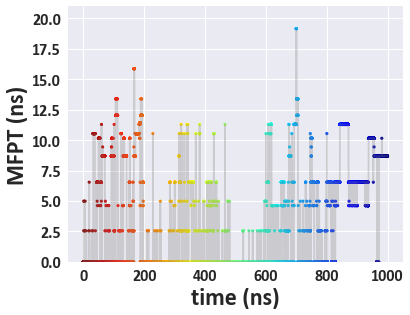

fit28_skip10_chain8


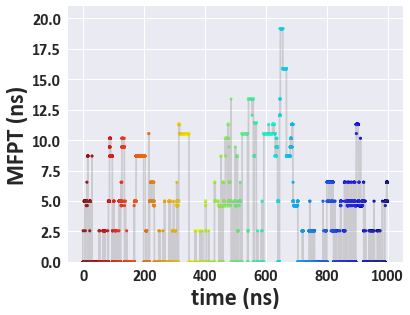

fit28_skip10_chain9


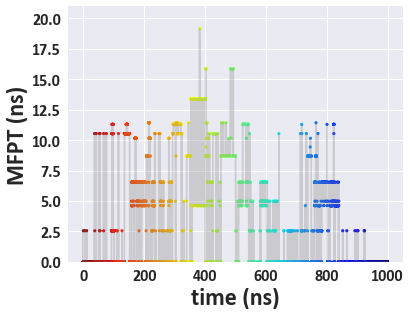

fit28_skip10_chain10


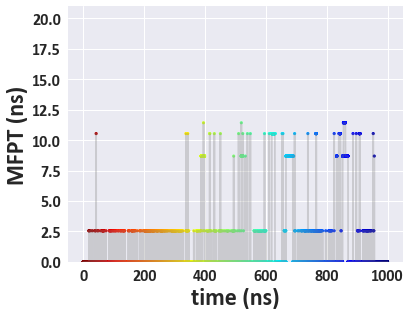

fit28_skip10_chain11


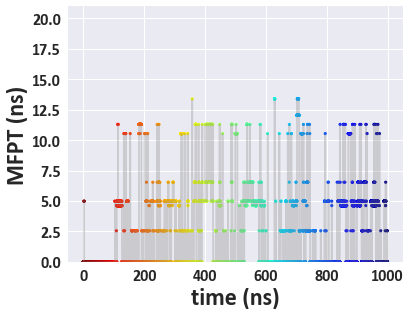

fit28_skip10_chain12


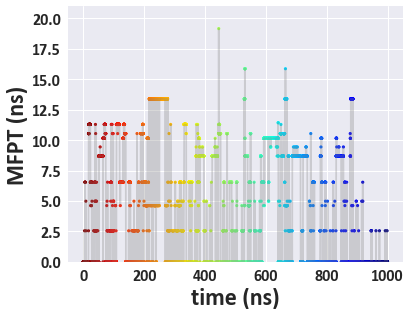

fit29_skip10_chain1


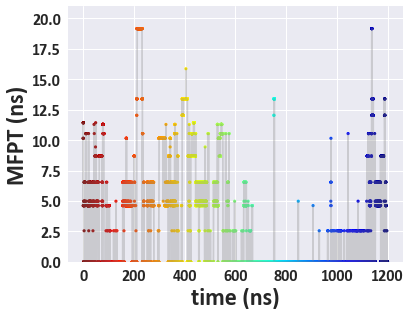

fit29_skip10_chain2


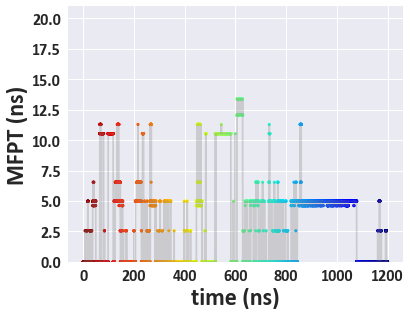

fit29_skip10_chain3


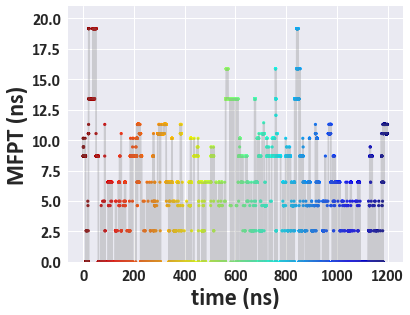

fit29_skip10_chain4


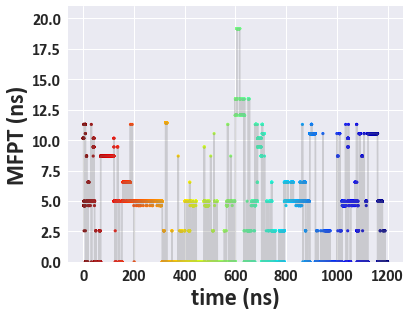

fit29_skip10_chain5


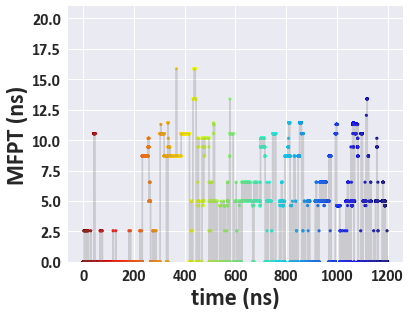

fit29_skip10_chain6


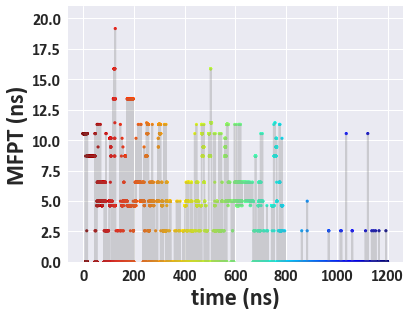

fit29_skip10_chain7


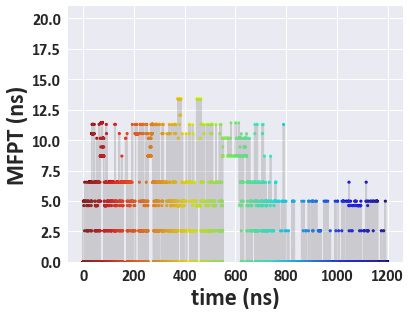

fit29_skip10_chain8


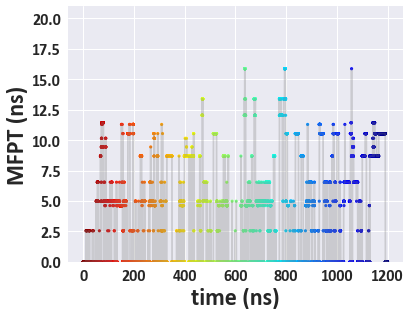

fit29_skip10_chain9


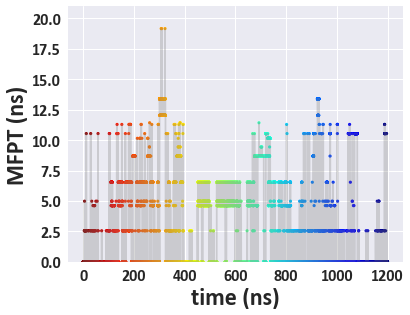

fit29_skip10_chain10


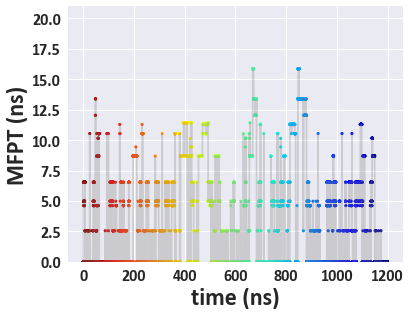

fit29_skip10_chain11


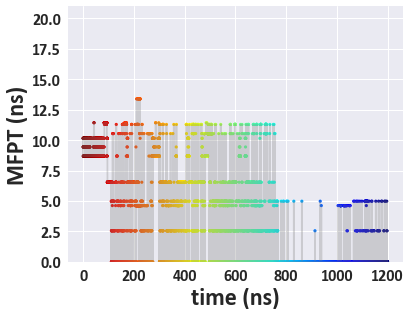

fit29_skip10_chain12


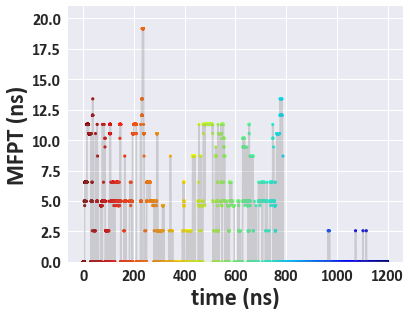

fit30_skip10_chain1


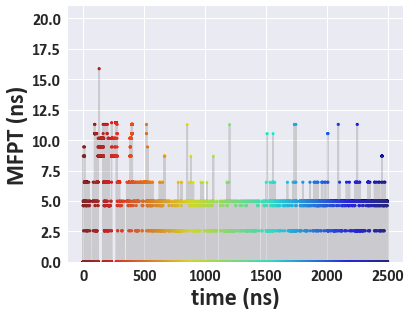

fit30_skip10_chain2


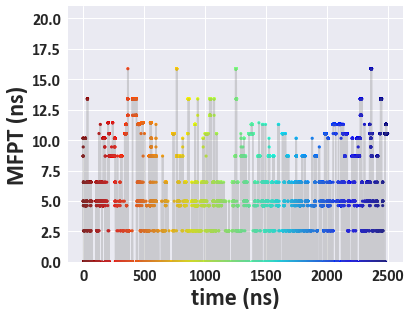

fit30_skip10_chain3


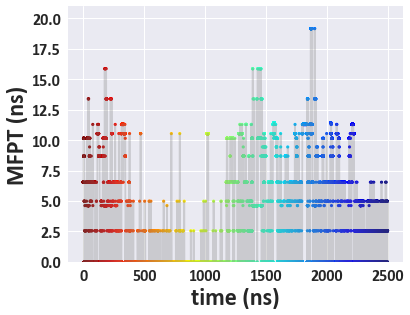

fit30_skip10_chain4


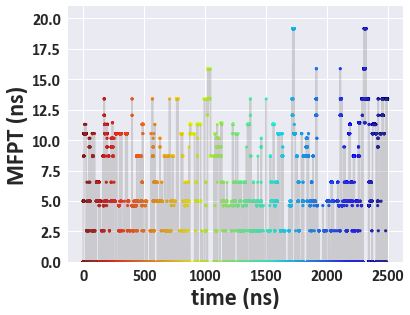

fit30_skip10_chain5


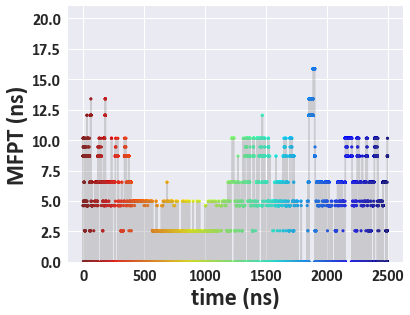

fit30_skip10_chain6


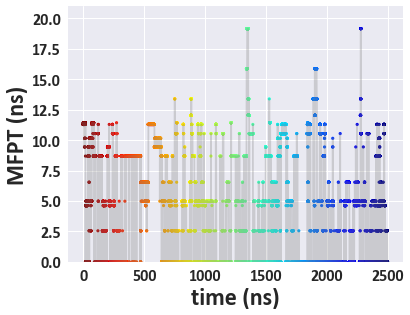

fit30_skip10_chain7


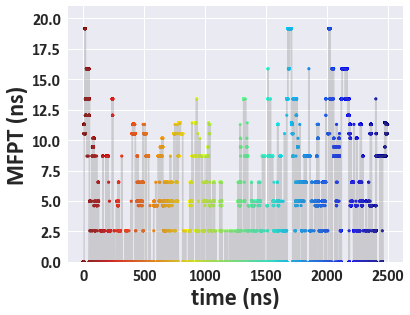

fit30_skip10_chain8


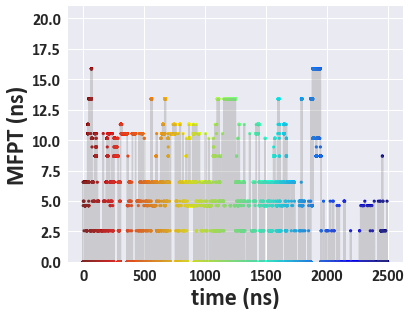

fit30_skip10_chain9


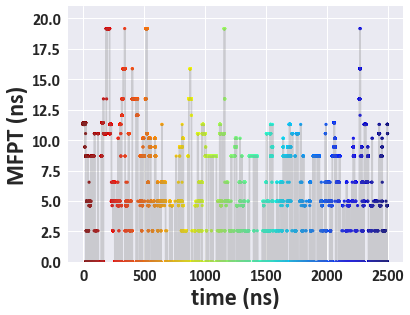

fit30_skip10_chain10


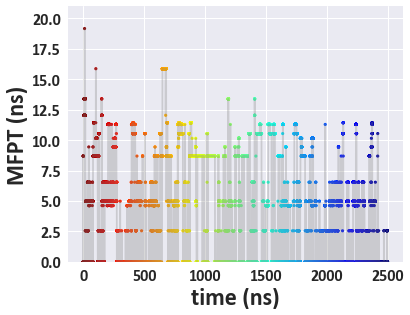

fit30_skip10_chain11


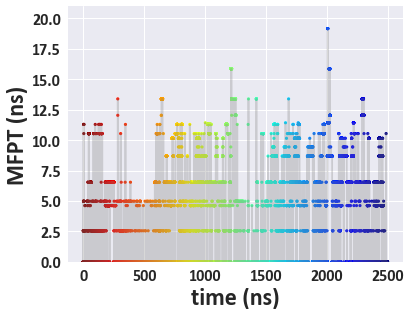

fit30_skip10_chain12


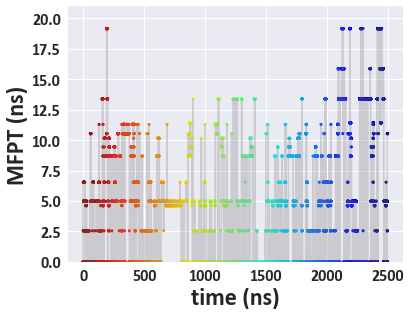

fit31_skip10_chain1


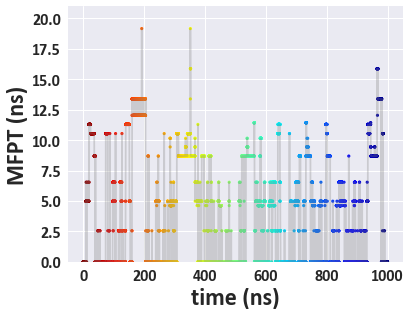

fit31_skip10_chain2


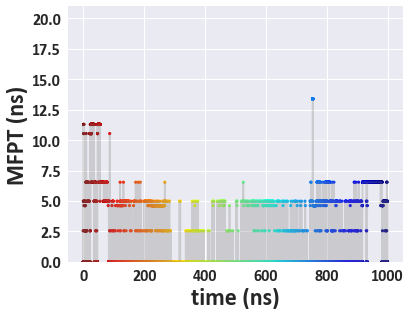

fit31_skip10_chain3


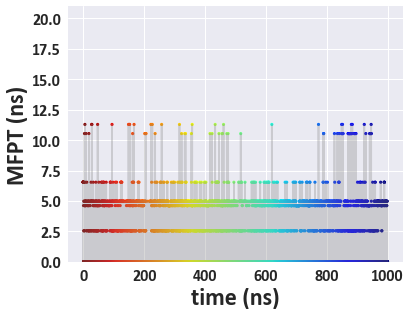

fit31_skip10_chain4


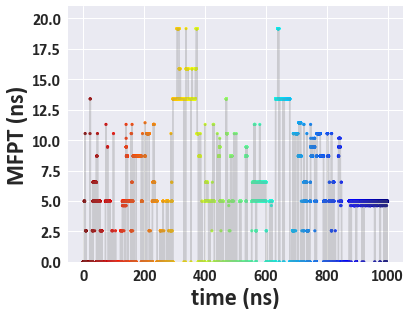

fit31_skip10_chain5


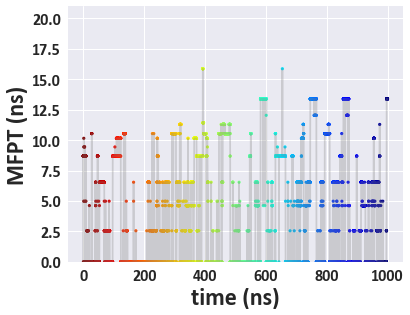

fit31_skip10_chain6


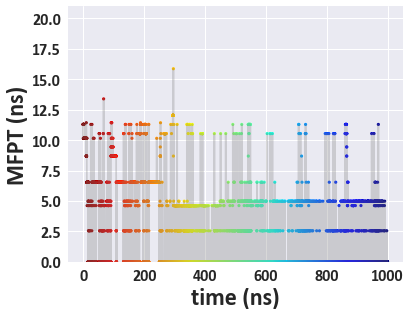

fit31_skip10_chain7


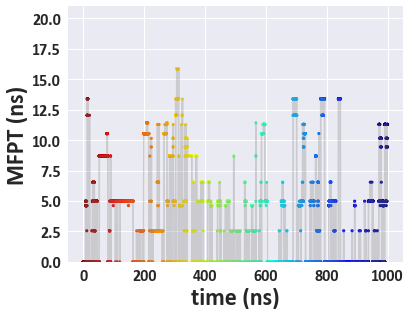

fit31_skip10_chain8


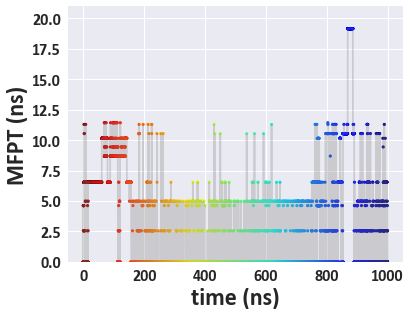

fit31_skip10_chain9


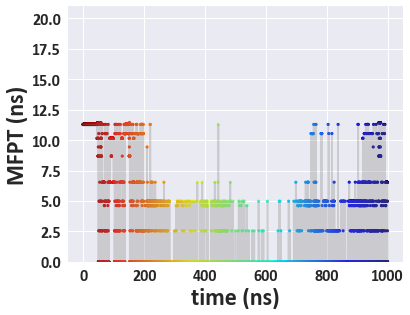

fit31_skip10_chain10


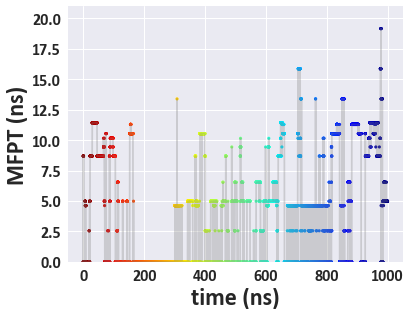

fit31_skip10_chain11


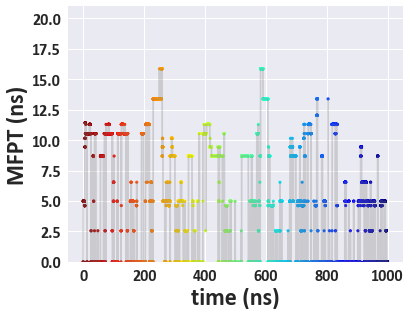

fit31_skip10_chain12


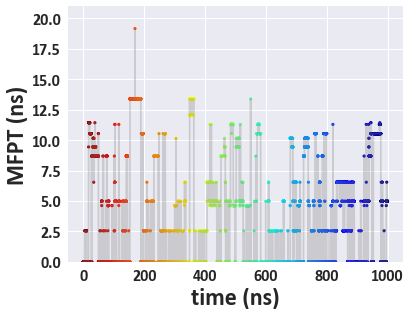

fit32_skip10_chain1


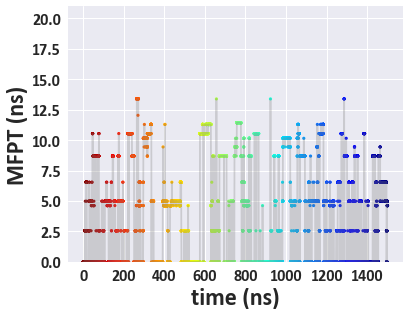

fit32_skip10_chain2


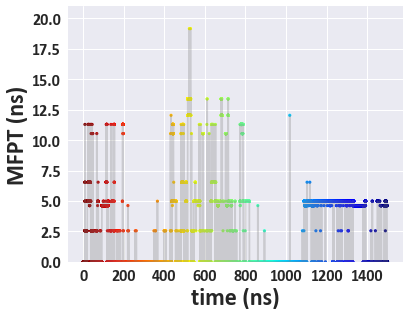

fit32_skip10_chain3


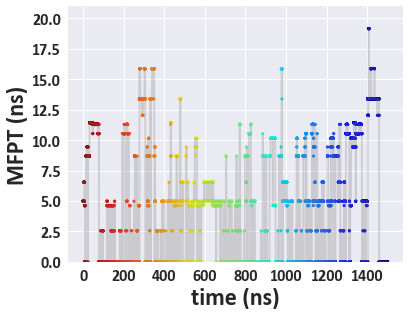

fit32_skip10_chain4


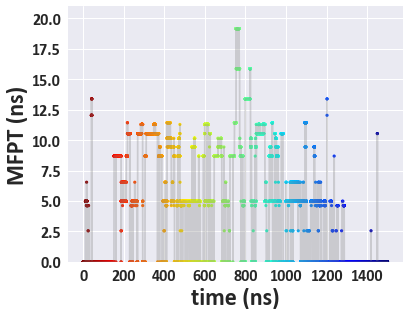

fit32_skip10_chain5


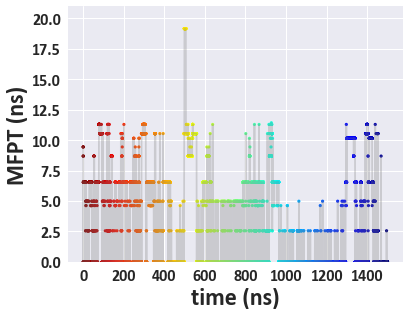

fit32_skip10_chain6


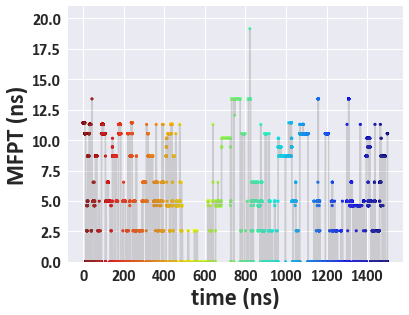

fit32_skip10_chain7


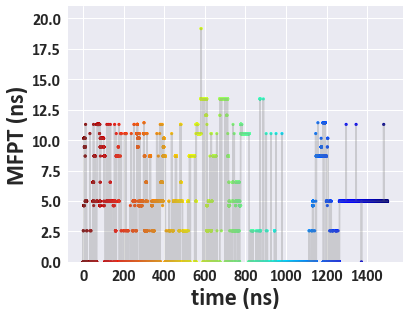

fit32_skip10_chain8


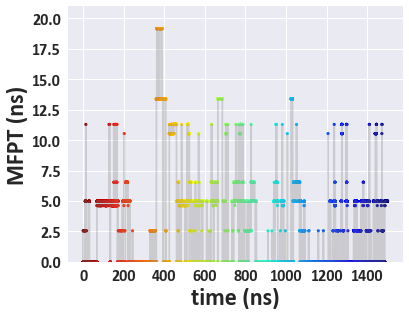

fit32_skip10_chain9


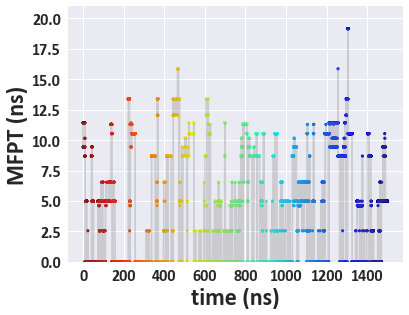

fit32_skip10_chain10


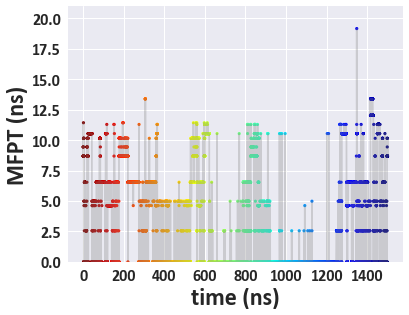

fit32_skip10_chain11


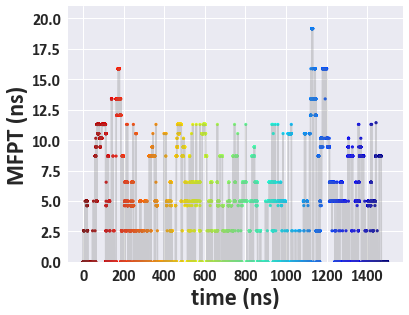

fit32_skip10_chain12


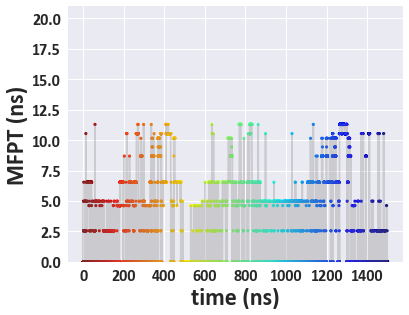

fit33_skip10_chain1


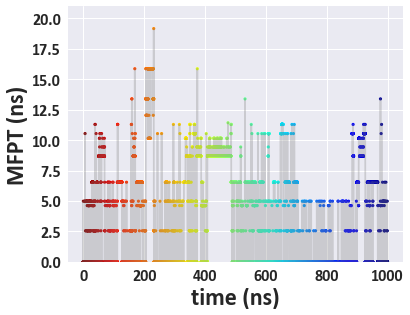

fit33_skip10_chain2


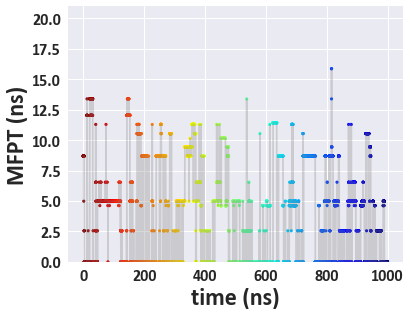

fit33_skip10_chain3


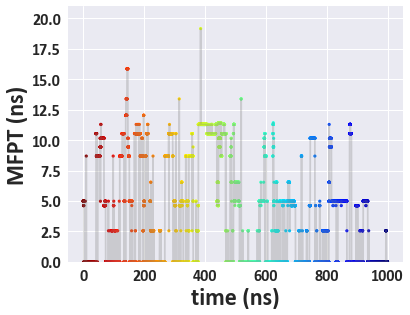

fit33_skip10_chain4


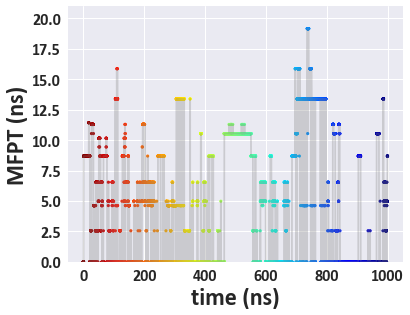

fit33_skip10_chain5


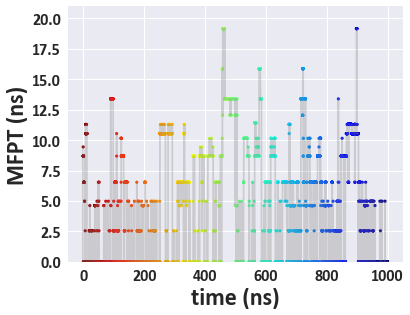

fit33_skip10_chain6


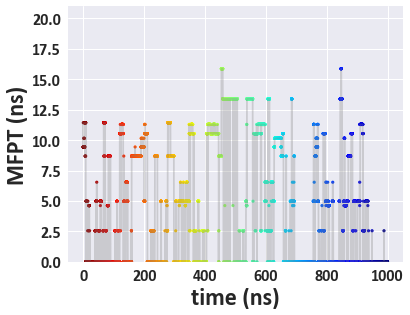

fit33_skip10_chain7


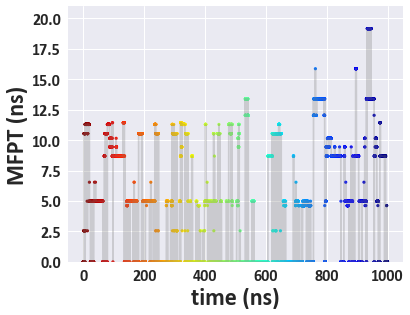

fit33_skip10_chain8


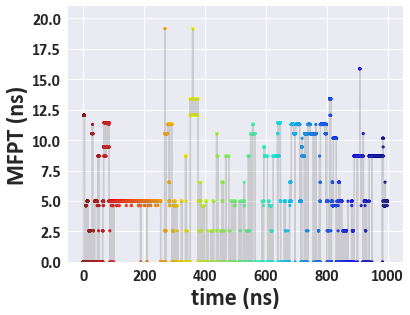

fit33_skip10_chain9


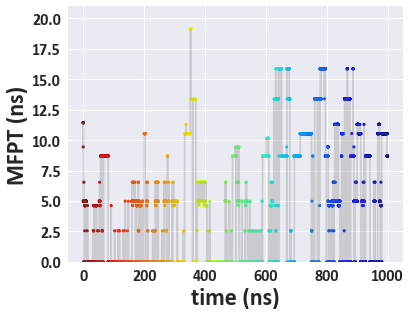

fit33_skip10_chain10


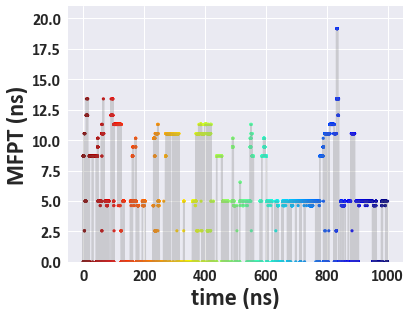

fit33_skip10_chain11


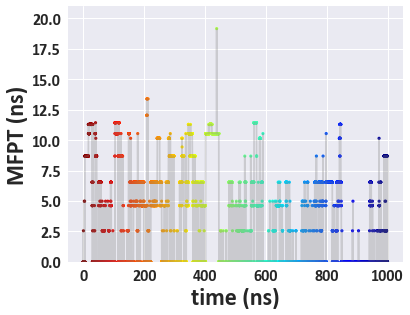

fit33_skip10_chain12


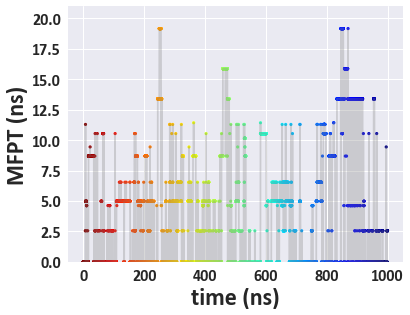

fit34_skip10_chain1


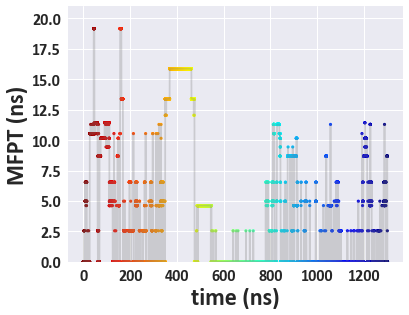

fit34_skip10_chain2


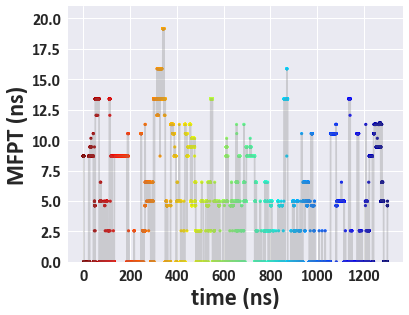

fit34_skip10_chain3


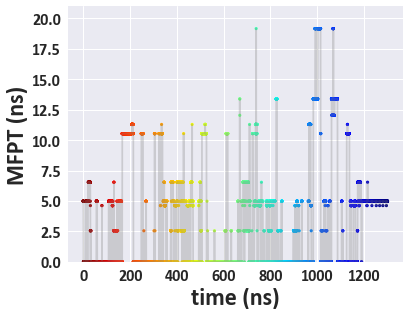

fit34_skip10_chain4


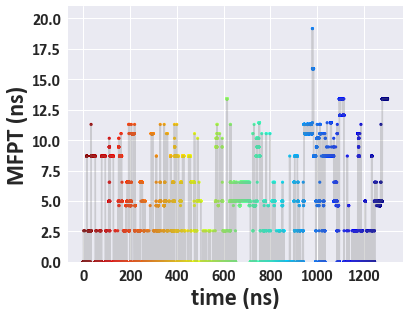

fit34_skip10_chain5


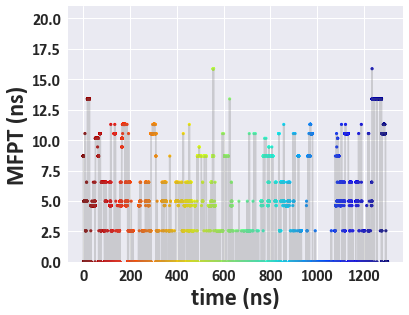

fit34_skip10_chain6


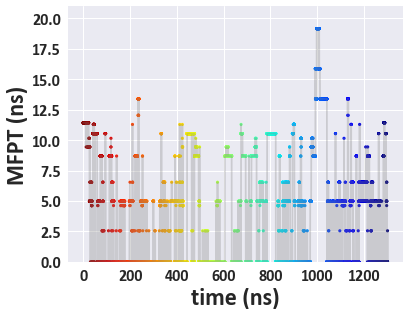

fit34_skip10_chain7


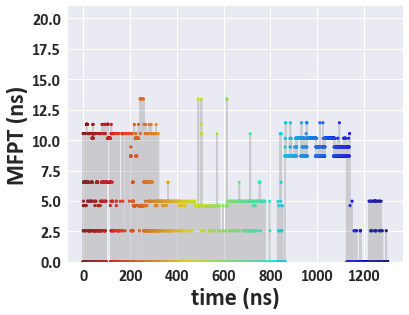

fit34_skip10_chain8


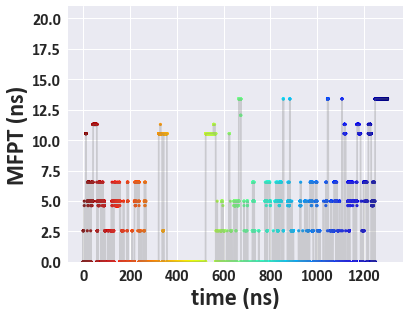

fit34_skip10_chain9


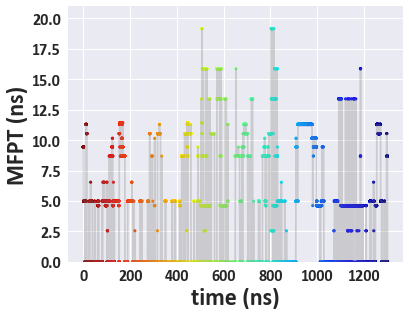

fit34_skip10_chain10


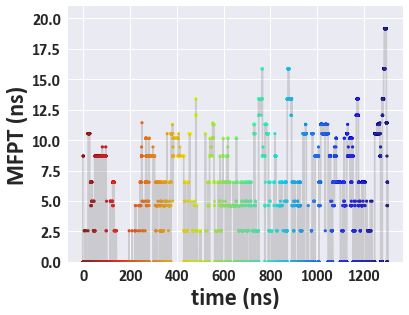

fit34_skip10_chain11


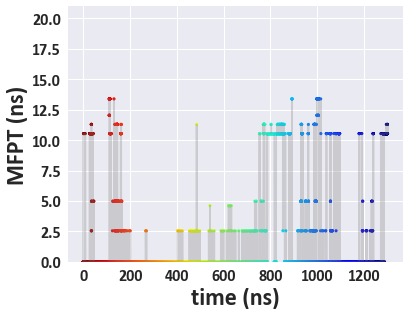

fit34_skip10_chain12


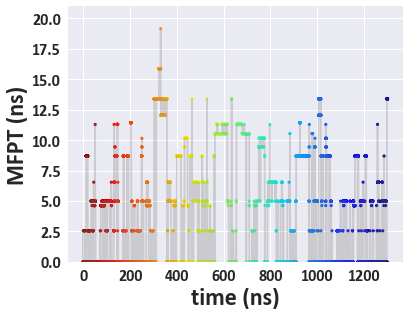

fit35_skip10_chain1


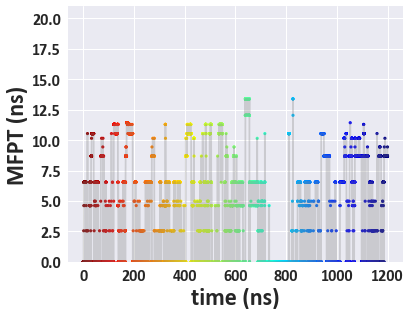

fit35_skip10_chain2


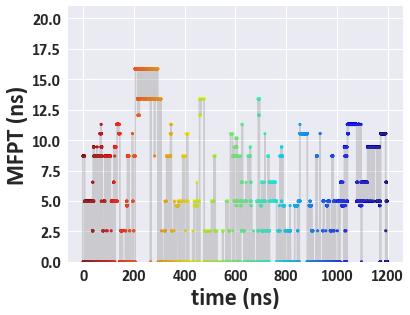

fit35_skip10_chain3


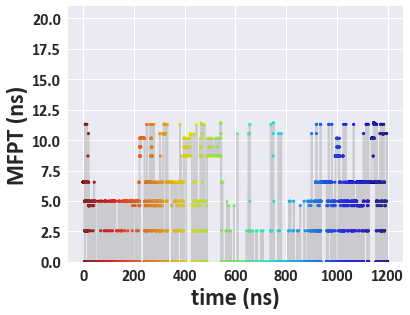

fit35_skip10_chain4


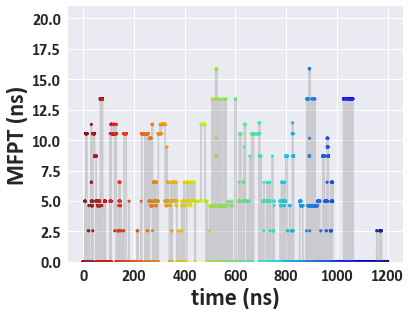

fit35_skip10_chain5


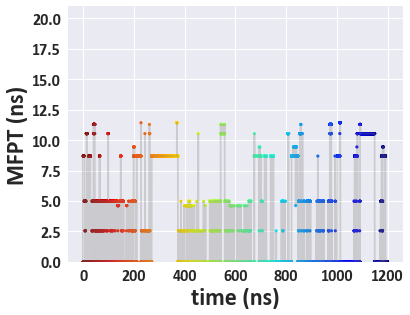

fit35_skip10_chain6


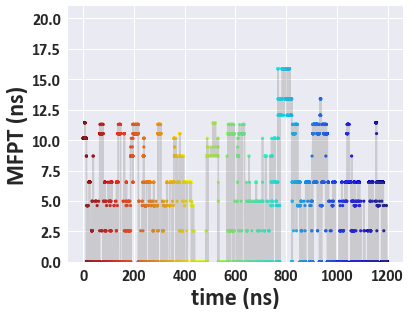

fit35_skip10_chain7


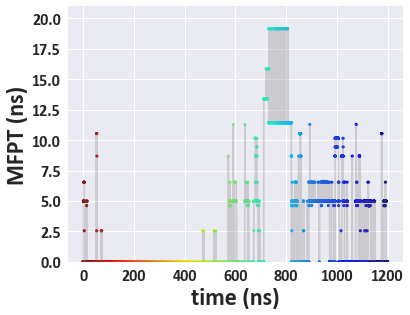

fit35_skip10_chain8


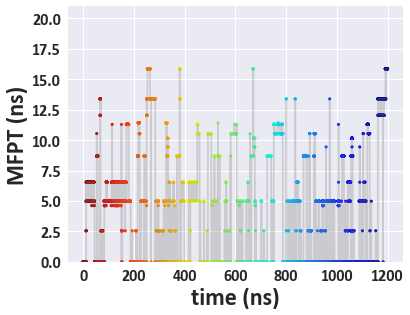

fit35_skip10_chain9


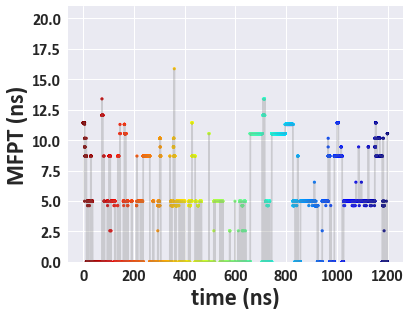

fit35_skip10_chain10


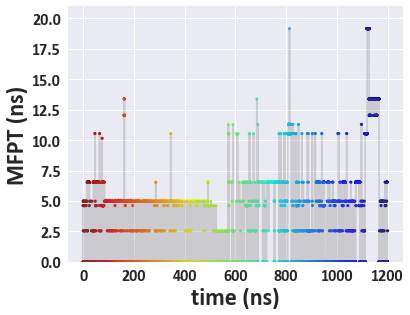

fit35_skip10_chain11


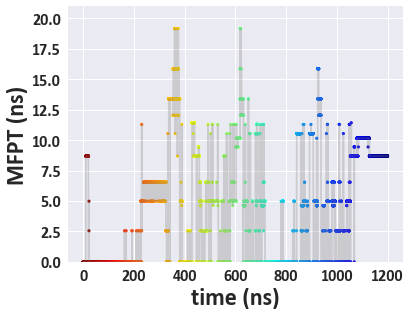

fit35_skip10_chain12


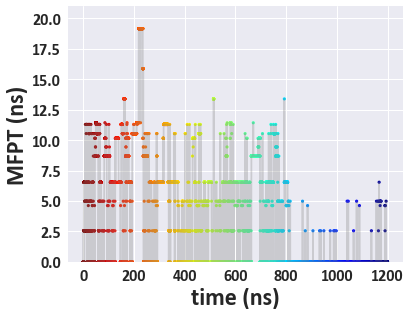

fit36_skip10_chain1


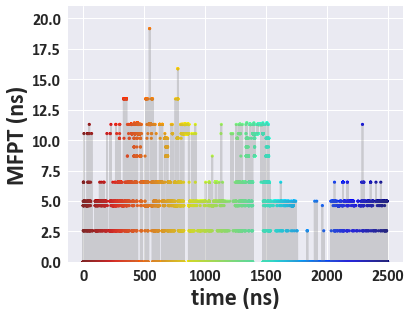

fit36_skip10_chain2


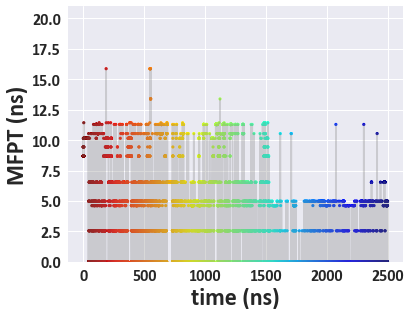

fit36_skip10_chain3


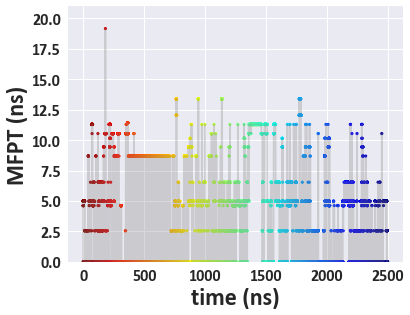

fit36_skip10_chain4


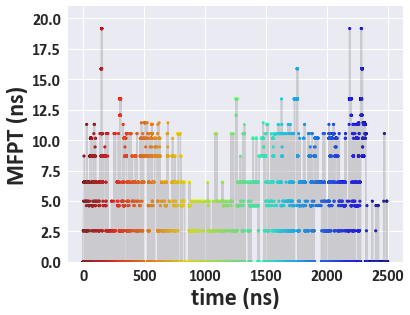

fit36_skip10_chain5


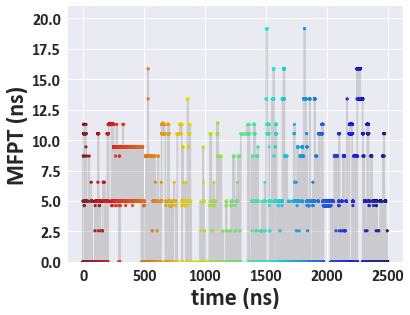

fit36_skip10_chain6


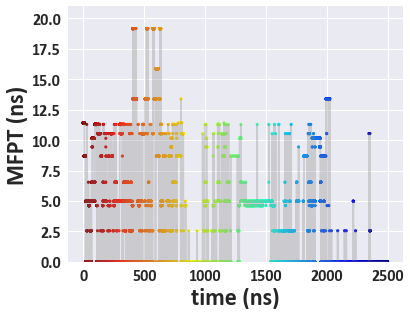

fit36_skip10_chain7


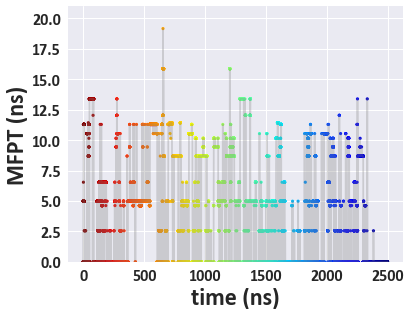

fit36_skip10_chain8


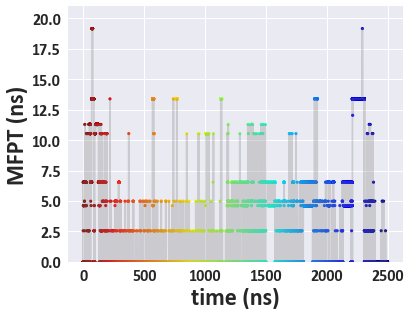

fit36_skip10_chain9


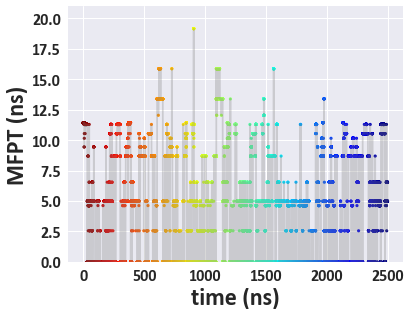

fit36_skip10_chain10


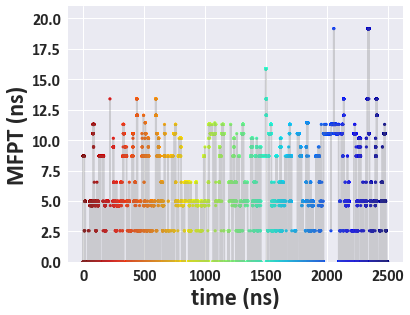

fit36_skip10_chain11


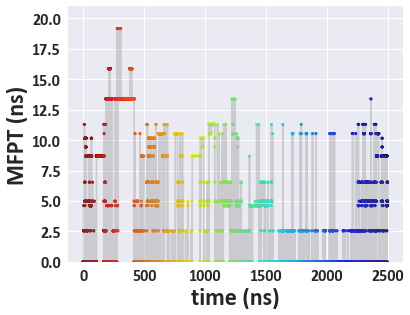

fit36_skip10_chain12


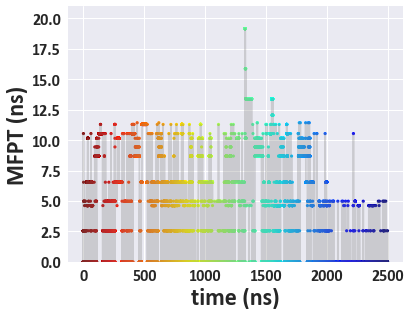

fit37_skip10_chain1


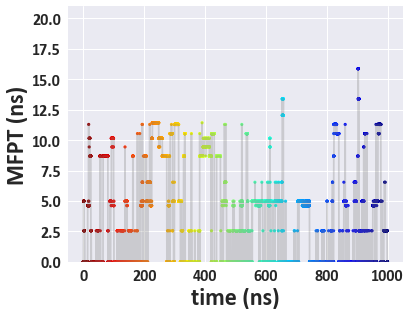

fit37_skip10_chain2


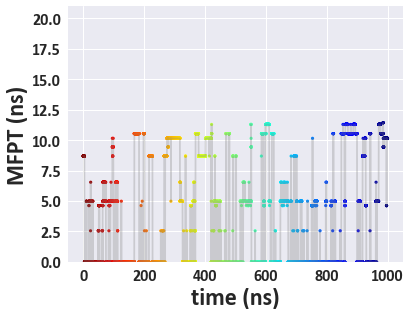

fit37_skip10_chain3


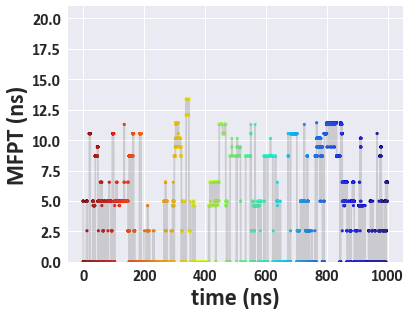

fit37_skip10_chain4


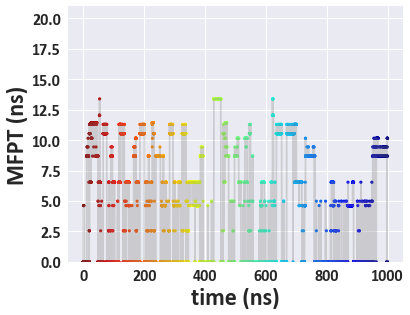

fit37_skip10_chain5


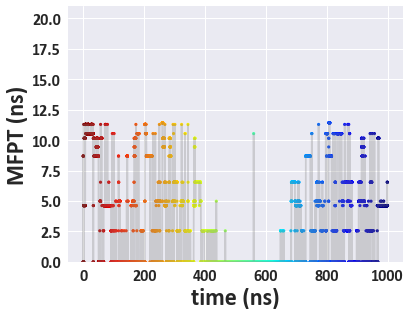

fit37_skip10_chain6


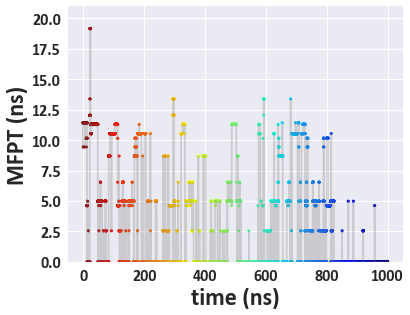

fit37_skip10_chain7


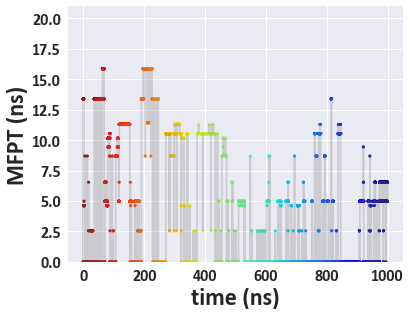

fit37_skip10_chain8


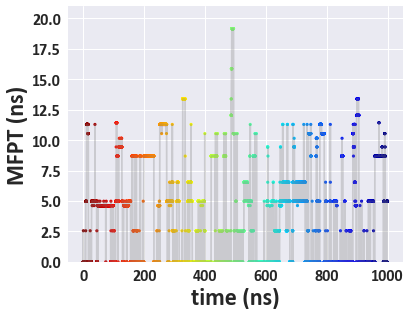

fit37_skip10_chain9


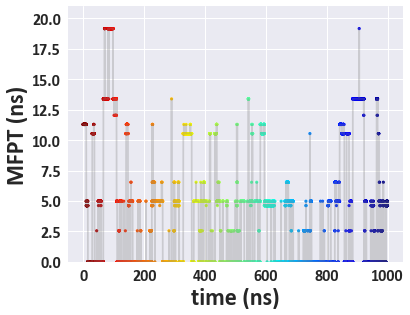

fit37_skip10_chain10


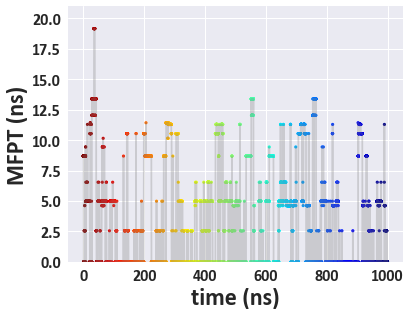

fit37_skip10_chain11


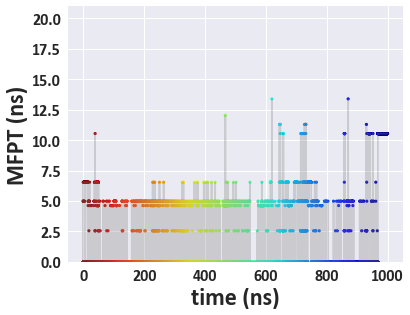

fit37_skip10_chain12


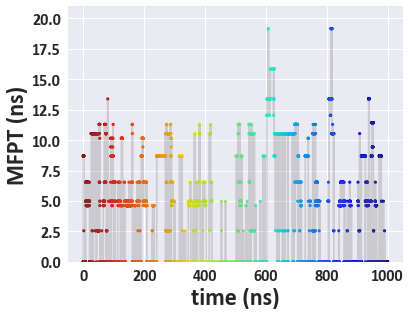

fit38_skip10_chain1


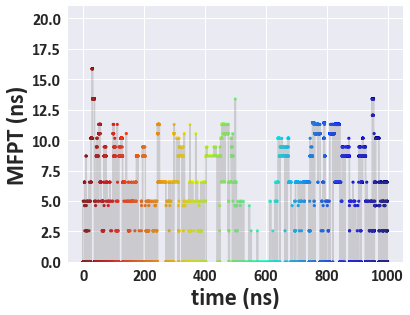

fit38_skip10_chain2


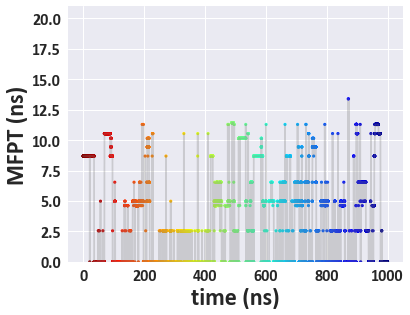

fit38_skip10_chain3


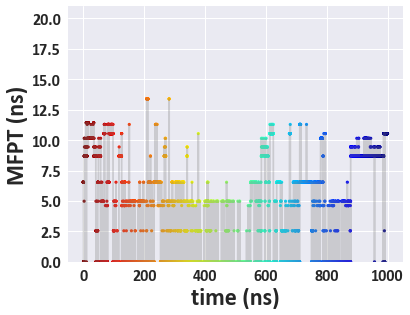

fit38_skip10_chain4


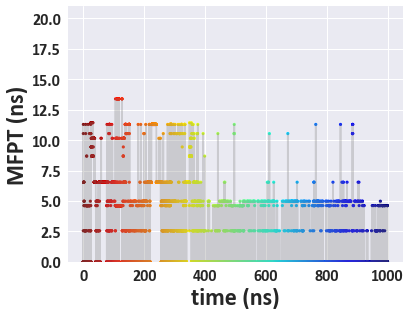

fit38_skip10_chain5


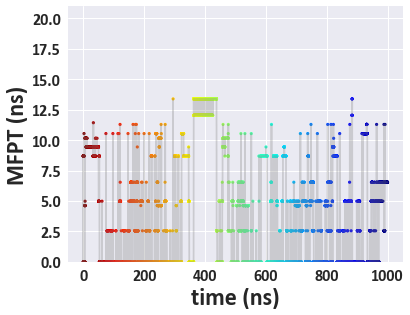

fit38_skip10_chain6


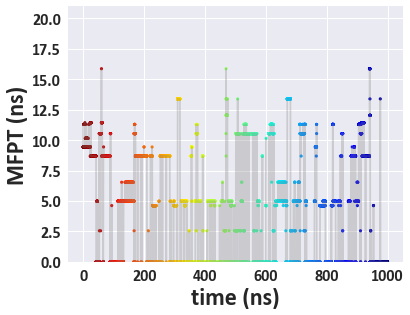

fit38_skip10_chain7


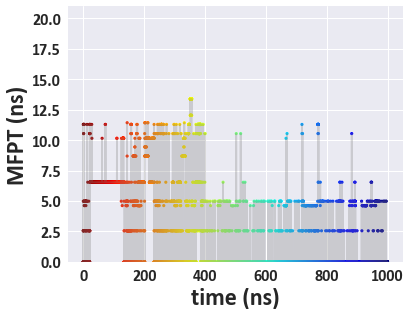

fit38_skip10_chain8


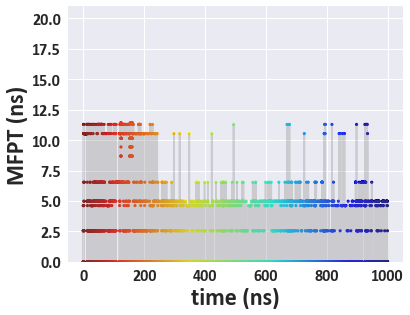

fit38_skip10_chain9


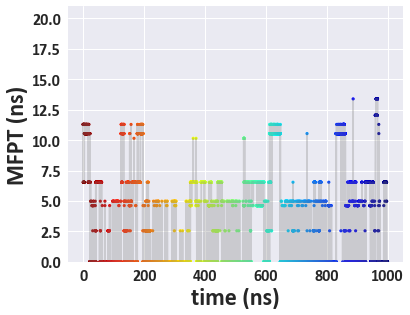

fit38_skip10_chain10


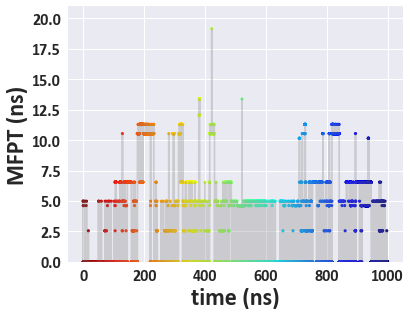

fit38_skip10_chain11


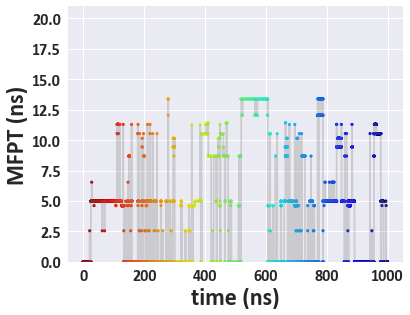

fit38_skip10_chain12


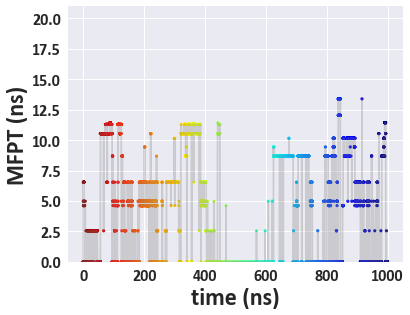

fit39_skip10_chain1


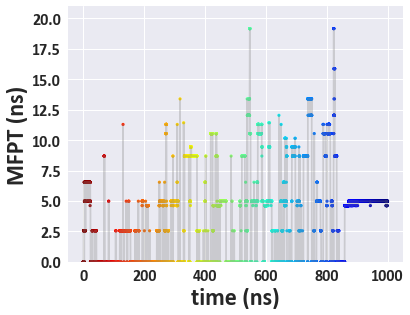

fit39_skip10_chain2


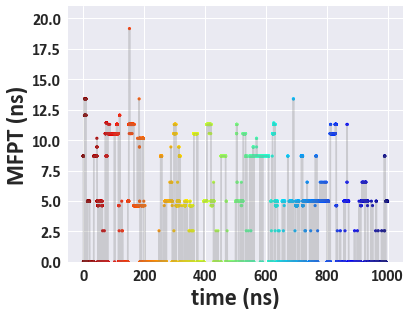

fit39_skip10_chain3


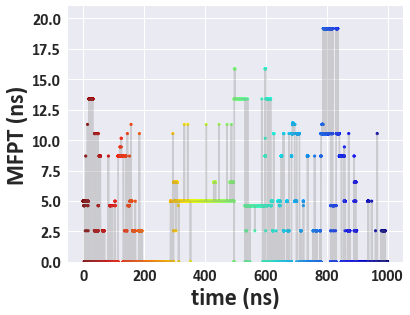

fit39_skip10_chain4


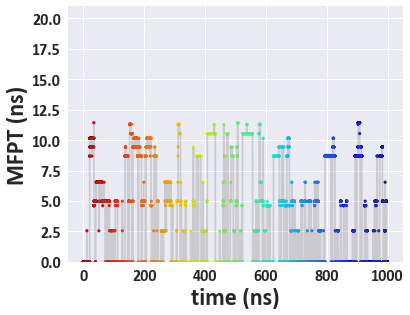

fit39_skip10_chain5


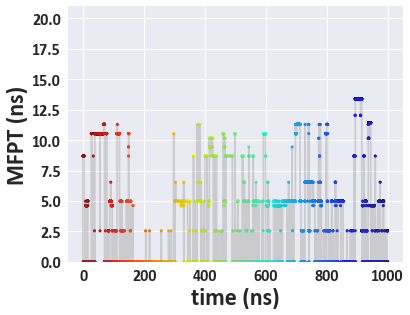

fit39_skip10_chain6


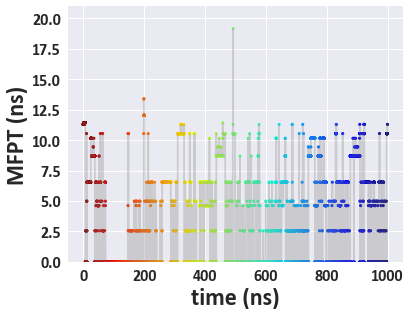

fit39_skip10_chain7


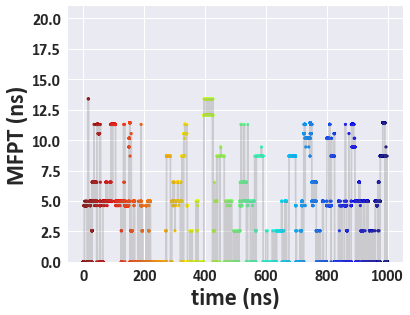

fit39_skip10_chain8


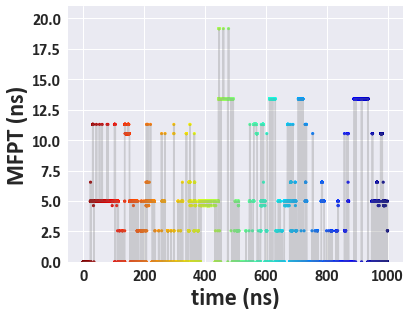

fit39_skip10_chain9


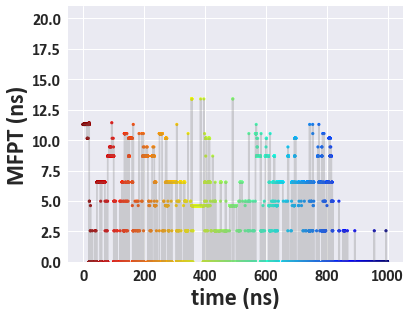

fit39_skip10_chain10


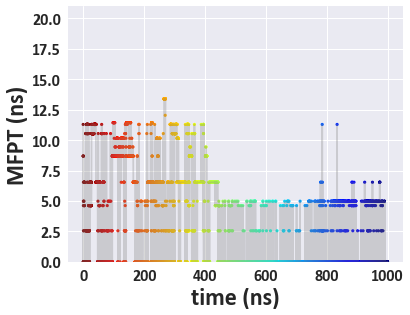

fit39_skip10_chain11


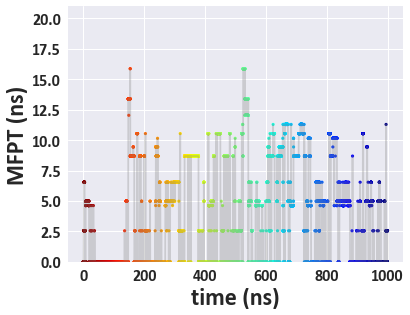

fit39_skip10_chain12


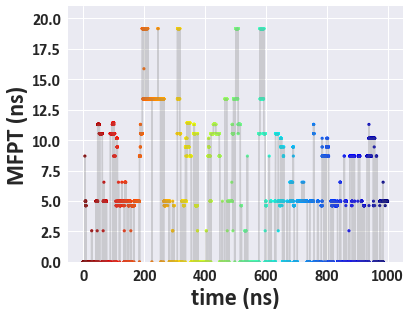

fit40_skip10_chain1


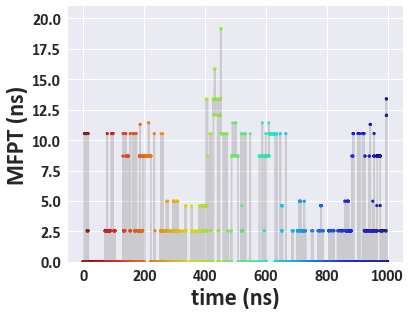

fit40_skip10_chain2


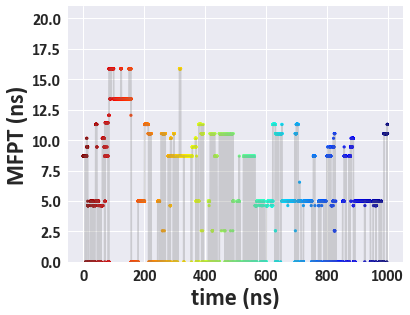

fit40_skip10_chain3


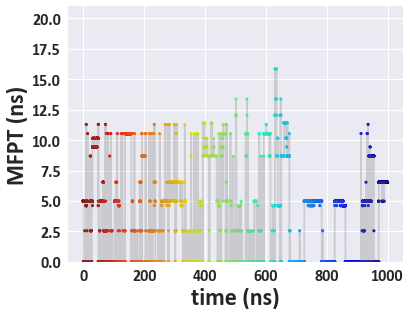

fit40_skip10_chain4


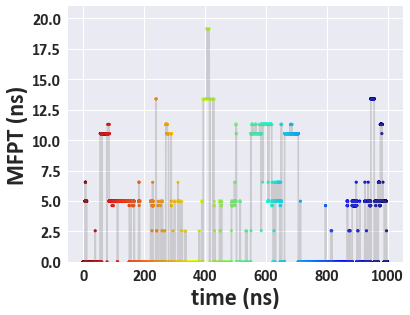

fit40_skip10_chain5


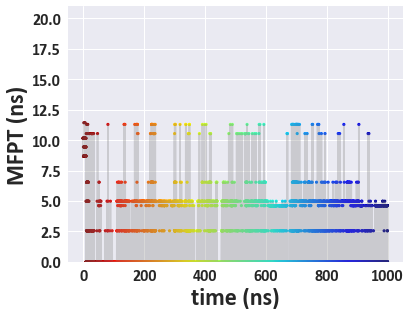

fit40_skip10_chain6


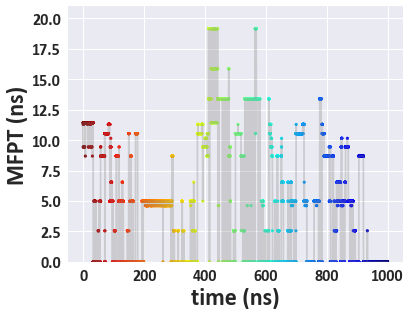

fit40_skip10_chain7


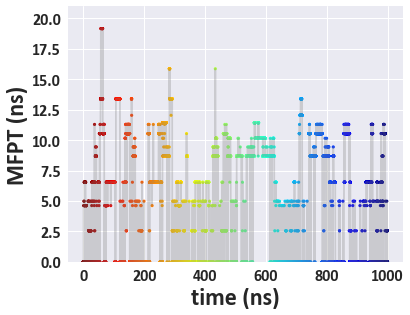

fit40_skip10_chain8


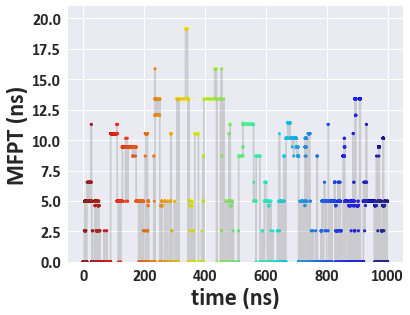

fit40_skip10_chain9


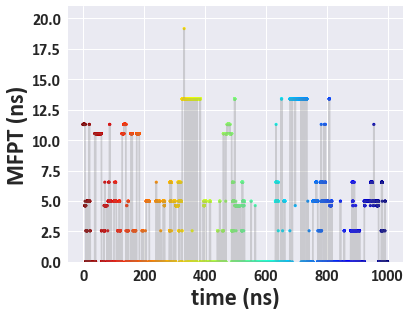

fit40_skip10_chain10


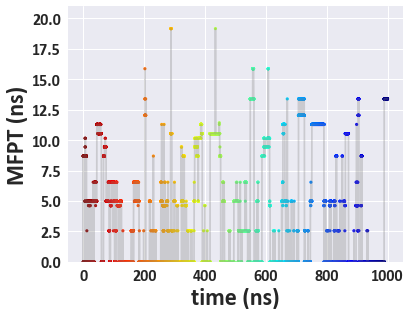

fit40_skip10_chain11


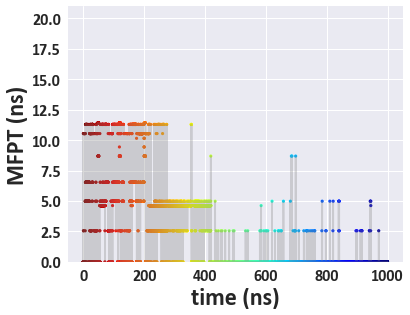

fit40_skip10_chain12


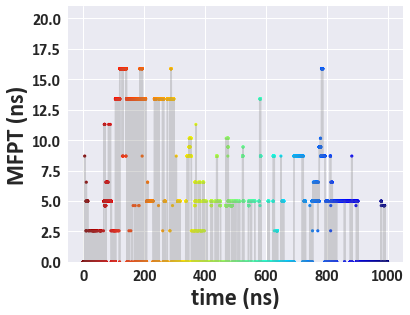

fit41_skip10_chain1


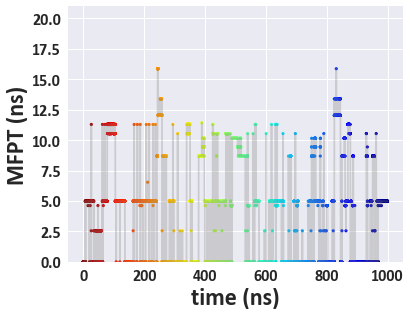

fit41_skip10_chain2


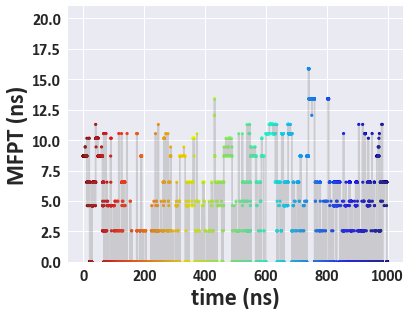

fit41_skip10_chain3


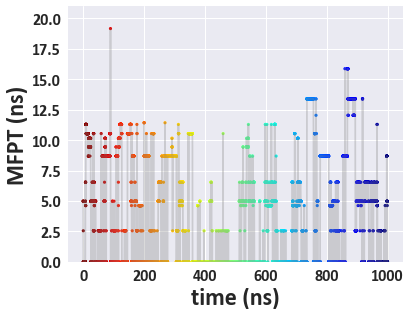

fit41_skip10_chain4


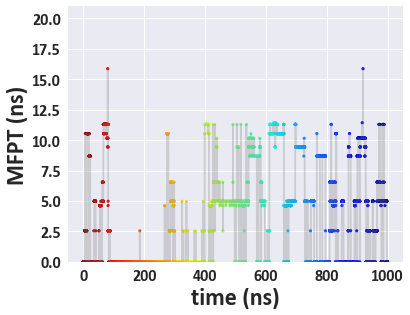

fit41_skip10_chain5


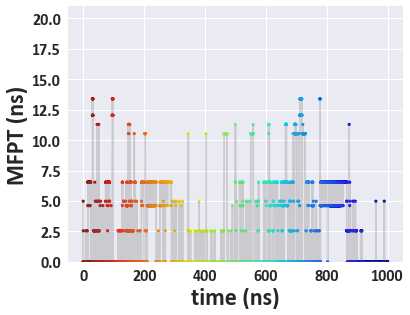

fit41_skip10_chain6


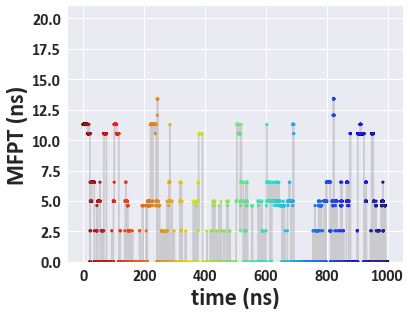

fit41_skip10_chain7


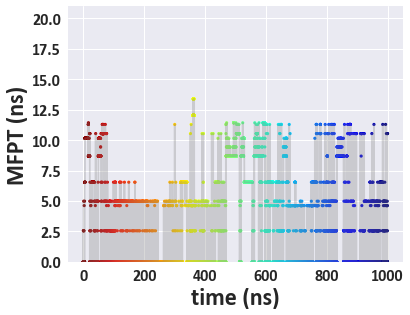

fit41_skip10_chain8


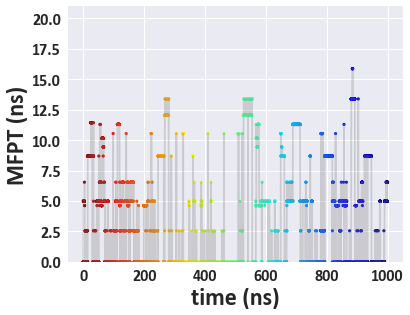

fit41_skip10_chain9


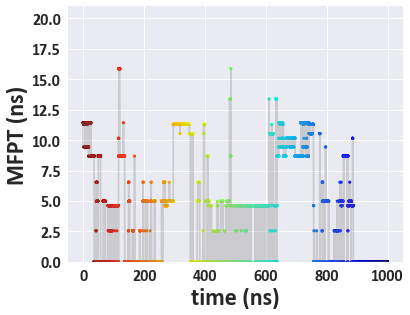

fit41_skip10_chain10


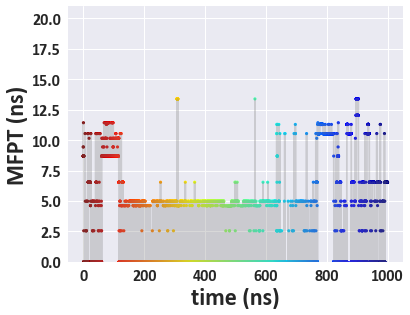

fit41_skip10_chain11


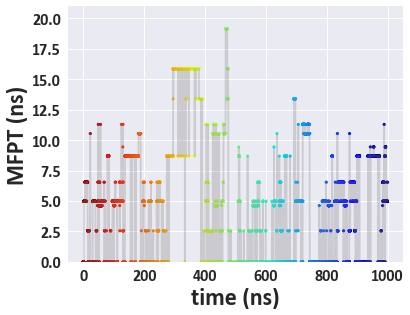

fit41_skip10_chain12


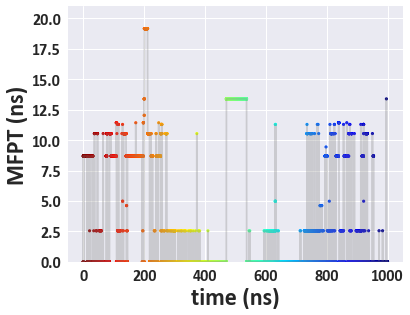

fit42_skip10_chain1


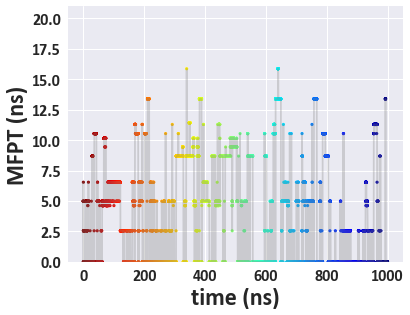

fit42_skip10_chain2


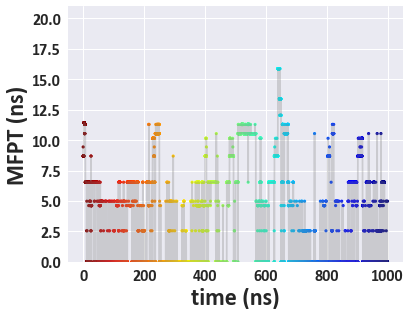

fit42_skip10_chain3


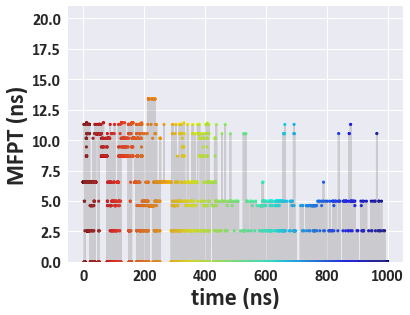

fit42_skip10_chain4


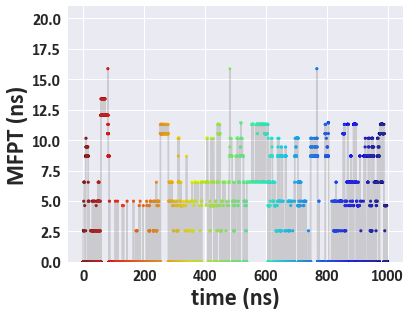

fit42_skip10_chain5


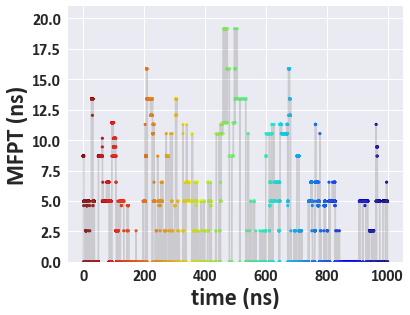

fit42_skip10_chain6


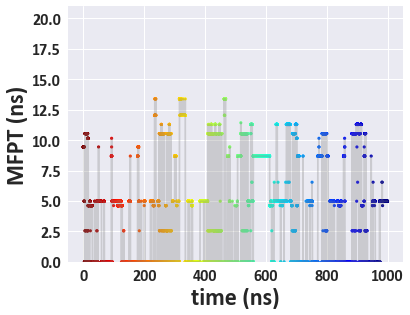

fit42_skip10_chain7


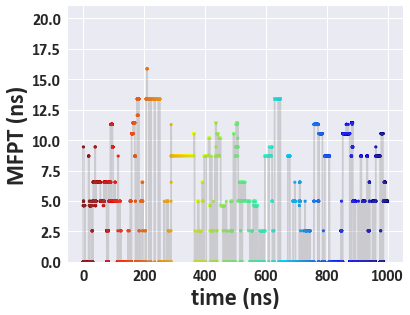

fit42_skip10_chain8


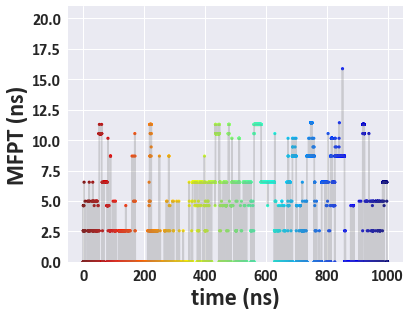

fit42_skip10_chain9


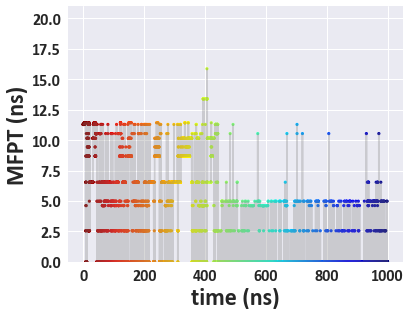

fit42_skip10_chain10


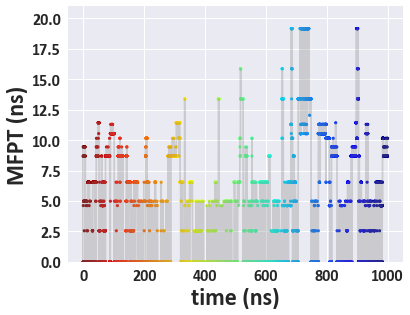

fit42_skip10_chain11


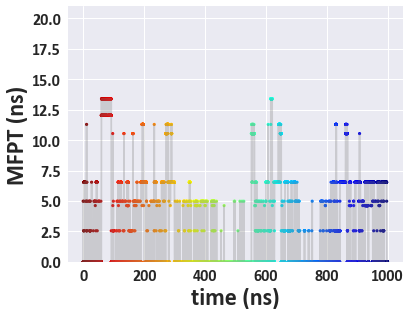

fit42_skip10_chain12


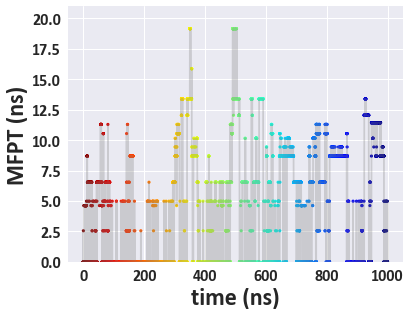

fit43_skip10_chain1


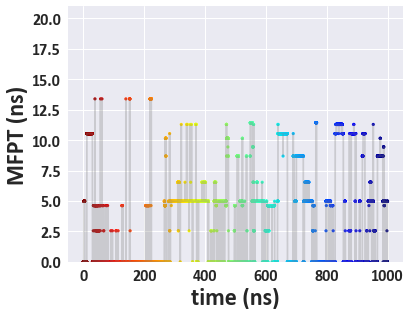

fit43_skip10_chain2


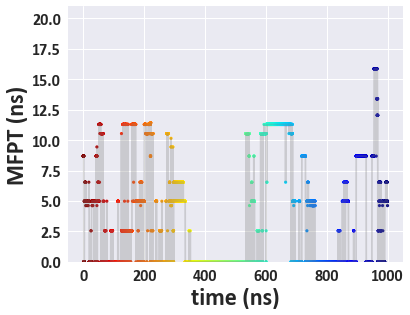

fit43_skip10_chain3


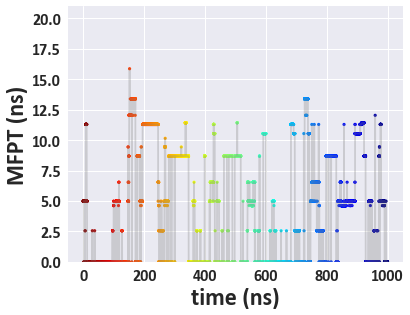

fit43_skip10_chain4


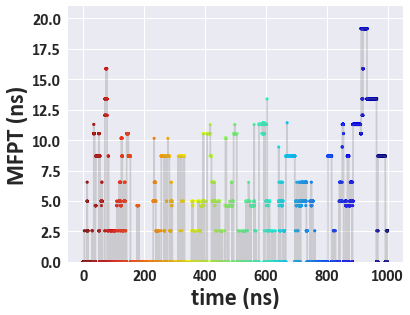

fit43_skip10_chain5


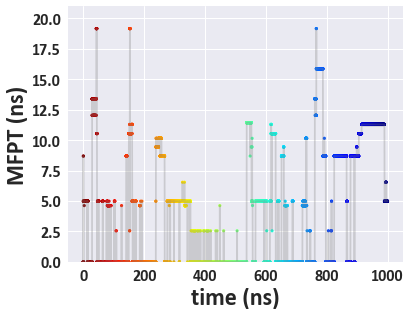

fit43_skip10_chain6


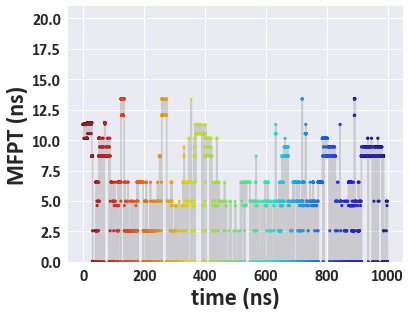

fit43_skip10_chain7


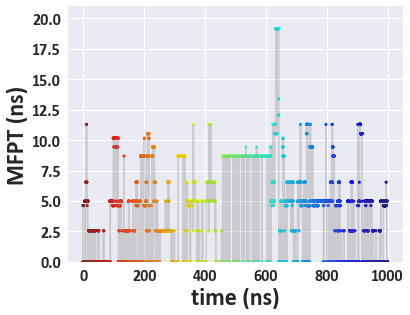

fit43_skip10_chain8


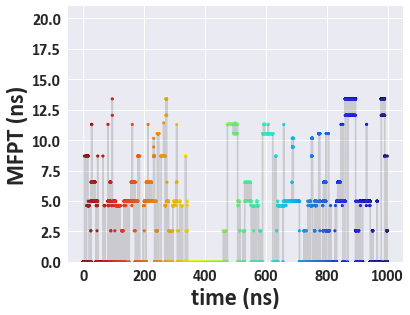

fit43_skip10_chain9


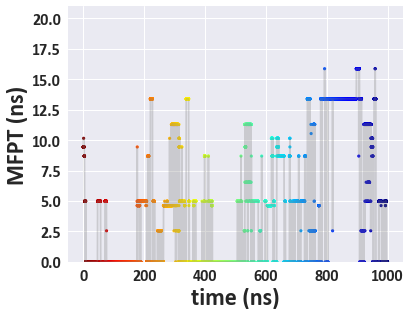

fit43_skip10_chain10


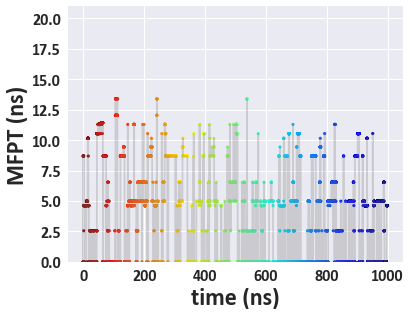

fit43_skip10_chain11


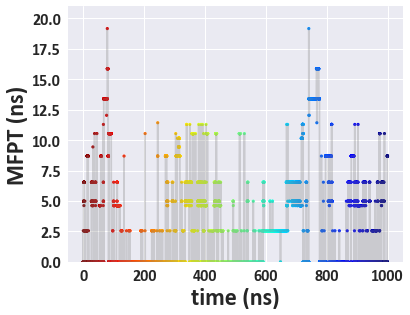

fit43_skip10_chain12


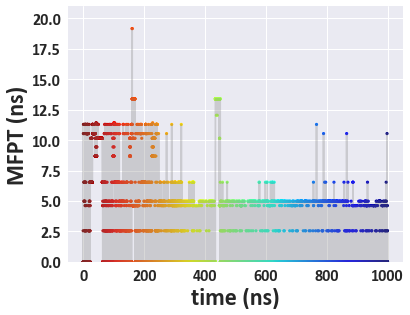

fit44_skip10_chain1


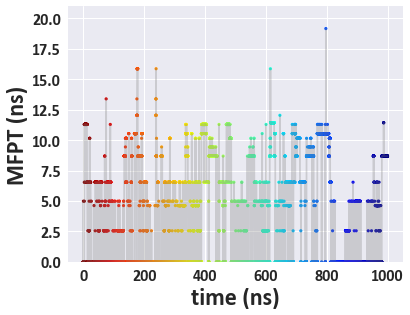

fit44_skip10_chain2


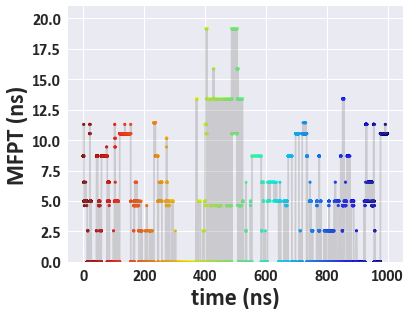

fit44_skip10_chain3


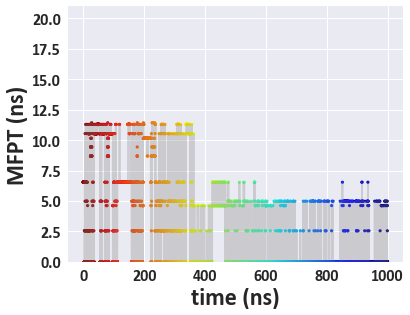

fit44_skip10_chain4


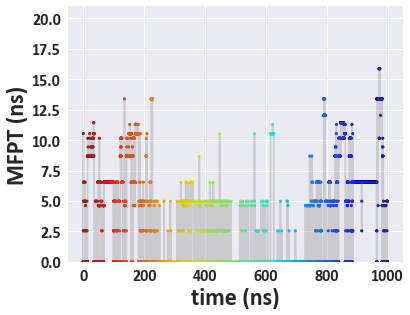

fit44_skip10_chain5


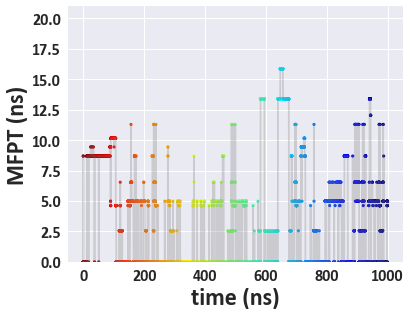

fit44_skip10_chain6


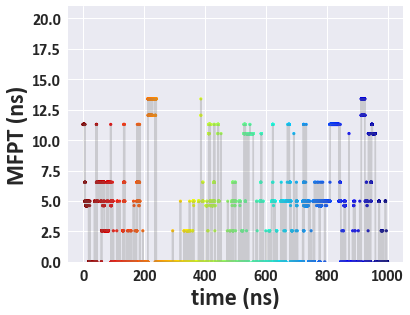

fit44_skip10_chain7


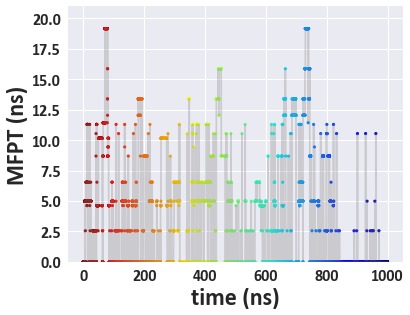

fit44_skip10_chain8


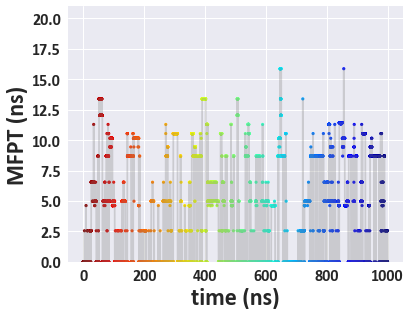

fit44_skip10_chain9


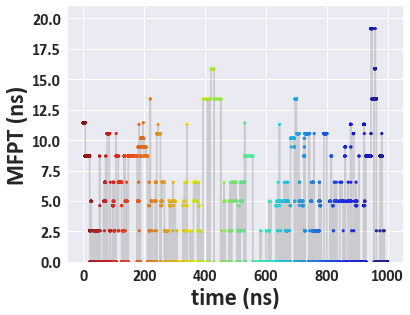

fit44_skip10_chain10


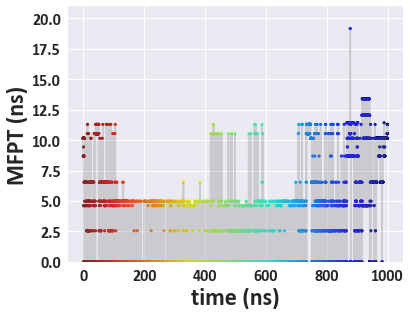

fit44_skip10_chain11


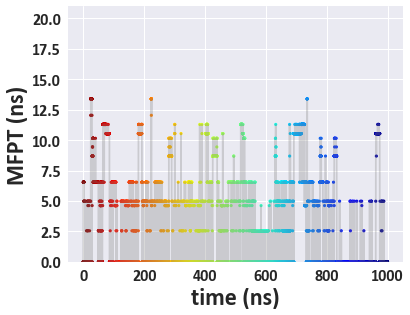

fit44_skip10_chain12


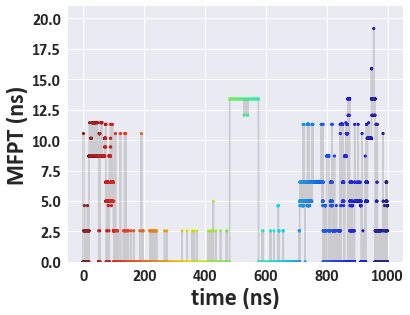

fit45_skip10_chain1


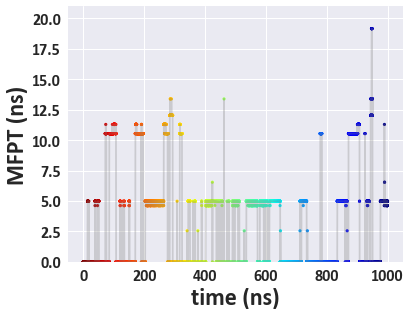

fit45_skip10_chain2


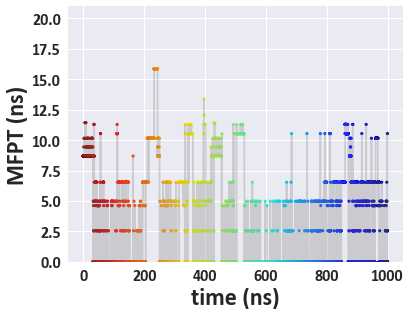

fit45_skip10_chain3


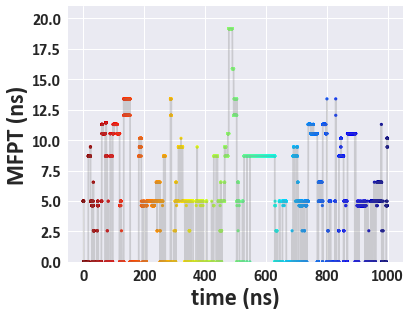

fit45_skip10_chain4


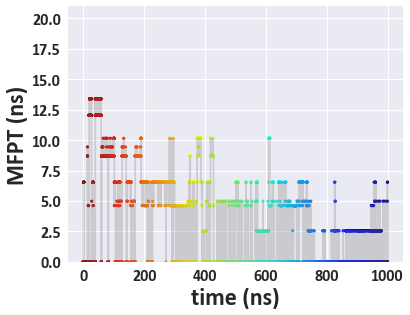

fit45_skip10_chain5


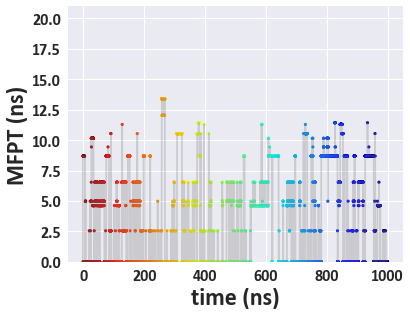

fit45_skip10_chain6


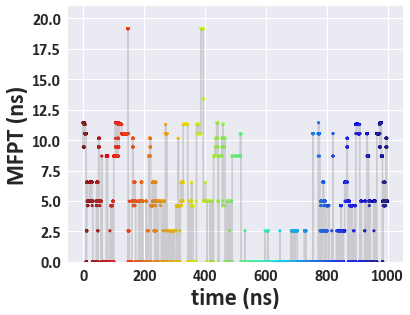

fit45_skip10_chain7


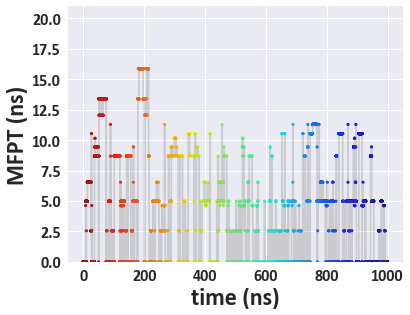

fit45_skip10_chain8


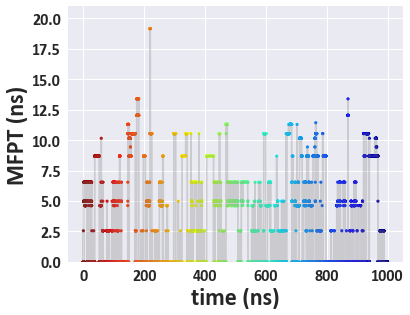

fit45_skip10_chain9


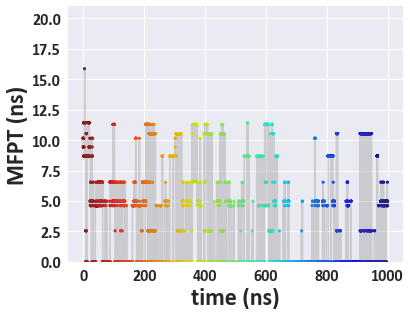

fit45_skip10_chain10


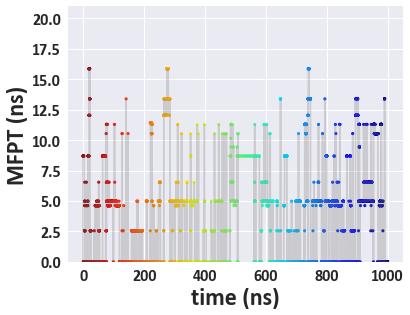

fit45_skip10_chain11


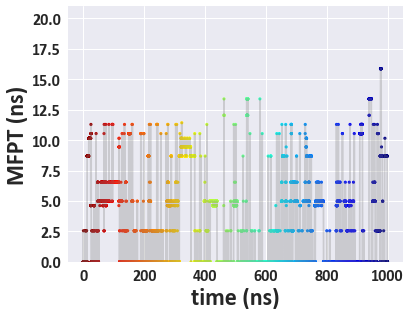

fit45_skip10_chain12


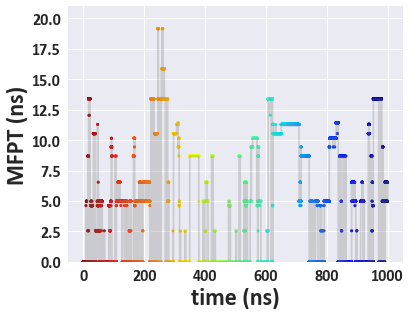

fit46_skip10_chain1


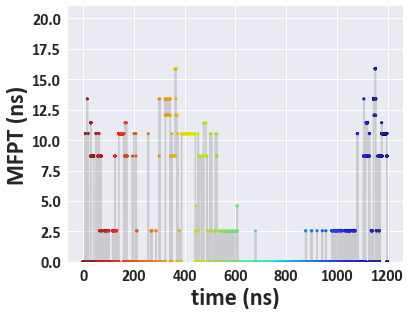

fit46_skip10_chain2


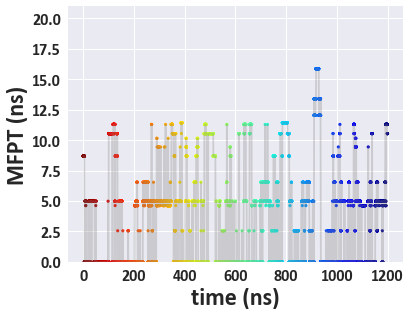

fit46_skip10_chain3


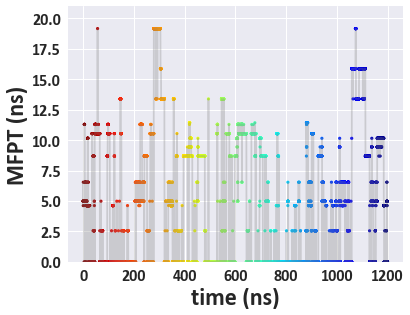

fit46_skip10_chain4


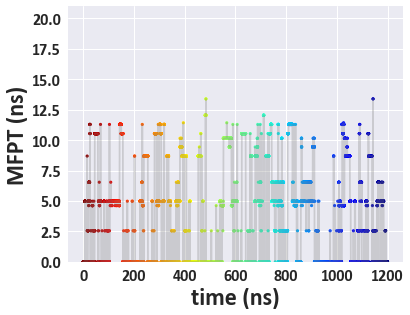

fit46_skip10_chain5


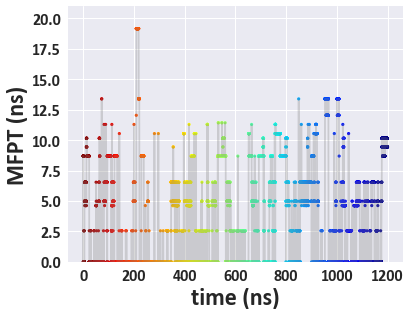

fit46_skip10_chain6


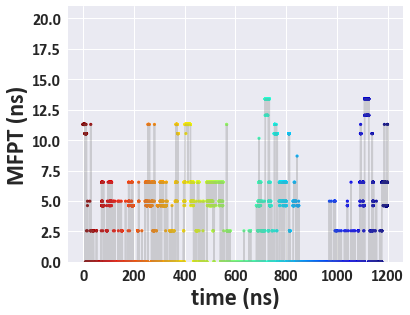

fit46_skip10_chain7


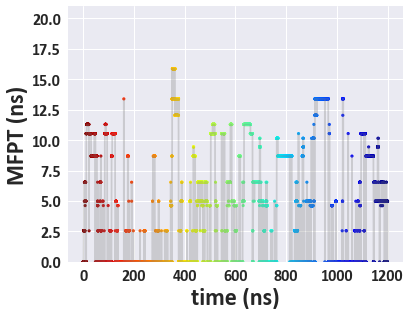

fit46_skip10_chain8


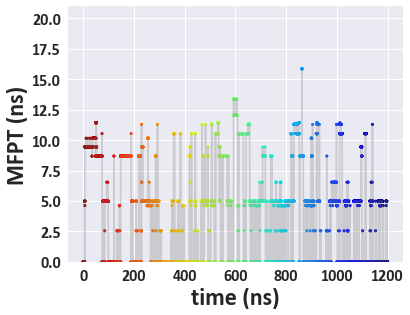

fit46_skip10_chain9


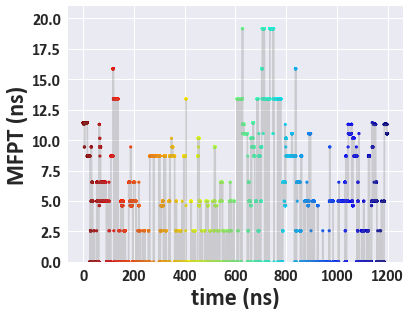

fit46_skip10_chain10


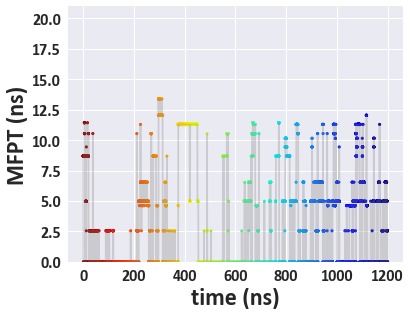

fit46_skip10_chain11


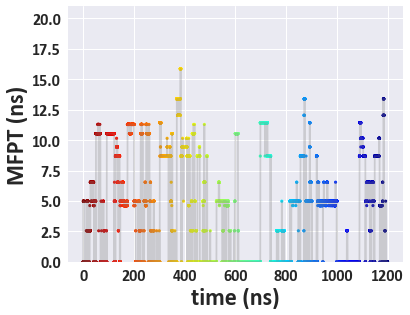

fit46_skip10_chain12


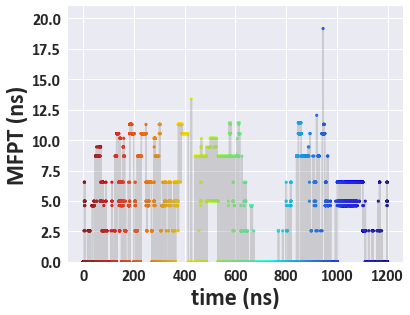

fit47_skip10_chain1


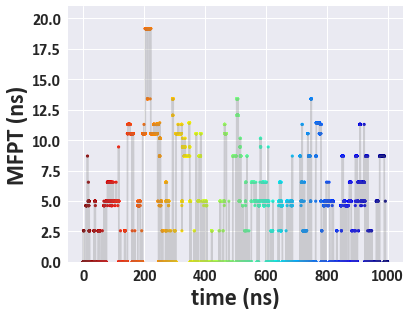

fit47_skip10_chain2


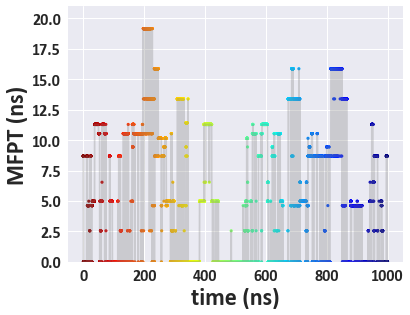

fit47_skip10_chain3


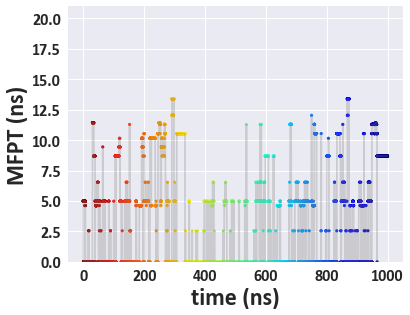

fit47_skip10_chain4


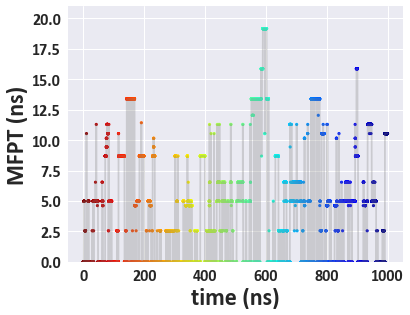

fit47_skip10_chain5


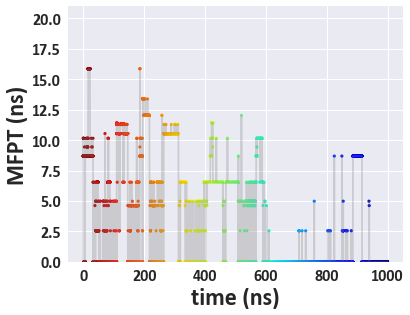

fit47_skip10_chain6


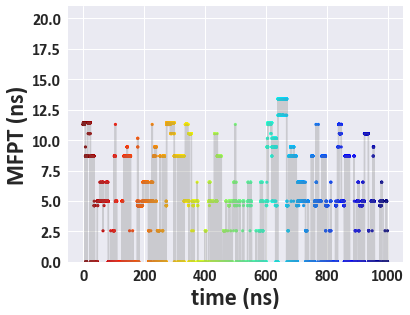

fit47_skip10_chain7


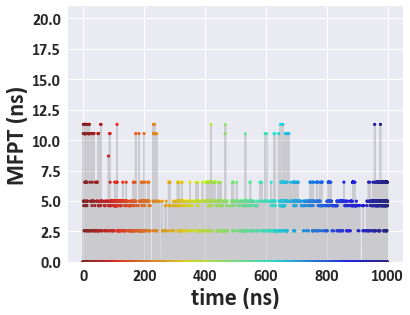

fit47_skip10_chain8


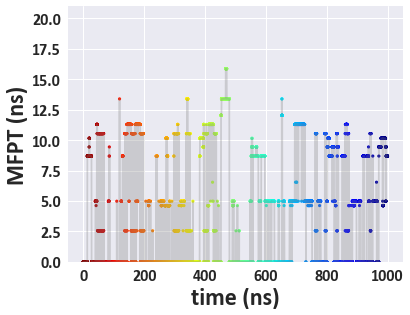

fit47_skip10_chain9


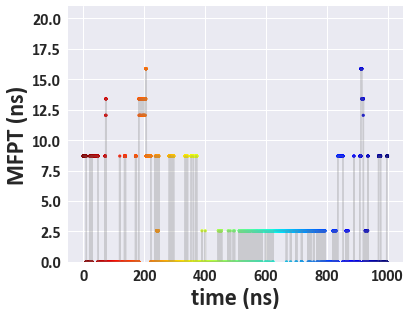

fit47_skip10_chain10


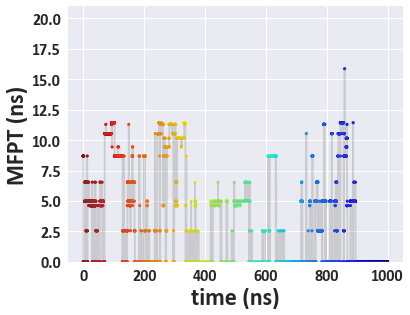

fit47_skip10_chain11


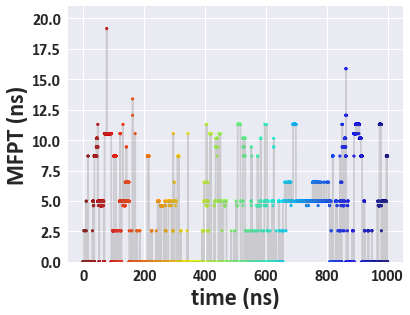

fit47_skip10_chain12


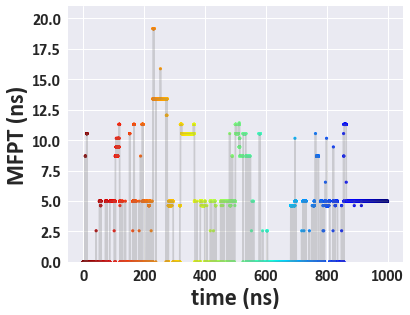

fit48_skip10_chain1


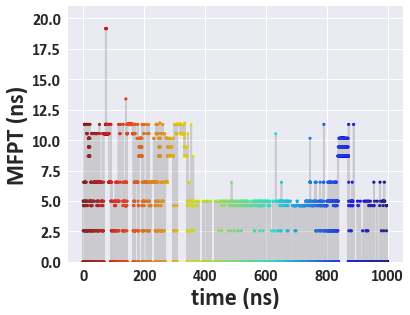

fit48_skip10_chain2


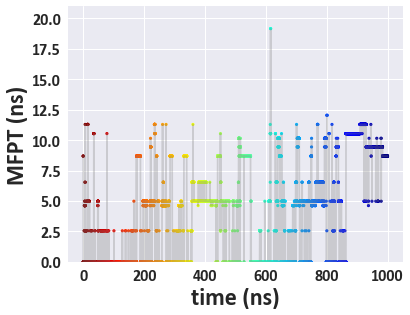

fit48_skip10_chain3


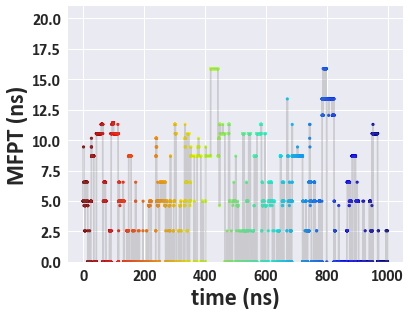

fit48_skip10_chain4


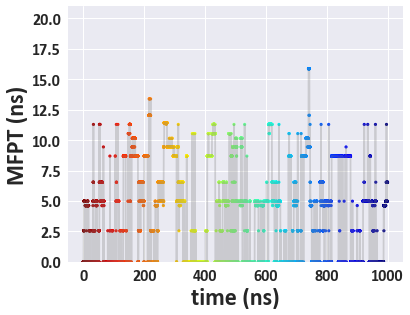

fit48_skip10_chain5


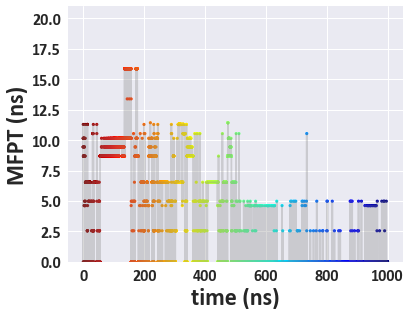

fit48_skip10_chain6


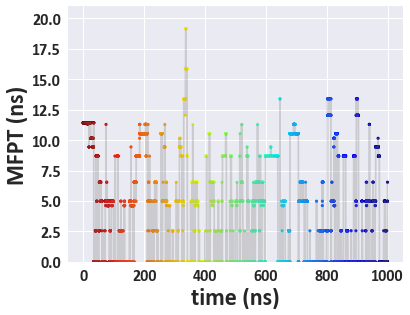

fit48_skip10_chain7


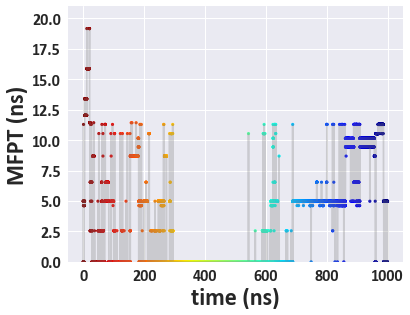

fit48_skip10_chain8


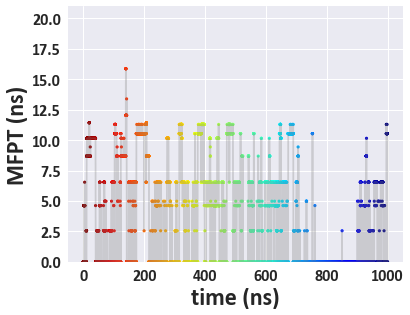

fit48_skip10_chain9


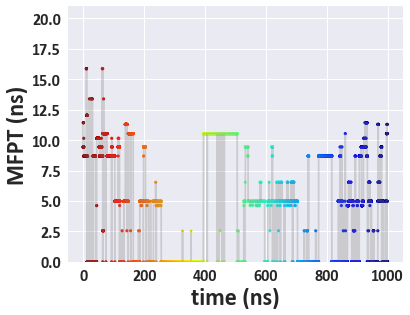

fit48_skip10_chain10


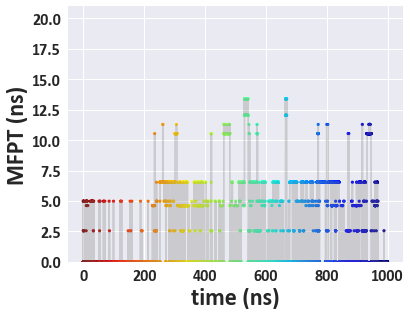

fit48_skip10_chain11


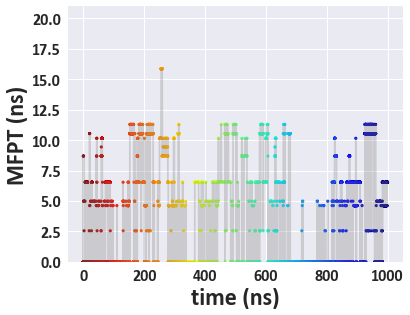

fit48_skip10_chain12


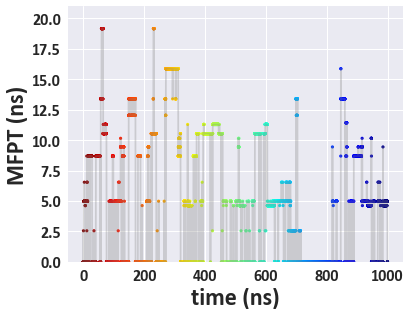

fit49_skip10_chain1


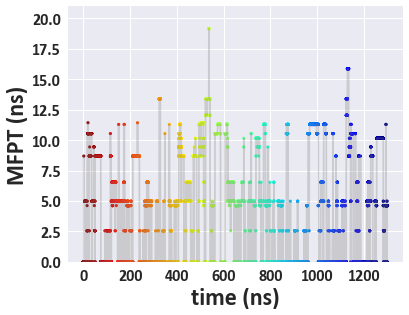

fit49_skip10_chain2


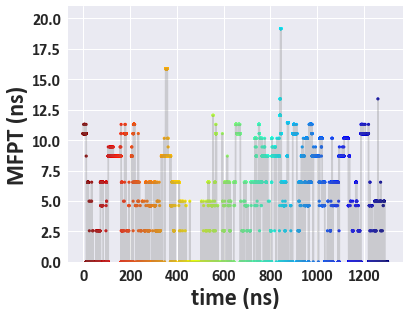

fit49_skip10_chain3


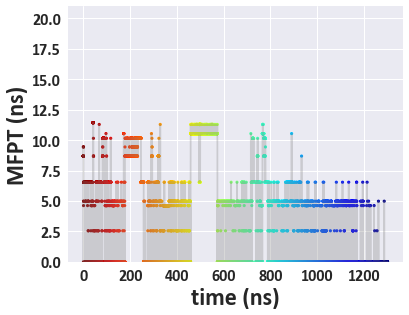

fit49_skip10_chain4


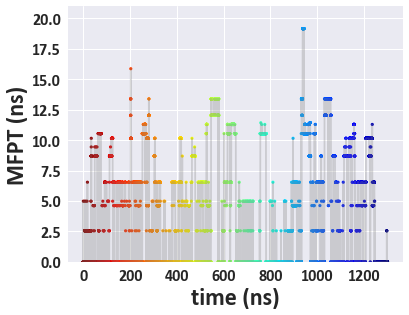

fit49_skip10_chain5


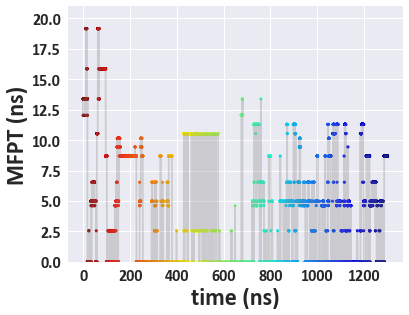

fit49_skip10_chain6


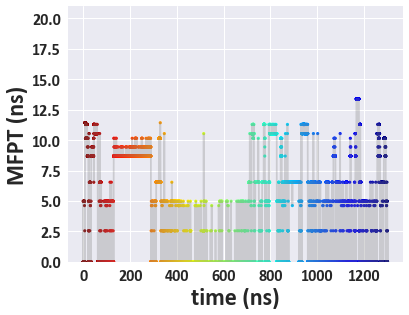

fit49_skip10_chain7


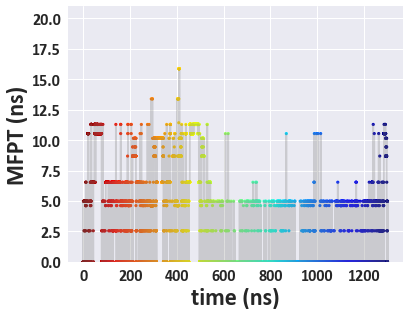

fit49_skip10_chain8


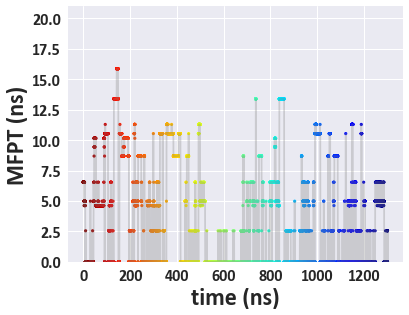

fit49_skip10_chain9


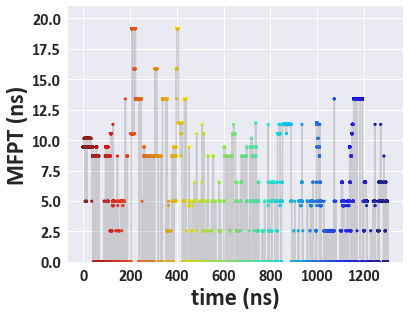

fit49_skip10_chain10


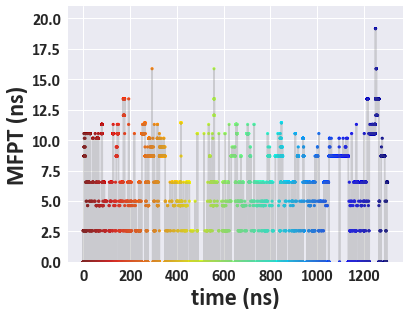

fit49_skip10_chain11


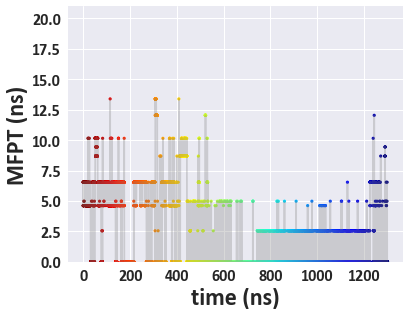

fit49_skip10_chain12


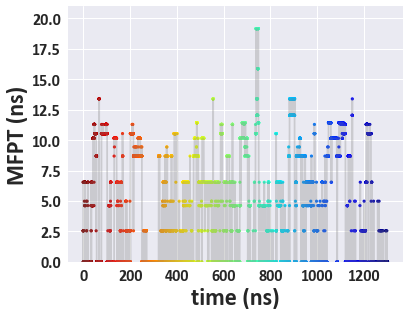

fit50_skip10_chain1


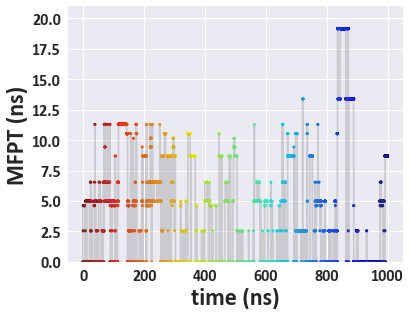

fit50_skip10_chain2


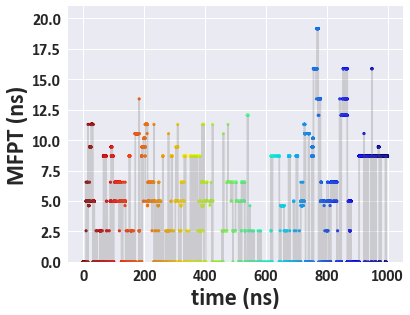

fit50_skip10_chain3


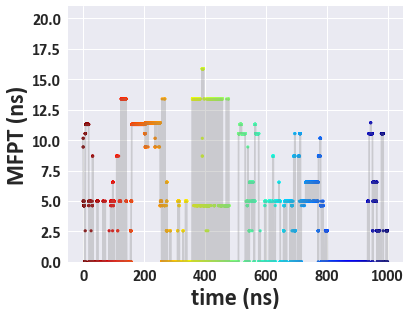

fit50_skip10_chain4


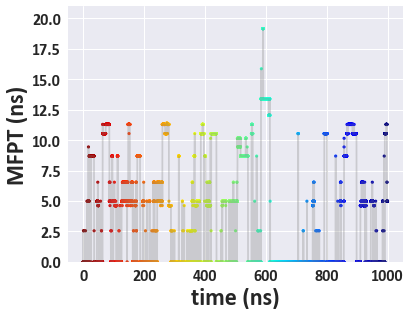

fit50_skip10_chain5


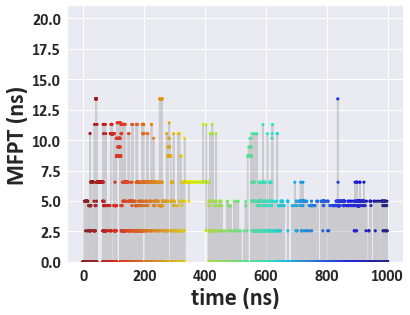

fit50_skip10_chain6


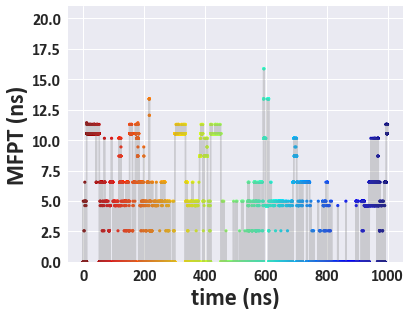

fit50_skip10_chain7


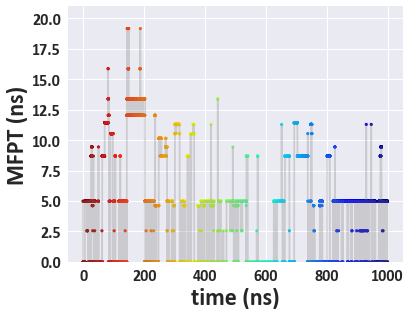

fit50_skip10_chain8


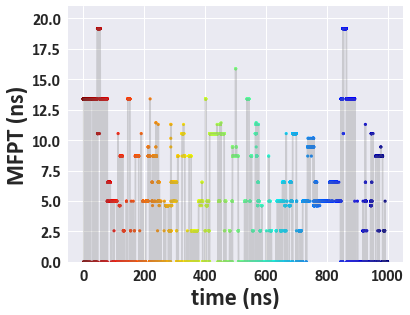

fit50_skip10_chain9


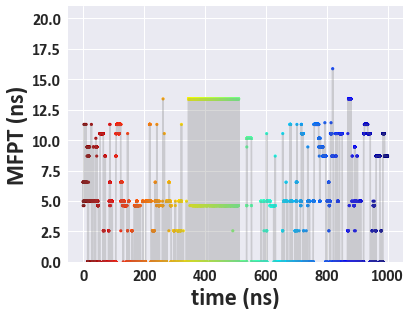

fit50_skip10_chain10


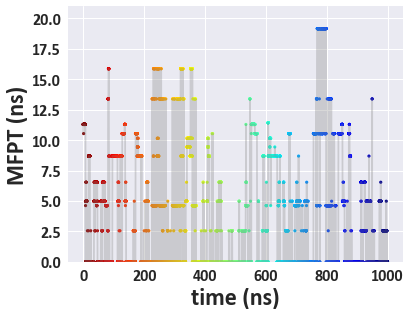

fit50_skip10_chain11


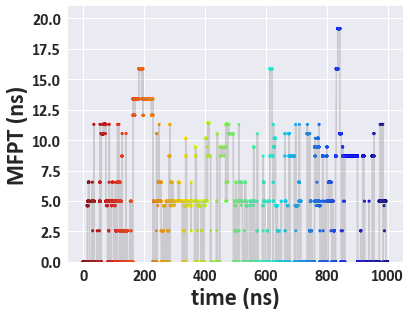

fit50_skip10_chain12


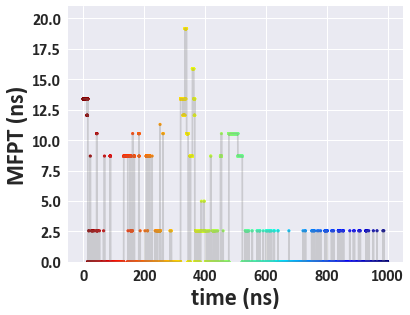

fit51_skip10_chain1


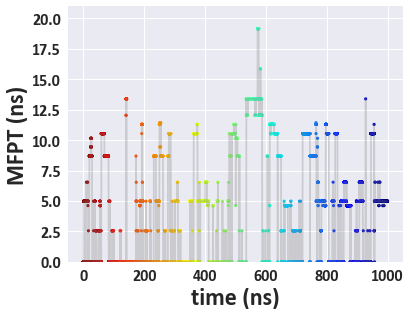

fit51_skip10_chain2


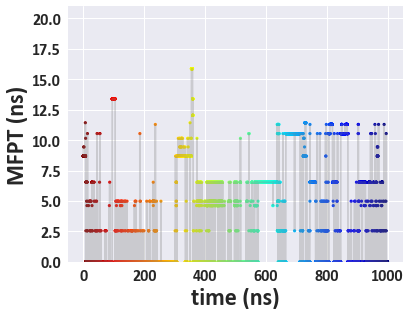

fit51_skip10_chain3


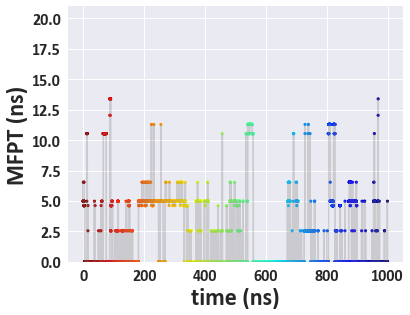

fit51_skip10_chain4


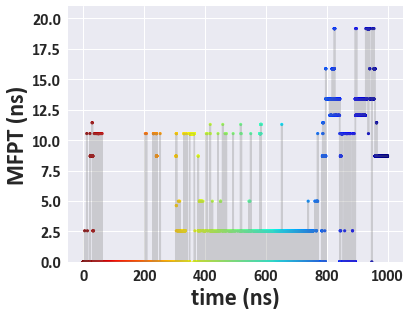

fit51_skip10_chain5


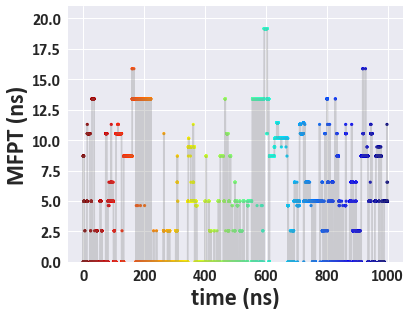

fit51_skip10_chain6


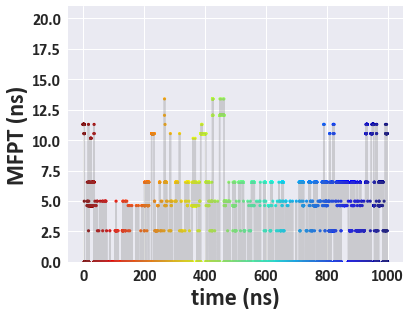

fit51_skip10_chain7


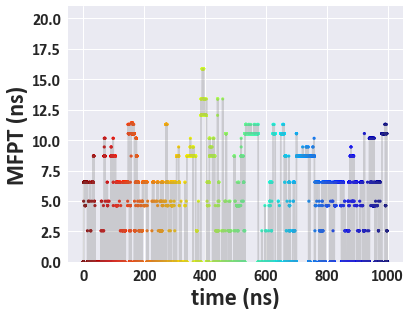

fit51_skip10_chain8


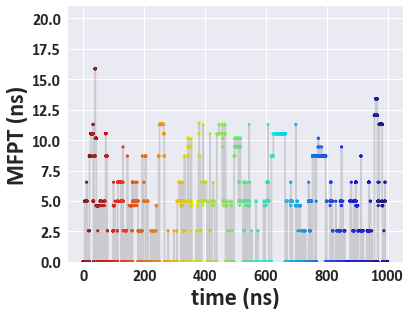

fit51_skip10_chain9


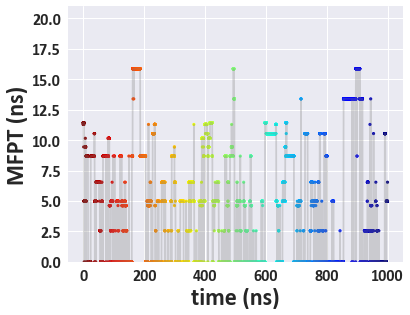

fit51_skip10_chain10


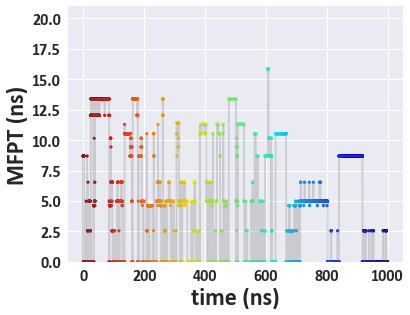

fit51_skip10_chain11


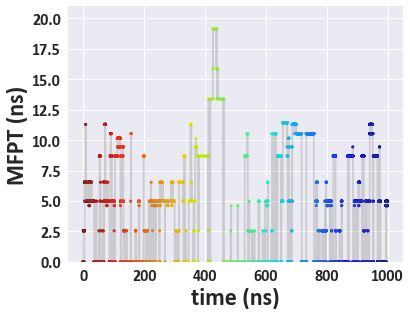

fit51_skip10_chain12


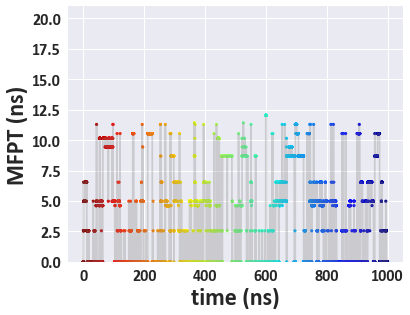

fit52_skip10_chain1


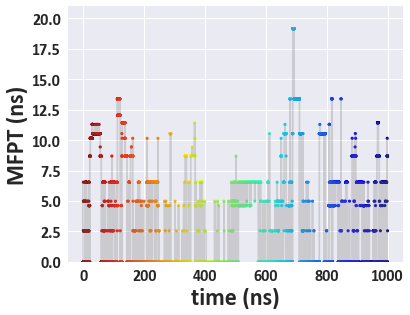

fit52_skip10_chain2


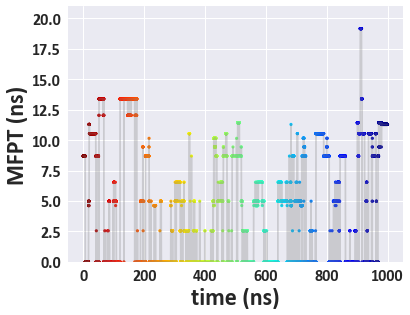

fit52_skip10_chain3


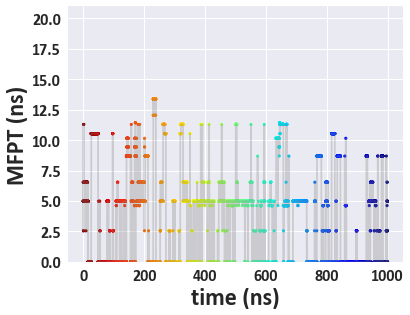

fit52_skip10_chain4


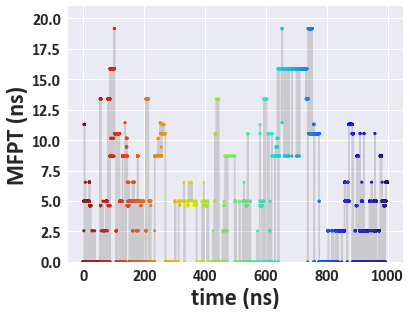

fit52_skip10_chain5


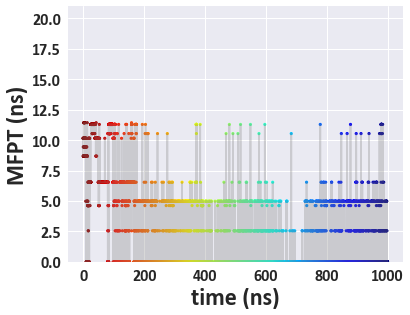

fit52_skip10_chain6


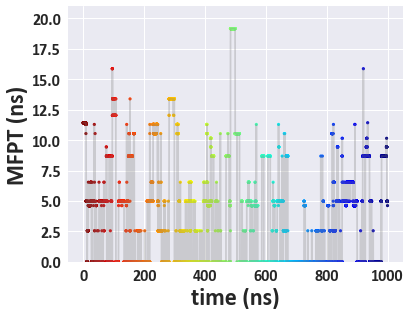

fit52_skip10_chain7


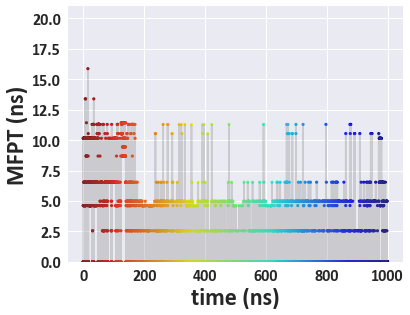

fit52_skip10_chain8


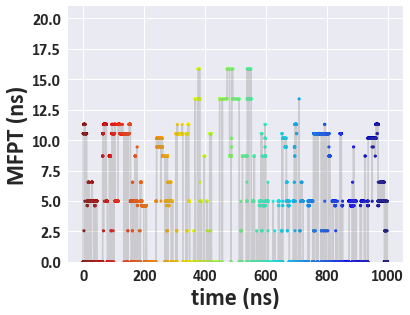

fit52_skip10_chain9


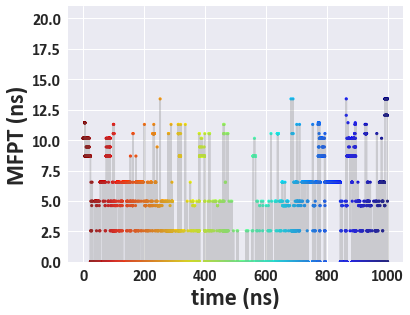

fit52_skip10_chain10


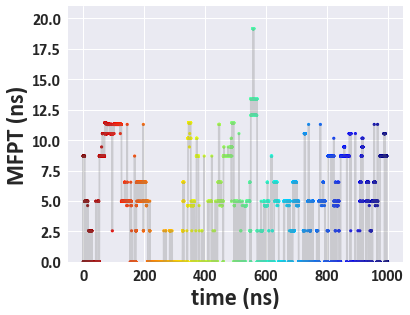

fit52_skip10_chain11


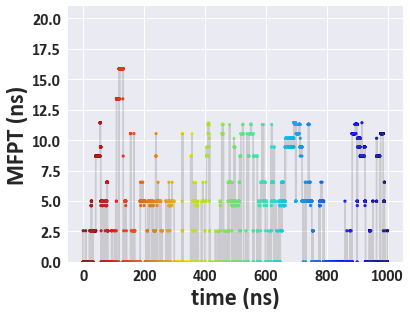

fit52_skip10_chain12


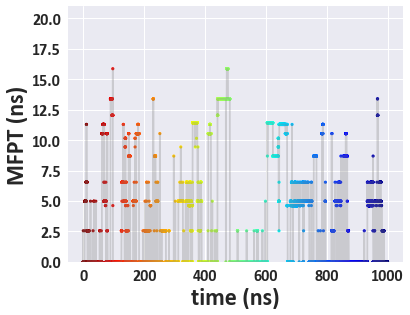

In [30]:
mfpt=[15.87 ,12.04 ,11.43 ,19.17 ,9.44 ,10.15 ,13.39 ,11.29 ,2.55 ,6.54 ,4.62 ,10.54 ,8.69 ,4.98 ,0.00 ]
for trj in range(2,53):
    for chain in range(1,13):
        tc='fit'+str(trj)+'_skip10_chain'+str(chain)
        print tc
        filename=tc+'_macro_trajs.dat'
        xtcname='/home/disk2/wdd/PDZ/12concentration/trj/all/'+tc+'.xtc'
        wf=open(filename,'w')
        fitchain_xyz=dataset(xtcname,topology='/home/disk2/wdd/PDZ/charm36m/crystal.pdb',stride=1)
        fitchain_diheds = featurizer.fit_transform(fitchain_xyz)
        fitchain_scaled_diheds = scaler.fit_transform(fitchain_diheds)
        fitchain_tica_trajs = tica_model.transform(fitchain_scaled_diheds)
        fitchain_clustered_trajs = clusterer.transform(fitchain_tica_trajs)
        fitchain_macro_trajs = pcca.transform(fitchain_clustered_trajs)
        
        for i in fitchain_macro_trajs[0]:
            wf.write(str(i)+'\n')
        wf.close()
        time_step=0.1       #ns
        import pandas as pd
        import seaborn as sns
        sns.set(color_codes=True)
        import matplotlib.pyplot as plt
        import matplotlib.font_manager as font_manager
        font_path = '/home/disk2/wdd/msm/calibribold.ttf'
        font_prop = font_manager.FontProperties(fname=font_path, size=24)
        leg_prop = font_manager.FontProperties(fname=font_path, size=17)
        cmap = plt.cm.get_cmap("jet_r")
        
        fig, ax = plt.subplots(figsize=(6,4.7))
        data = np.loadtxt(filename)
        data_sort=[]
        for m in data:
            data_sort.append(mfpt[int(m)])
        filename2=tc+'_macro_trajs_mfpt.dat'
        wf2=open(filename2,'w')
        for mm in data_sort:
            wf2.write(str(mm)+'\n')
        wf2.close()
        time = np.arange(len(data))*time_step
        ax.scatter(time,data_sort, c=np.arange(len(data)),cmap=cmap,lw = 0,s=10)
        ax.plot(time,data_sort,'gray',alpha=0.3)
        ax.set_ylabel('MFPT (ns)',fontproperties=font_prop)
        ax.set_xlabel('time (ns)',fontproperties=font_prop)
        plt.ylim(0,21)
        #ax.set_yticks(np.linspace(0,25,26))
        #ax.set_yticklabels(map_mfpt)
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontproperties(font_prop)
            label.set_fontsize(16)
        fig2name=tc+"_macro_trajs_mfpt.png"
        plt.savefig(fig2name,dpi=600,bbox_inches='tight')
        plt.show()

In [32]:
def Qrange(x):
    return int(x*100.0)/100.0

In [33]:
cd /home/disk2/wdd/PDZ/12concentration/Q_heavyatoms

/home/disk2/wdd/PDZ/12concentration/Q_heavyatoms


In [34]:
QrangeCount={}
for i in np.arange(0.0,1.0,0.01):
    QrangeCount[str(i)]=[]
for trj in range(1,53):
    #print trj
    for chain in range(1,13):
        Qheavy=np.loadtxt('fit'+str(trj)+'_chain'+str(chain)+'_Q_heavyatoms.cs')
        macro_traj=np.loadtxt('/home/disk2/wdd/PDZ/12concentration/toHubMfpt15states/fit'+str(trj)+'_skip10_chain'+str(chain)+'_macro_trajs.dat')
        for num in range(len(Qheavy)):
            #print Qrange(Qheavy[num])
            QrangeCount[str(Qrange(Qheavy[num]))].append(macro_traj[num])

In [40]:
allnum=0
for i in np.arange(0.0,1.0,0.01):
    allnum=len(QrangeCount[str(i)])+allnum

In [41]:
allnum

7380624

In [42]:
wf=open('population_Q100_15macrostates.cs','w')
for i in np.arange(0.00,1.00,0.01):
    popu=QrangeCount[str(i)].count(14)/(len(QrangeCount[str(i)])+0.0)
    #print popu
    wf.write(str(i+0.005)+'   '+str(popu)+'\n')
wf.close()

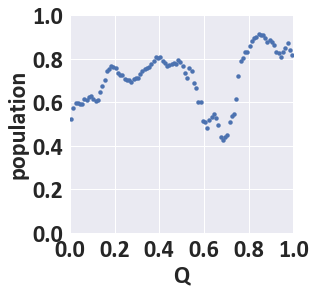

In [43]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
font_path = '/home/disk2/wdd/msm/calibribold.ttf'
font_prop = font_manager.FontProperties(fname=font_path, size=24)
leg_prop = font_manager.FontProperties(fname=font_path, size=17)
data = np.loadtxt('population_Q100_15macrostates.cs')
fig = plt.figure(figsize=(4, 4))
ax = fig.add_subplot(111)
#cmap = plt.cm.get_cmap("jet_r")
#cmap.set_over("white")
plt.scatter(data[:,0],data[:,1],lw = 0,s=20)
#plt.xlabel(r'rmsd ($^\circ$)',fontproperties=font_prop)
plt.xlabel(r'Q',fontproperties=font_prop)
plt.ylabel(r'population',fontproperties=font_prop)
plt.xlim(0,1)
plt.ylim(0,1)
#leg=plt.legend(loc=1, labelspacing=0.1, prop=leg_prop, scatterpoints=1, markerscale=1, numpoints=1,handlelength=1.5)
#leg.get_frame().set_linewidth(0.0)
#leg.get_frame().set_alpha(0.1)
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontproperties(font_prop)
plt.savefig('population_Q100_15macrostates.jpg',dpi=600,bbox_inches='tight')
    #label.set_fontsize(16)
#plt.imshow(HH, interpolation='nearest', origin='low',extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]],levels = np.linspace(1,6,20))
plt.show()

In [44]:
QrangeCountT={}
for i in np.arange(0.0,1.0,0.01):
    QrangeCountT[str(i)]=[]
for trj in range(1,53):
    #print trj
    for chain in range(1,13):
        Qheavy=np.loadtxt('fit'+str(trj)+'_chain'+str(chain)+'_Q_heavyatoms.cs')
        macro_traj=np.loadtxt('/home/disk2/wdd/PDZ/12concentration/toHubMfpt15states/fit'+str(trj)+'_skip10_chain'+str(chain)+'_macro_trajs_mfpt.dat')
        for num in range(len(Qheavy)):
            #print Qrange(Qheavy[num])
            QrangeCountT[str(Qrange(Qheavy[num]))].append(macro_traj[num])

In [45]:
wf=open('mfpt_Q100_15macrostates.cs','w')
for i in np.arange(0.00,1.00,0.01):
    mfpt=np.mean(QrangeCountT[str(i)])
    #print popu
    wf.write(str(i+0.005)+'   '+str(mfpt)+'\n')
wf.close()

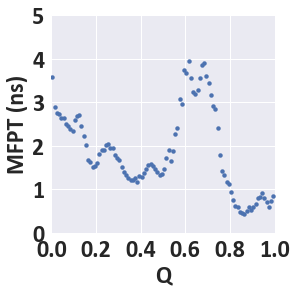

In [46]:
data = np.loadtxt('mfpt_Q100_15macrostates.cs')
fig = plt.figure(figsize=(4, 4))
ax = fig.add_subplot(111)
#cmap = plt.cm.get_cmap("jet_r")
#cmap.set_over("white")
plt.scatter(data[:,0],data[:,1],lw = 0,s=20)
#plt.xlabel(r'rmsd ($^\circ$)',fontproperties=font_prop)
plt.xlabel(r'Q',fontproperties=font_prop)
plt.ylabel(r'MFPT (ns)',fontproperties=font_prop)
plt.xlim(0,1)
plt.ylim(0,5)
#leg=plt.legend(loc=1, labelspacing=0.1, prop=leg_prop, scatterpoints=1, markerscale=1, numpoints=1,handlelength=1.5)
#leg.get_frame().set_linewidth(0.0)
#leg.get_frame().set_alpha(0.1)
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontproperties(font_prop)
plt.savefig('mfpt_Q100_15macrostates.jpg',dpi=600,bbox_inches='tight')
    #label.set_fontsize(16)
#plt.imshow(HH, interpolation='nearest', origin='low',extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]],levels = np.linspace(1,6,20))
plt.show()

In [118]:
QrangeCount_s={}
for i in np.arange(0.0,1.0,0.01):
    QrangeCount_s[str(i)]=[]
for trj in range(1,53):
    print trj
    for chain in range(1,13):
        Qheavy=np.loadtxt('fit'+str(trj)+'_chain'+str(chain)+'_Q_heavyatoms.cs')
        macro_traj=np.loadtxt('/home/disk2/wdd/PDZ/12concentration/toHubMfpt/fit'+str(trj)+'_skip10_chain'+str(chain)+'_macro_trajs.dat')
        for num in range(10001):
            #print Qrange(Qheavy[num])
            QrangeCount_s[str(Qrange(Qheavy[num]))].append(macro_traj[num])
wf=open('population_Q100_s.cs','w')
for i in np.arange(0.00,1.00,0.01):
    popu=QrangeCount_s[str(i)].count(24)/(len(QrangeCount_s[str(i)])+0.0)
    #print popu
    wf.write(str(i+0.005)+'   '+str(popu)+'\n')
wf.close()

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52


In [124]:
def Qrange1(x):
    return int(x*10.0)/10.0
QrangeCount_1={}
for i in np.arange(0.0,1.0,0.1):
    QrangeCount_1[str(i)]=[]
for trj in range(47,48):
    print trj
    for chain in range(7,8):
        Qheavy=np.loadtxt('fit'+str(trj)+'_chain'+str(chain)+'_Q_heavyatoms.cs')
        macro_traj=np.loadtxt('/home/disk2/wdd/PDZ/12concentration/toHubMfpt/fit'+str(trj)+'_skip10_chain'+str(chain)+'_macro_trajs.dat')
        for num in range(10001):
            #print Qrange(Qheavy[num])
            QrangeCount_1[str(Qrange1(Qheavy[num]))].append(macro_traj[num])
wf=open('population_Q100_47.cs','w')
for i in np.arange(0.0,1.0,0.1):
    popu=QrangeCount_1[str(i)].count(24)/(len(QrangeCount_1[str(i)])+0.0)
    #print popu
    wf.write(str(i+0.05)+'   '+str(popu)+'\n')
wf.close()

47


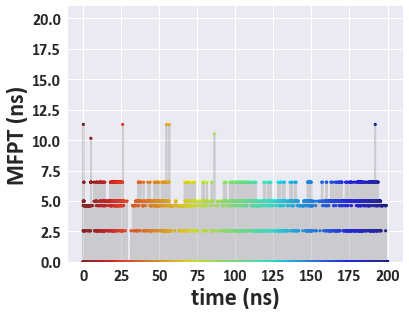

In [26]:
mfpt=[15.87 ,12.04 ,11.43 ,19.17 ,9.44 ,10.15 ,13.39 ,11.29 ,2.55 ,6.54 ,4.62 ,10.54 ,8.69 ,4.98 ,0.00]
filename='/home/disk2/wdd/PDZ/complex/charmm36/crystal_macro_trajs.dat'
xtcname='/home/disk2/wdd/PDZ/complex/charmm36/chainB_fit.xtc'
wf=open(filename,'w')
fitchain_xyz=dataset(xtcname,topology='/home/disk2/wdd/PDZ/charm36m/crystal.pdb',stride=1)
fitchain_diheds = featurizer.fit_transform(fitchain_xyz)
fitchain_scaled_diheds = scaler.fit_transform(fitchain_diheds)
fitchain_tica_trajs = tica_model.transform(fitchain_scaled_diheds)
fitchain_clustered_trajs = clusterer.transform(fitchain_tica_trajs)
fitchain_macro_trajs = pcca.transform(fitchain_clustered_trajs)

for i in fitchain_macro_trajs[0]:
    wf.write(str(i)+'\n')
wf.close()
time_step=0.01       #ns
import pandas as pd
import seaborn as sns
sns.set(color_codes=True)
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
font_path = '/home/disk2/wdd/msm/calibribold.ttf'
font_prop = font_manager.FontProperties(fname=font_path, size=24)
leg_prop = font_manager.FontProperties(fname=font_path, size=17)
cmap = plt.cm.get_cmap("jet_r")

fig, ax = plt.subplots(figsize=(6,4.7))
data = np.loadtxt(filename)
data_sort=[]
for m in data:
    data_sort.append(mfpt[int(m)])
filename2='/home/disk2/wdd/PDZ/complex/charmm36/crystal_macro_trajs_mfpt15states.dat'
wf2=open(filename2,'w')
for mm in data_sort:
    wf2.write(str(mm)+'\n')
wf2.close()
time = np.arange(len(data))*time_step
ax.scatter(time,data_sort, c=np.arange(len(data)),cmap=cmap,lw = 0,s=10)
ax.plot(time,data_sort,'gray',alpha=0.3)
ax.set_ylabel('MFPT (ns)',fontproperties=font_prop)
ax.set_xlabel('time (ns)',fontproperties=font_prop)
plt.ylim(0,21)
#ax.set_yticks(np.linspace(0,25,26))
#ax.set_yticklabels(map_mfpt)
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontproperties(font_prop)
    label.set_fontsize(16)
fig2name="/home/disk2/wdd/PDZ/complex/charmm36/crystal_macro_trajs_mfpt15states.png"
plt.savefig(fig2name,dpi=600,bbox_inches='tight')
plt.show()

In [28]:
np.sum(data==14)/(len(data)+0.0)

0.77321133943302833